# Models

# Sobel Edge Model

## Setup

In [1]:
import warnings
import tensorflow as tf
import os
import matplotlib.pyplot as plt
import numpy as np
import cv2
from PIL import Image
import math
import pandas as pd
from scipy.signal import find_peaks
from sklearn.metrics import mean_squared_error

2023-02-24 20:31:21.993418: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
# Disable warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

## Prepare DataSet

### Data

In [3]:
#data directory here!
data_dir = "dataset/ringsranking" 

In [4]:
#store the images name and index here!
images_df = pd.DataFrame(columns = ['image_index', 'image_name'])

images = [] #store the images here!
nr_of_images = 0 #just to count the number of images
for image_name in os.listdir(data_dir):
    image = plt.imread(os.path.join(data_dir, image_name))
    images.append(image)    
    images_df = images_df.append({'image_index' : nr_of_images, 'image_name' : image_name}, ignore_index = True)
    nr_of_images += 1

In [5]:
images_df

,image_index,image_name
0,0,2-34e23370868237a073d086fb64851017e9b2c8c9_859...
1,1,1-5d205d5ea6bafd3c2e038cf1139cdd5a9825388f_275...
2,2,1-11c00bf7cc3e03dc86bde8a20c8ab390b0b2f2a4_d5d...
3,3,2-8c5de8aa63e57b1e5d3a11ce4c4e2ded042b2ef3_069...
4,4,1-3d78e56849a16c0b17831129f6059e367574a138_856...
5,5,1-947a57fc1b94be1fb8a5cce439cd8112016648b1_b15...
6,6,1-1f43f59e9f5ead12a13b1cd892a8757242367189_9cd...
7,7,1-85fde97a518625ed46589a6be46300e36c3ad0d9_662...
8,8,1-e50b5a99fd9bab50130099c750df6d80f50a9b4e_fda...
9,9,1-0d8eabdfed2cb1f0d455e5a2050d78ba39ae6cff_066...


### Greysacle Copies of Data

In [6]:
if os.path.exists('dataset/grayscale_images') == False:
    os.makedirs('dataset/grayscale_images')
grayscale_images_dir = 'dataset/grayscale_images'

In [7]:
grayscale_images = [] #store the images here!
for image_name in os.listdir(data_dir):
    image = plt.imread(os.path.join(data_dir, image_name))
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray_image = Image.fromarray(gray_image)
    gray_image.save(os.path.join(grayscale_images_dir, image_name))
    gray_image = np.array(gray_image) #convert back to array
    grayscale_images.append(gray_image)

### Sobel Edge detection of Data

In [8]:
if os.path.exists('dataset/sobel_edge_images') == False:
    os.makedirs('dataset/sobel_edge_images')
sobel_edge_images_dir = 'dataset/sobel_edge_images'

In [9]:
sobel_edge_images = [] #store the images here!
for image_name in os.listdir(grayscale_images_dir):
    gray_image = plt.imread(os.path.join(grayscale_images_dir, image_name))
    
    # Sobel Edge Detection
    #sobelx = cv2.Sobel(src=image, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) # Sobel Edge Detection on the X axis
    #sobely = cv2.Sobel(src=image, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5) # Sobel Edge Detection on the Y axis
    #sobelxy = cv2.Sobel(src=image, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection

    # Blur the image for better edge detection
    #img_blur = cv2.GaussianBlur(image, (3,3), 0) 

    # Sobel Edge Detection
    #sobelx = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) # Sobel Edge Detection on the X axis
    #sobely = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5) # Sobel Edge Detection on the Y axis
    #sobelxy = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection
    
    # Sobel Edge Detection
    #sobelx = cv2.Sobel(src=gray_image, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) # Sobel Edge Detection on the X axis
    #sobely = cv2.Sobel(src=gray_image, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5) # Sobel Edge Detection on the Y axis
    #sobelxy = cv2.Sobel(src=gray_image, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection

    # Blur the image for better edge detection
    #img_blur = cv2.GaussianBlur(gray_image, (3,3), 0) 
 
    # Sobel Edge Detection
    #sobelx = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) # Sobel Edge Detection on the X axis
    #sobely = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5) # Sobel Edge Detection on the Y axis
    #sobelxy = cv2.Sobel(src=img_blur, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection

    sobel_edge_image = cv2.Sobel(src=gray_image, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5) # Combined X and Y Sobel Edge Detection
    
    sobel_edge_image = Image.fromarray(sobel_edge_image)
    #sobel_edge_image.save(os.path.join(sobel_edge_images_dir, image_name))
    sobel_edge_image = np.array(sobel_edge_image) #convert back to array
    sobel_edge_images.append(sobel_edge_image)

### Ranking Data

In [10]:
url = "dataset/ringsranking.xlsx"
ringsranking = pd.read_excel(url)

In [11]:
ringsranking = ringsranking.fillna('0 st')

In [12]:
ringsranking_df = pd.DataFrame(ringsranking)

In [13]:
ringsranking_df.rename(columns={'Bildlänk': 'image_name', 'Räkning 1': 'ranking_1', 'Räkning 2': 'ranking_2', 'Räkning 3': 'ranking_3'}, inplace=True)

In [14]:
ringsranking_df['ranking_1'] = ringsranking_df['ranking_1'].str.replace(r'\D', '').astype(float)
ringsranking_df['ranking_2'] = ringsranking_df['ranking_2'].str.replace(r'\D', '').astype(float)
ringsranking_df['ranking_3'] = ringsranking_df['ranking_3'].str.replace(r'\D', '').astype(float)

In [15]:
ringsranking_df.replace(0, np.nan, inplace=True)

In [16]:
mean_ringsranking_df = ringsranking_df.T.fillna(ringsranking_df.mean(axis=1)).T

In [17]:
mean_ringsranking_df['ranking_1'] = mean_ringsranking_df['ranking_1'].astype(int)
mean_ringsranking_df['ranking_2'] = mean_ringsranking_df['ranking_2'].astype(int)
mean_ringsranking_df['ranking_3'] = mean_ringsranking_df['ranking_3'].astype(int)

In [18]:
mean_ringsranking_df

,image_name,ranking_1,ranking_2,ranking_3
0,1-0d8eabdfed2cb1f0d455e5a2050d78ba39ae6cff_066...,11,11,11
1,1-1f43f59e9f5ead12a13b1cd892a8757242367189_9cd...,14,14,14
2,1-3d78e56849a16c0b17831129f6059e367574a138_856...,15,15,15
3,1-5d205d5ea6bafd3c2e038cf1139cdd5a9825388f_275...,59,59,61
4,1-11c00bf7cc3e03dc86bde8a20c8ab390b0b2f2a4_d5d...,18,18,18
5,1-85fde97a518625ed46589a6be46300e36c3ad0d9_662...,16,16,16
6,1-947a57fc1b94be1fb8a5cce439cd8112016648b1_b15...,19,19,19
7,1-e50b5a99fd9bab50130099c750df6d80f50a9b4e_fda...,17,17,17
8,2-8c5de8aa63e57b1e5d3a11ce4c4e2ded042b2ef3_069...,22,22,22
9,2-34e23370868237a073d086fb64851017e9b2c8c9_859...,81,88,92


### Ranking with images Data

In [19]:
ringsranking_images_df = pd.merge(left=mean_ringsranking_df, right=images_df, left_on='image_name', right_on='image_name')

In [20]:
ringsranking_images_df

,image_name,ranking_1,ranking_2,ranking_3,image_index
0,1-0d8eabdfed2cb1f0d455e5a2050d78ba39ae6cff_066...,11,11,11,9
1,1-1f43f59e9f5ead12a13b1cd892a8757242367189_9cd...,14,14,14,6
2,1-3d78e56849a16c0b17831129f6059e367574a138_856...,15,15,15,4
3,1-5d205d5ea6bafd3c2e038cf1139cdd5a9825388f_275...,59,59,61,1
4,1-11c00bf7cc3e03dc86bde8a20c8ab390b0b2f2a4_d5d...,18,18,18,2
5,1-85fde97a518625ed46589a6be46300e36c3ad0d9_662...,16,16,16,7
6,1-947a57fc1b94be1fb8a5cce439cd8112016648b1_b15...,19,19,19,5
7,1-e50b5a99fd9bab50130099c750df6d80f50a9b4e_fda...,17,17,17,8
8,2-8c5de8aa63e57b1e5d3a11ce4c4e2ded042b2ef3_069...,22,22,22,3
9,2-34e23370868237a073d086fb64851017e9b2c8c9_859...,81,88,92,0


## Pith Detection

In [21]:
def pith_prediction(req_img):
    model = tf.keras.models.load_model('PithDetector')
    image = images[req_img]
    height, width = image.shape[0], image.shape[1]
    image = cv2.resize(image, (224,224))
    image = np.expand_dims(image, axis=0)
    prediction = model.predict(image)[0]
    image = np.squeeze(image, axis = 0)
    image = cv2.resize(image, (width, height)) 
    
    return prediction

In [22]:
prediction_df = pd.DataFrame(columns = ['image_index', 'prediction'])
nr_of_images = 0
for i in range(len(images)):
    prediction = pith_prediction(i)
    prediction_df = prediction_df.append({'image_index' : nr_of_images, 'prediction' : prediction}, ignore_index = True)
    nr_of_images += 1

2023-02-24 20:31:31.672399: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


In [23]:
prediction_df

,image_index,prediction
0,0,"[0.4967788, 0.5763947]"
1,1,"[0.46179685, 0.55871946]"
2,2,"[0.541148, 0.5151813]"
3,3,"[0.49758518, 0.6144115]"
4,4,"[0.43453968, 0.52548176]"
5,5,"[0.5506282, 0.5529926]"
6,6,"[0.4949616, 0.44544232]"
7,7,"[0.49308434, 0.52523816]"
8,8,"[0.55558866, 0.49926007]"
9,9,"[0.4719634, 0.5730748]"


### Ranking with images Data and Pith Prediction

In [24]:
ringsranking_images_prediction_df = pd.merge(left=ringsranking_images_df, right=prediction_df, left_on='image_index', right_on='image_index')

In [25]:
ringsranking_images_prediction_df

,image_name,ranking_1,ranking_2,ranking_3,image_index,prediction
0,1-0d8eabdfed2cb1f0d455e5a2050d78ba39ae6cff_066...,11,11,11,9,"[0.4719634, 0.5730748]"
1,1-1f43f59e9f5ead12a13b1cd892a8757242367189_9cd...,14,14,14,6,"[0.4949616, 0.44544232]"
2,1-3d78e56849a16c0b17831129f6059e367574a138_856...,15,15,15,4,"[0.43453968, 0.52548176]"
3,1-5d205d5ea6bafd3c2e038cf1139cdd5a9825388f_275...,59,59,61,1,"[0.46179685, 0.55871946]"
4,1-11c00bf7cc3e03dc86bde8a20c8ab390b0b2f2a4_d5d...,18,18,18,2,"[0.541148, 0.5151813]"
5,1-85fde97a518625ed46589a6be46300e36c3ad0d9_662...,16,16,16,7,"[0.49308434, 0.52523816]"
6,1-947a57fc1b94be1fb8a5cce439cd8112016648b1_b15...,19,19,19,5,"[0.5506282, 0.5529926]"
7,1-e50b5a99fd9bab50130099c750df6d80f50a9b4e_fda...,17,17,17,8,"[0.55558866, 0.49926007]"
8,2-8c5de8aa63e57b1e5d3a11ce4c4e2ded042b2ef3_069...,22,22,22,3,"[0.49758518, 0.6144115]"
9,2-34e23370868237a073d086fb64851017e9b2c8c9_859...,81,88,92,0,"[0.4967788, 0.5763947]"


## Peaks and Valley

In [26]:
def num_of_subseq(arr, n):
    i, inc_count, dec_count = 0, 0, 0
    max = [0]*n
    min = [0]*n
 
    # k2, k1 are used to store the count of max and min array
    k1 = 0
    k2 = 0
 
    # Comparison to store the index of first element of array
    if (arr[0] < arr[1]):
        min[k1] = 0
        k1 += 1
    else:
        max[k2] = 0
        k2 += 1
 
    # Comparison to store the index from second to second last index of array
    for i in range(1, n-1):
        if (arr[i] < arr[i - 1] and arr[i] < arr[i + 1]):
            min[k1] = i
            k1 += 1
 
        if (arr[i] > arr[i - 1] and arr[i] > arr[i + 1]):
            max[k2] = i
            k2 += 1
 
    # Comparison to store the index of last element of array
    if (arr[n - 1] < arr[n - 2]):
        min[k1] = n - 1
        k1 += 1
    else:
        max[k2] = n - 1
        k2 += 1
 
    # Count of number of maximal contiguous increasing and decreasing subsequences
    if (min[0] == 0):
        inc_count = k2
        dec_count = k1 - 1
    else:
        inc_count = k2 - 1
        dec_count = k1
    
    return inc_count, dec_count

In [27]:
def algoupdated(c):
    window = 5
    thres = 8.0

    # Iterate and collect state changes with regard to previous state
    changes = []
    rolling = [None] * window
    rolling[4] = 0
    old_state = None
    good_count = 0
    bad_count = 0
    for i in range(window, len(c) - 1):
        slc = c[i - window:i + 1]
        mean = sum(slc) / float(len(slc))
        state = 'good' if mean > (rolling[i-1] + thres) else 'bad'

        rolling.append(mean)
        
        if not old_state or old_state != state:
            #print('Changed to {:>4s} at position {:>3d} ({:5.3f})'.format(state, i, mean))
            if state == 'good':
                good_count += 1
            else:
                bad_count += 1
            changes.append((i, state))
            old_state = state

    """
    # Plot results and state changes
    plt.figure(frameon=False, figsize=(10, 8))
    currents, = plt.plot(c, ls='--', label='Current')
    rollwndw, = plt.plot(rolling, lw=2, label='Rolling Mean')
    plt.axhline(thres, xmin=.0, xmax=1.0, c='grey', ls='-')
    plt.text(40, thres, 'Threshold: {:.1f}'.format(thres), horizontalalignment='right')
    for c, s in changes:
        plt.axvline(c, ymin=.0, ymax=.7, c='red', ls='-')
        plt.text(c, 41.5, s, color='red', rotation=90, verticalalignment='bottom')
    plt.legend(handles=[currents, rollwndw], fontsize=11)
    plt.grid(True)
    plt.show()
    """
    
    return good_count, bad_count

In [28]:
def algotoupdate(c):
    window = 5
    thres = 200.0

    # Iterate and collect state changes with regard to previous state
    changes = []
    rolling = [None] * window
    old_state = None
    good_count = 0
    bad_count = 0
    for i in range(window, len(c) - 1):
        slc = c[i - window:i + 1]
        mean = sum(slc) / float(len(slc))
        state = 'good' if mean > thres else 'bad'

        rolling.append(mean)
        if not old_state or old_state != state:
            #print('Changed to {:>4s} at position {:>3d} ({:5.3f})'.format(state, i, mean))
            if state == 'good':
                good_count += 1
            else:
                bad_count += 1
            changes.append((i, state))
            old_state = state

    
    # Plot results and state changes
    plt.figure(frameon=False, figsize=(10, 8))
    currents, = plt.plot(c, ls='--', label='Current')
    rollwndw, = plt.plot(rolling, lw=2, label='Rolling Mean')
    plt.axhline(thres, xmin=.0, xmax=1.0, c='grey', ls='-')
    plt.text(40, thres, 'Threshold: {:.1f}'.format(thres), horizontalalignment='right')
    for c, s in changes:
        plt.axvline(c, ymin=.0, ymax=.7, c='red', ls='-')
        plt.text(c, 41.5, s, color='red', rotation=90, verticalalignment='bottom')
    plt.legend(handles=[currents, rollwndw], fontsize=11)
    plt.grid(True)
    plt.show()
    
    print("algo5 good_count %s, bad_count %s" % (good_count, bad_count))
    #plt.savefig('local/plot.png', dpi=72, bbox_inches='tight')

## Change along radial line

In [29]:
def funct_change_along_radial_line(image, gray_image, sobel_edge_image, req_lines, req_points, prediction):
    
    """
    #Show source image
    plt.imshow(image)
    plt.show()
    """
    
    """
    #Show grayscale image
    plt.imshow(gray_image, cmap = 'gray')
    plt.show()
    """
    
    """
    #Show grayscale image
    plt.imshow(sobel_edge_image, cmap = 'gray')
    plt.show()
    """
        
    #model = tf.keras.models.load_model('PithDetector')
    
    #image = images[req_img]
    height, width = image.shape[0], image.shape[1]
    #image = cv2.resize(image, (224,224))
    #image = np.expand_dims(image, axis=0)
    #prediction = model.predict(image)[0]
    #image = np.squeeze(image, axis = 0)
    #image = cv2.resize(image, (width, height)) 
    
    """
    #Show prediction
    plt.imshow(image)
    plt.plot(prediction[0]*width, prediction[1]*height, '.')
    plt.show()
    """
        
    #gray_image = grayscale_images[req_img]
    ret, thresh = cv2.threshold(gray_image, 1, 255, 1)
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
    """
    #Show contours
    contoursImage = cv2.drawContours(sobel_edge_image, contours, -1, 255, 3)
    plt.imshow(contoursImage)
    plt.show()
    """
    
    #contours_array
    contours_array = []
    for i in range(len(contours)):
        for j in range(len(contours[i])):
            contours_array.append(contours[i][j][0])
    
    point_indexes = np.random.randint(0, len(contours_array)-1, size = req_lines)
    
    lines = []
    pixel_valuess = []
    radial_lines_info = []
    
    for index in point_indexes:
        point_on_contour = contours_array[index]
        
        line_len = math.dist(np.array([prediction[0]*width, prediction[1]*height]), point_on_contour)
        req_points = int(line_len) #change to max points along line
        line = np.linspace(np.array([prediction[0]*width, prediction[1]*height]), point_on_contour, req_points)
        
        #we convert to integer numbers
        for i in range(len(line)):
            for j in range(2):
                line[i,j] = int(line[i,j])

        line = line.astype('int') #we do this for proper indexing

        pixel_values = []
        i = 0
        while i < len(line):
            value = sobel_edge_image[line[i][1], line[i][0]] 
            pixel_values.append(value)
            i += 1
        
        inc_count, dec_count = num_of_subseq(pixel_values,len(pixel_values))
        
        #peaks = find_peaks(pixel_values, threshold = 15)
        peaks = find_peaks(pixel_values, height = 15)
        #peaks = find_peaks(pixel_values, height = 15, threshold = 15)
        
        """
        #Show contour point
        plt.imshow(sobel_edge_image)
        plt.plot(point_on_contour[0], point_on_contour[1], '.', color = 'r', markersize = 10)
        plt.show()
        """
        
        #Show radial lines
        plt.imshow(sobel_edge_image, cmap = 'gray')
        plt.plot(prediction[0]*width, prediction[1]*height, '.', markersize = 10)
        plt.plot(point_on_contour[0], point_on_contour[1], '.', color = 'r', markersize = 10)
        plt.plot(np.array([point_on_contour[0], prediction[0]*width]), np.array([point_on_contour[1], prediction[1]*height]))
        plt.show()

        """
        #Show line
        plt.imshow(sobel_edge_image)
        plt.plot(line[:,0], line[:,1], '.')
        plt.show()
        """
        
        #Show grayscale changes
        plt.plot(np.linspace(0,req_points,req_points), pixel_values)
        plt.xlabel('point from estimated pith location to contour')
        plt.ylabel('pixel value')
        plt.show()
        
        """
        #Show peaks
        plt.plot(np.linspace(0,req_points,req_points),pixel_values)
        plt.scatter(peaks[0], np.array(pixel_values)[peaks[0]], color = 'r', label = 'Maxima')
        plt.legend()
        plt.grid()
        plt.show()
        """
        
        good_count, bad_count = algoupdated(pixel_values)
        
        print("line length: %s, point: %s" % (line_len, point_on_contour))
        print("inc count %s, dec count %s" % (inc_count, dec_count))
        print("peaks %s" % (len(peaks[0])))
        print("good_count %s, bad_count %s" % (good_count, bad_count))
        
        lines.append(line)
        pixel_valuess.append(pixel_values)
        radial_lines_info.append([line_len, point_on_contour, inc_count, dec_count, len(peaks[0]), good_count, bad_count])

    #Show contour points, radial lines
    plt.imshow(sobel_edge_image, cmap = 'gray')
    plt.plot(prediction[0]*width, prediction[1]*height, '.', markersize = 10)
    
    for index in point_indexes:
        point_on_contour = contours_array[index]
        plt.plot(point_on_contour[0], point_on_contour[1], '.', color = 'r', markersize = 10)
        plt.plot(np.array([point_on_contour[0], prediction[0]*width]), np.array([point_on_contour[1], prediction[1]*height]))
    plt.show()
        
    """
    #Show line
    plt.imshow(gray_image)
    for line in lines:
        plt.plot(line[:,0], line[:,1], '.')
    plt.show()
    """
    
    #Show plot
    for pixel_values in pixel_valuess:
        #plt.plot(np.linspace(0,req_points,req_points), pixel_values)
        plt.plot(np.linspace(0,len(pixel_values),len(pixel_values)), pixel_values)
    plt.xlabel('point from estimated pith location to contour')
    plt.ylabel('pixel value')
    plt.show()
    
    return radial_lines_info
    

## Rings counting for all Images

0 2-34e23370868237a073d086fb64851017e9b2c8c9_85903b8cb210e9ad54581e7a37999bcd5fb18443_instant.jpg


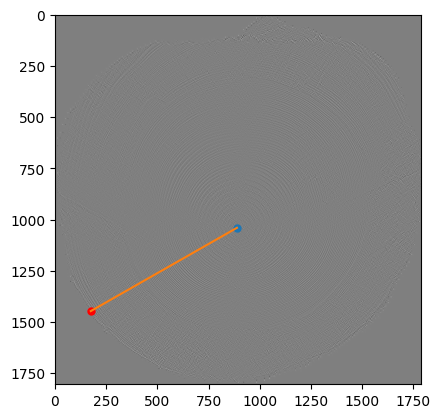

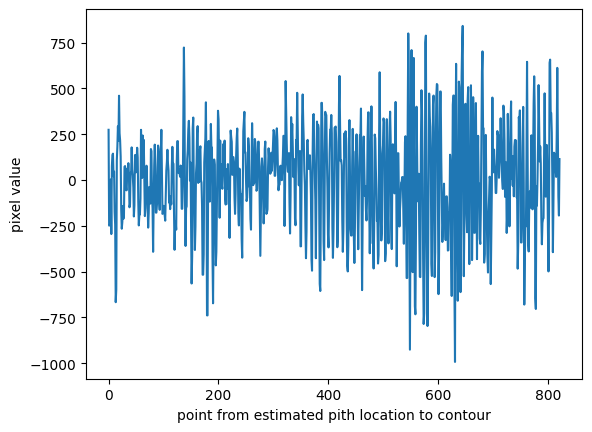

line length: 821.4320462009597, point: [ 175 1447]
inc count 149, dec count 147
peaks 146
good_count 123, bad_count 124


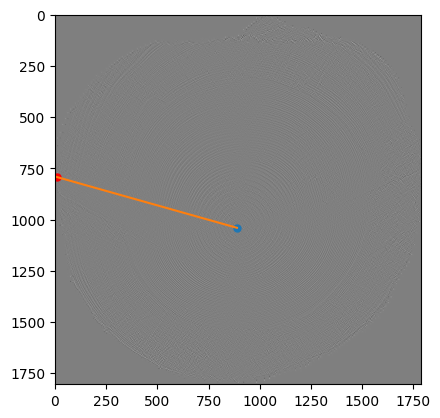

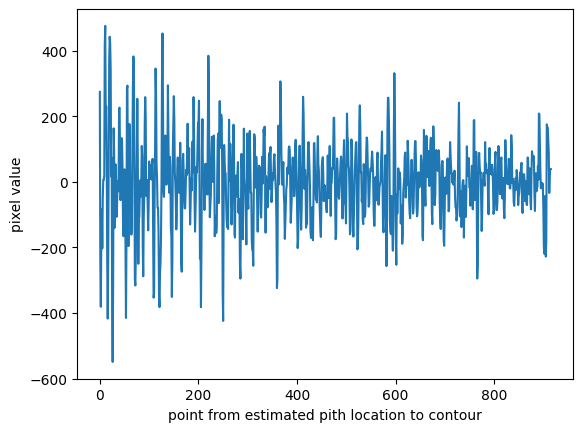

line length: 915.0939194433172, point: [  8 792]
inc count 175, dec count 181
peaks 157
good_count 124, bad_count 125


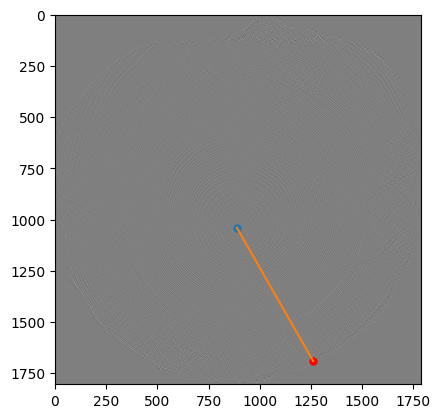

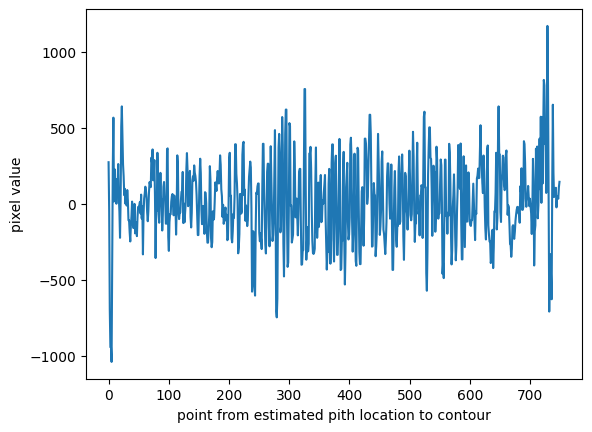

line length: 749.5797591951869, point: [1261 1691]
inc count 133, dec count 139
peaks 123
good_count 109, bad_count 110


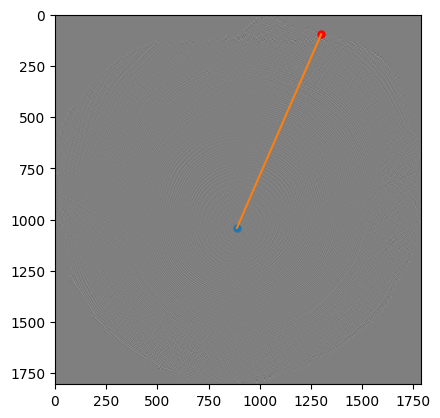

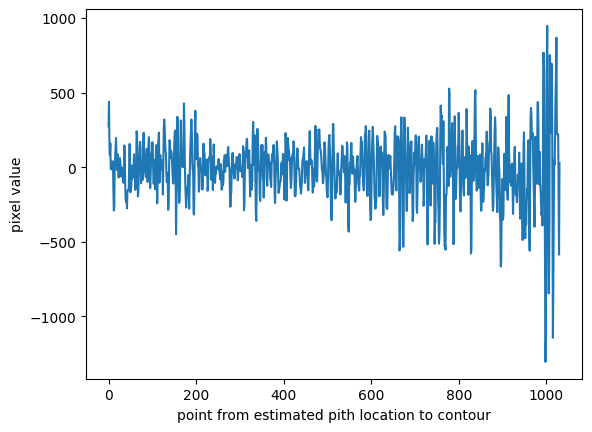

line length: 1030.9722722576605, point: [1300   95]
inc count 175, dec count 176
peaks 163
good_count 126, bad_count 126


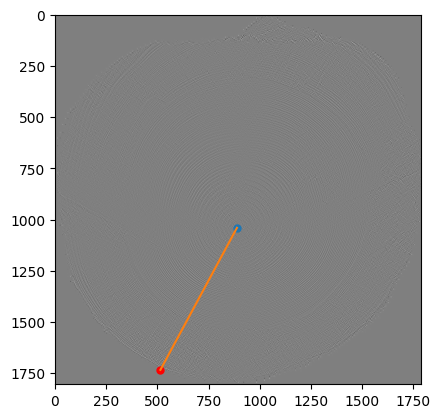

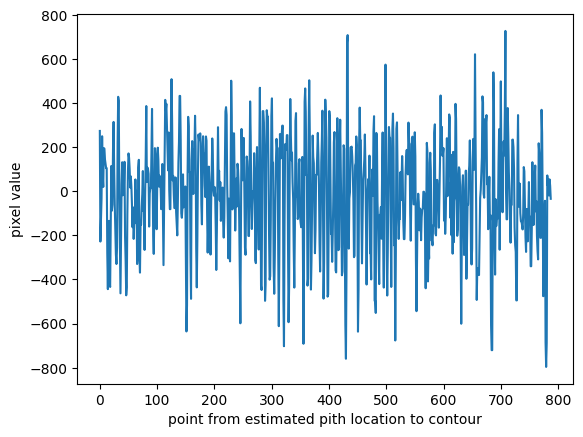

line length: 787.8902489508727, point: [ 515 1734]
inc count 154, dec count 153
peaks 141
good_count 121, bad_count 120


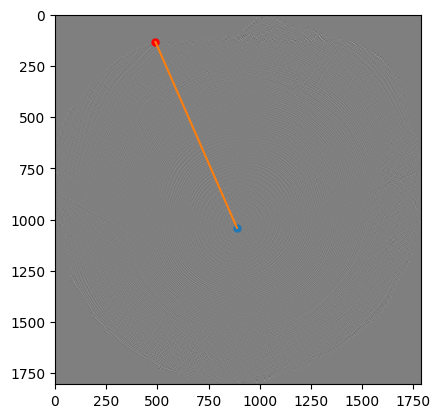

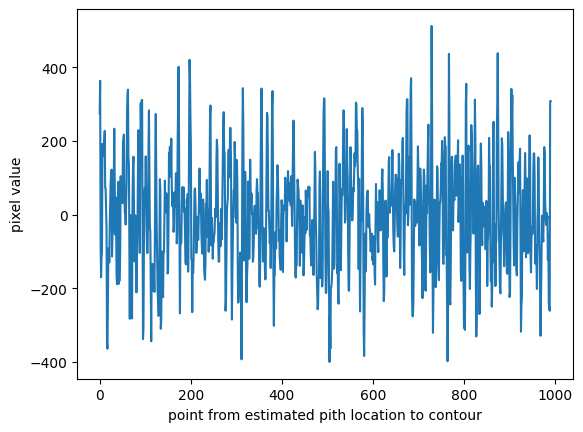

line length: 990.7350162339955, point: [491 133]
inc count 188, dec count 189
peaks 158
good_count 122, bad_count 121


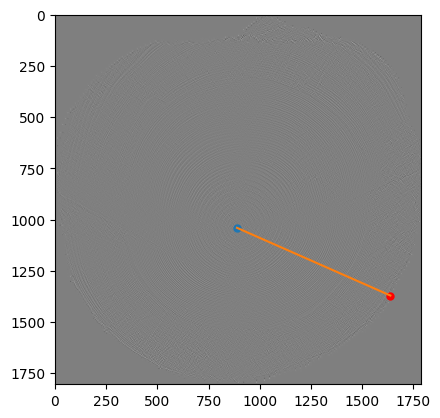

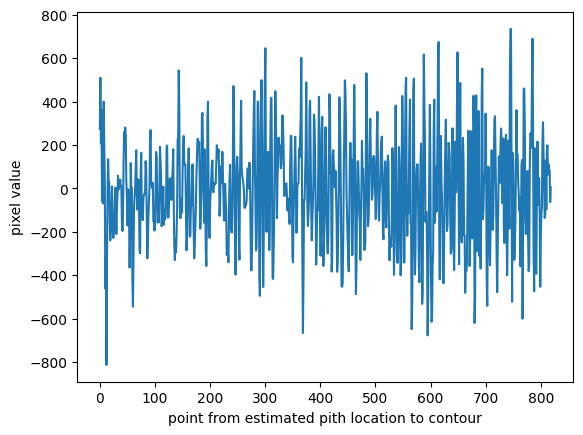

line length: 818.9603538015087, point: [1638 1371]
inc count 146, dec count 144
peaks 134
good_count 121, bad_count 121


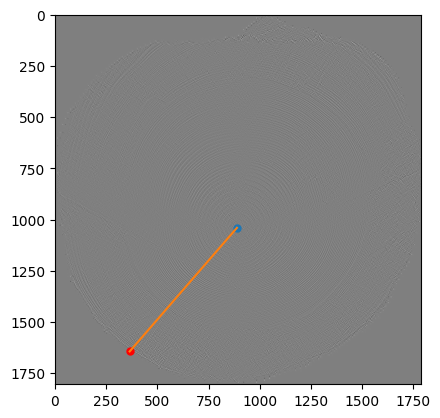

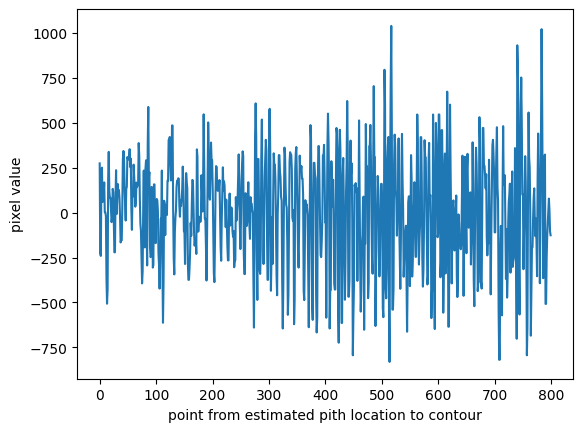

line length: 799.1513308166066, point: [ 365 1644]
inc count 138, dec count 136
peaks 142
good_count 129, bad_count 128


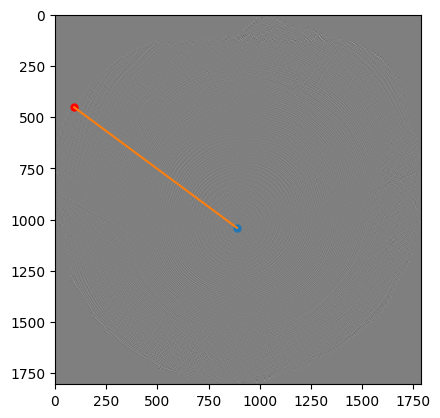

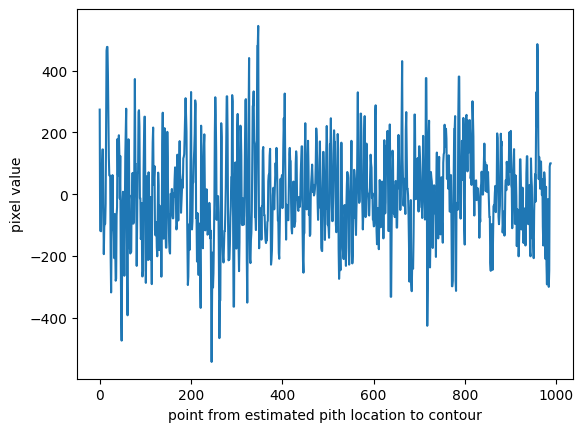

line length: 988.8442250488018, point: [ 94 452]
inc count 170, dec count 173
peaks 148
good_count 125, bad_count 125


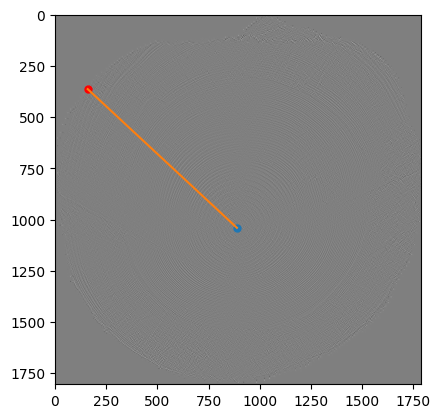

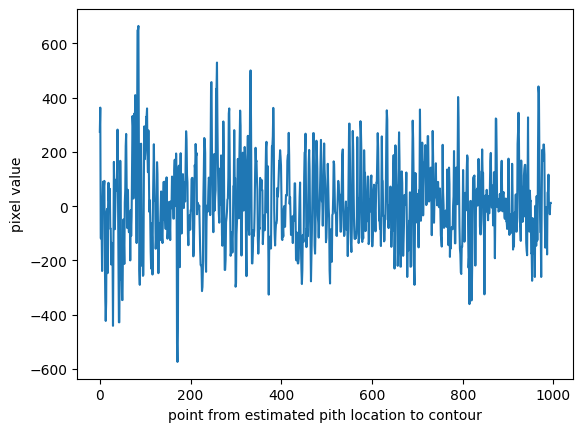

line length: 994.9464460152602, point: [160 363]
inc count 192, dec count 182
peaks 157
good_count 138, bad_count 138


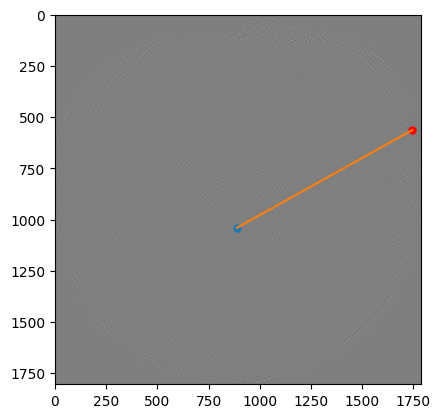

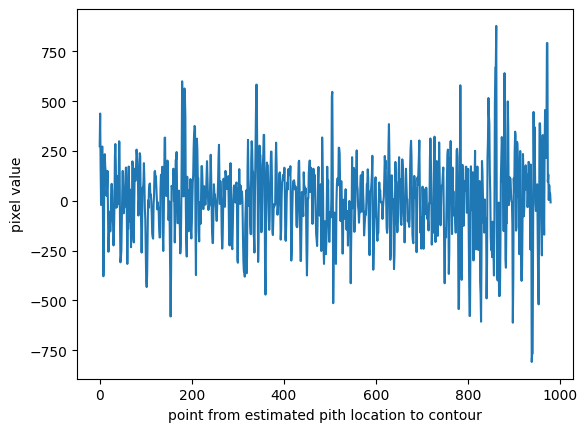

line length: 980.3516694761609, point: [1745  563]
inc count 183, dec count 182
peaks 167
good_count 126, bad_count 126


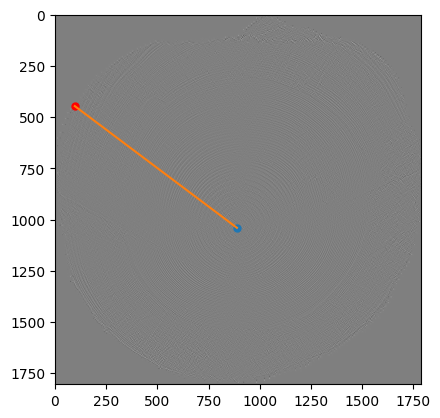

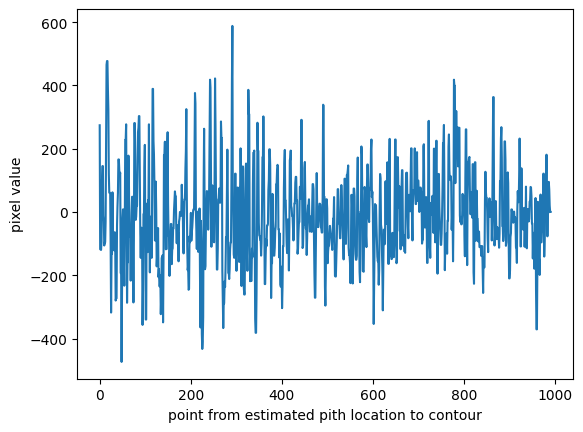

line length: 990.0253464577643, point: [ 97 446]
inc count 123, dec count 139
peaks 127
good_count 136, bad_count 136


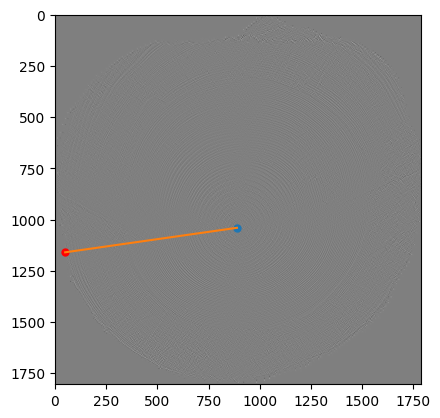

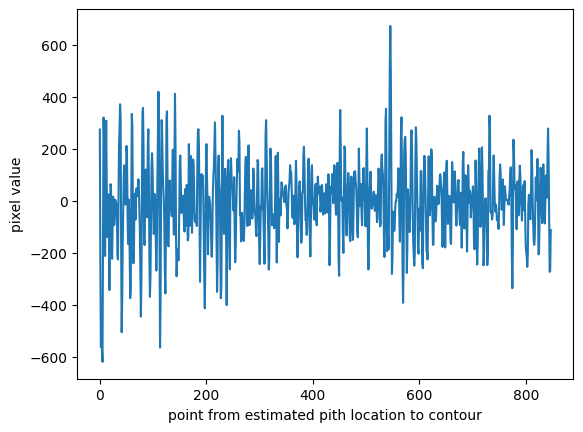

line length: 847.2226105418725, point: [  50 1160]
inc count 162, dec count 160
peaks 141
good_count 118, bad_count 119


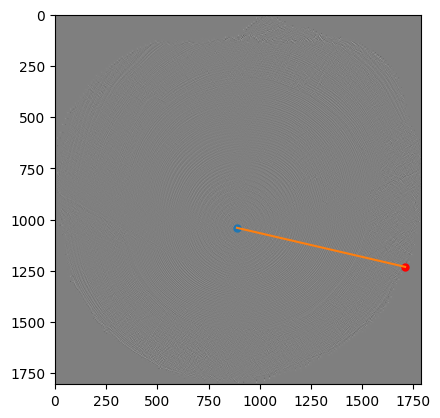

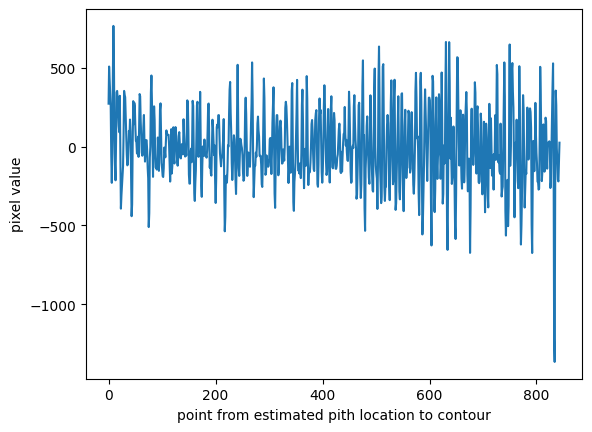

line length: 843.0917904684443, point: [1710 1231]
inc count 149, dec count 151
peaks 125
good_count 105, bad_count 105


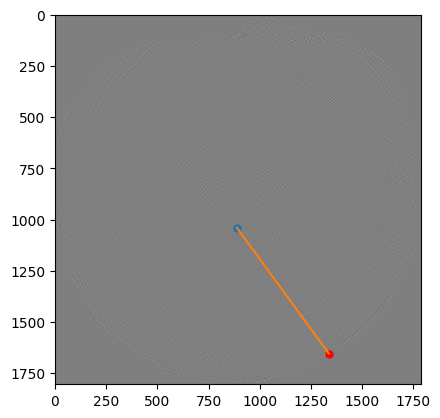

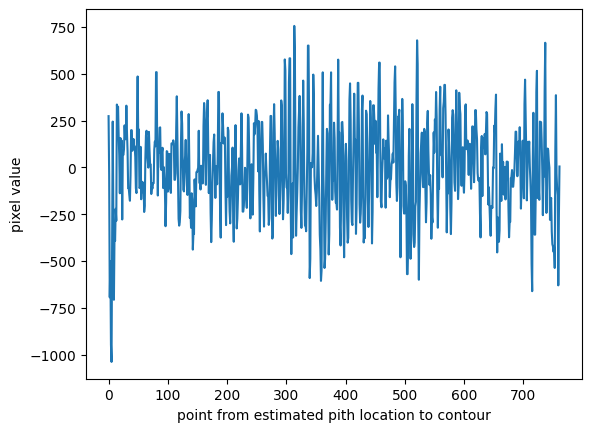

line length: 761.3012093600934, point: [1338 1655]
inc count 139, dec count 147
peaks 129
good_count 120, bad_count 121


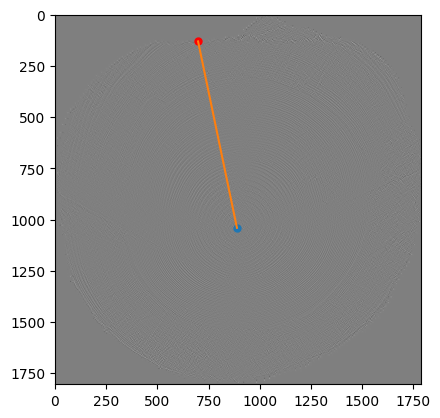

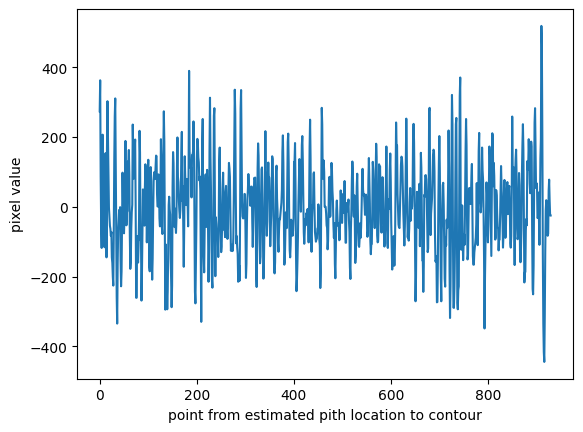

line length: 929.9540479927103, point: [699 130]
inc count 166, dec count 159
peaks 135
good_count 112, bad_count 112


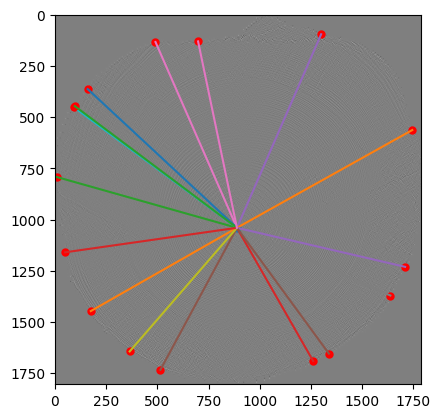

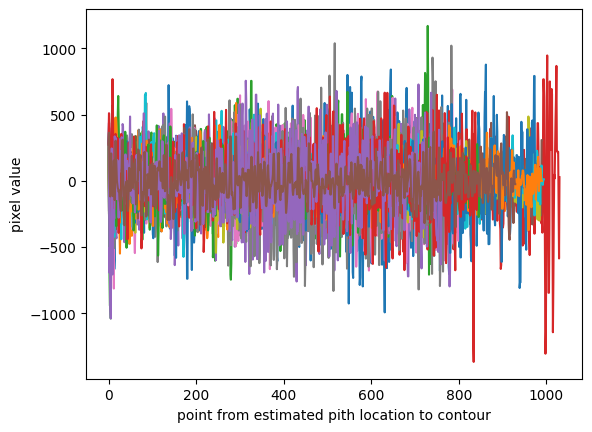

1 1-5d205d5ea6bafd3c2e038cf1139cdd5a9825388f_275cb29ffc473512447ce75ff34baa4ecea7276d_instant_210319.jpg


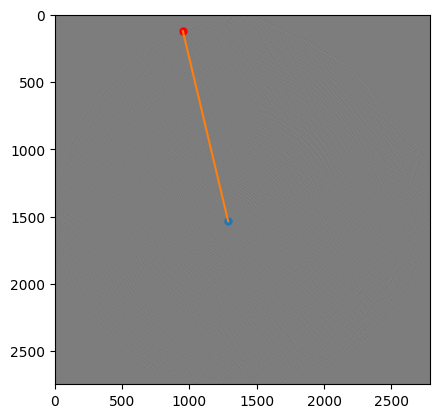

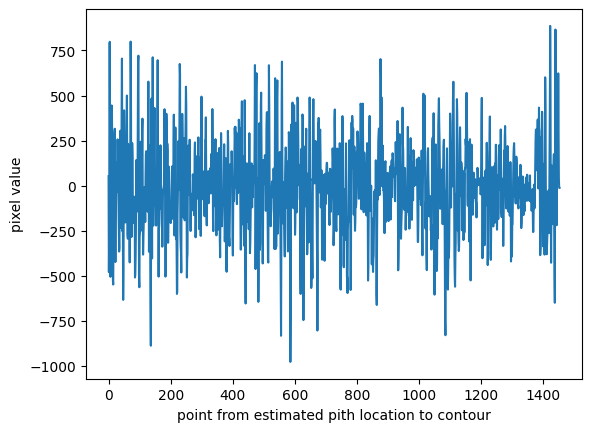

line length: 1452.3208089698364, point: [951 122]
inc count 284, dec count 288
peaks 239
good_count 199, bad_count 199


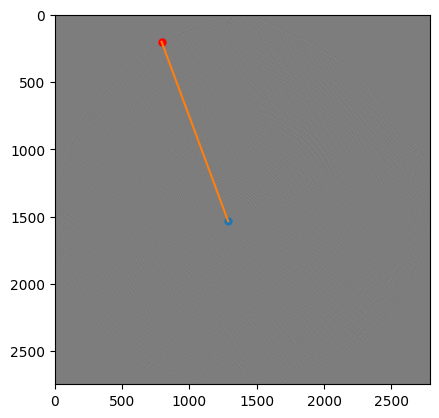

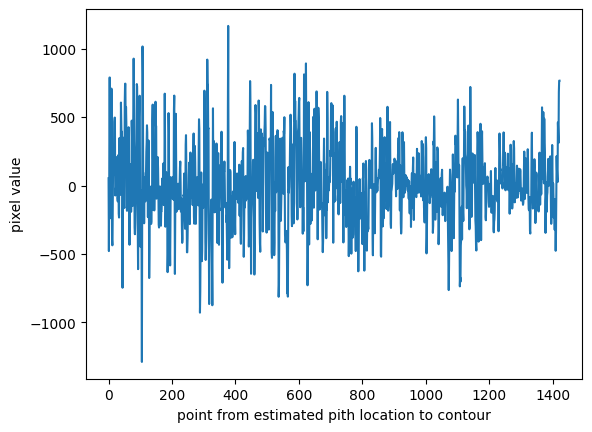

line length: 1422.514914040214, point: [793 201]
inc count 292, dec count 293
peaks 244
good_count 199, bad_count 198


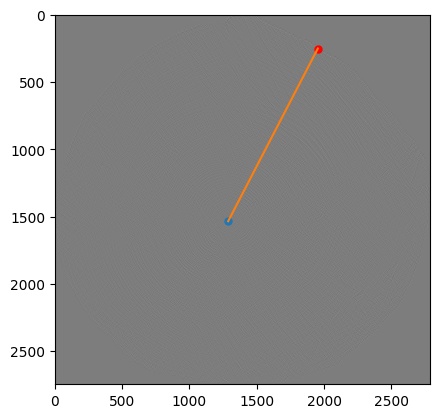

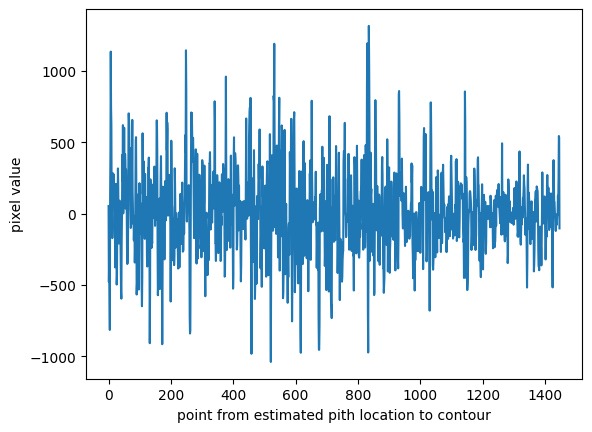

line length: 1446.5077095328706, point: [1954  251]
inc count 308, dec count 323
peaks 256
good_count 203, bad_count 203


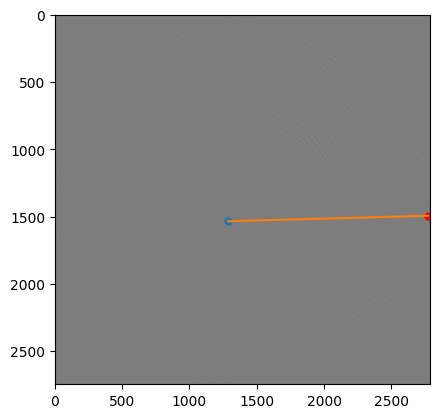

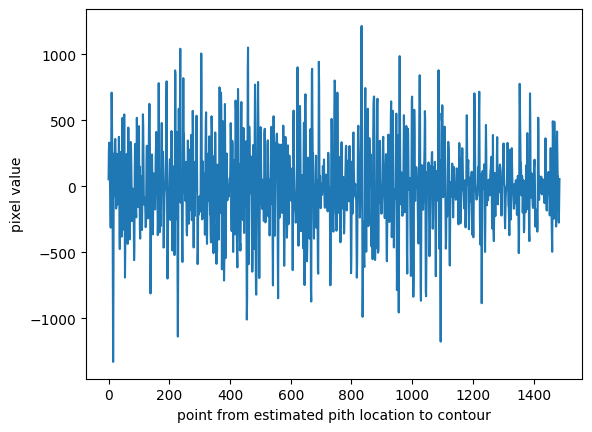

line length: 1485.0710106232614, point: [2772 1494]
inc count 264, dec count 262
peaks 222
good_count 194, bad_count 194


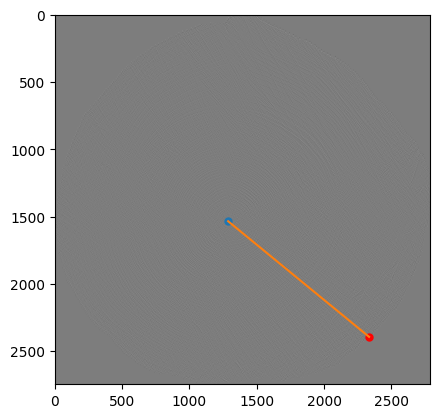

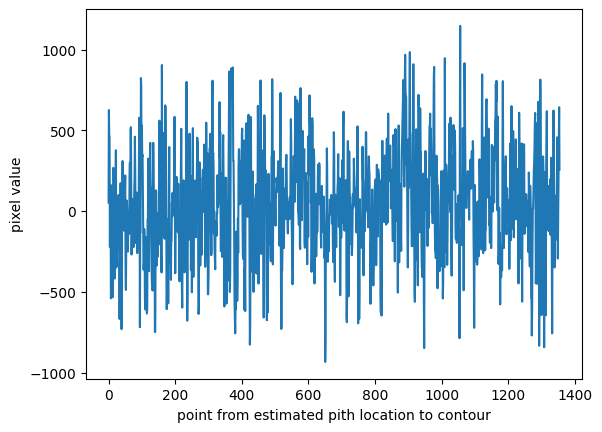

line length: 1354.8057459880213, point: [2335 2394]
inc count 289, dec count 290
peaks 269
good_count 216, bad_count 215


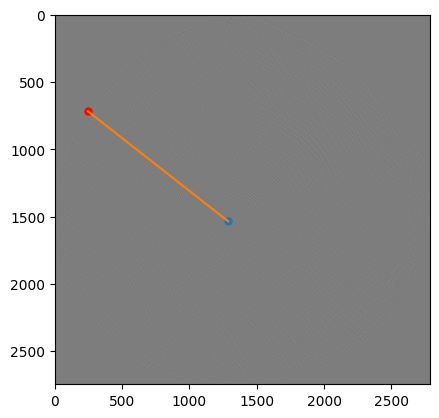

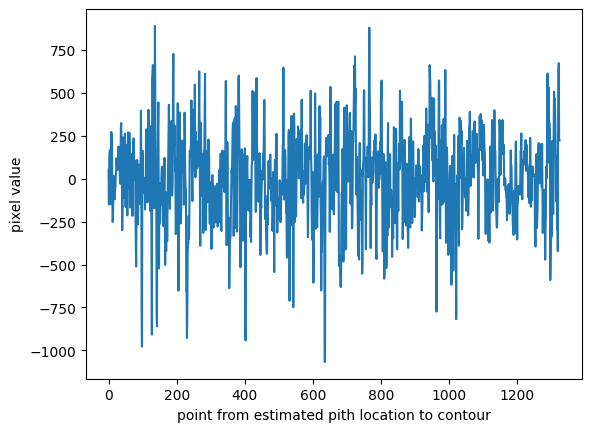

line length: 1324.9850113961702, point: [245 717]
inc count 280, dec count 280
peaks 235
good_count 202, bad_count 201


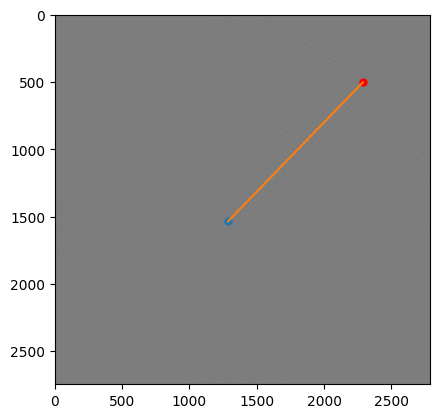

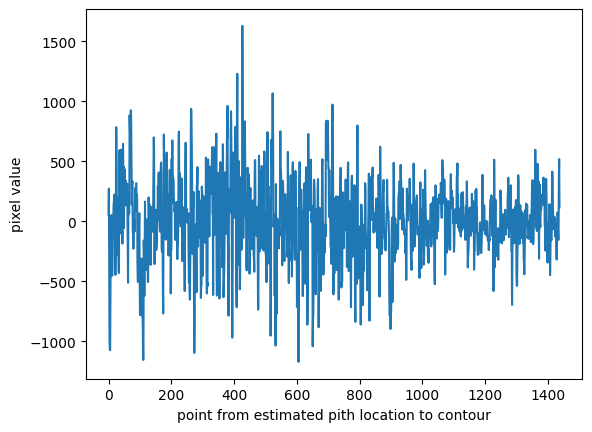

line length: 1437.2324469762038, point: [2288  503]
inc count 288, dec count 296
peaks 258
good_count 204, bad_count 204


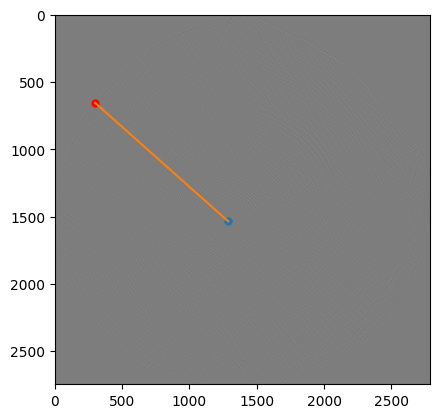

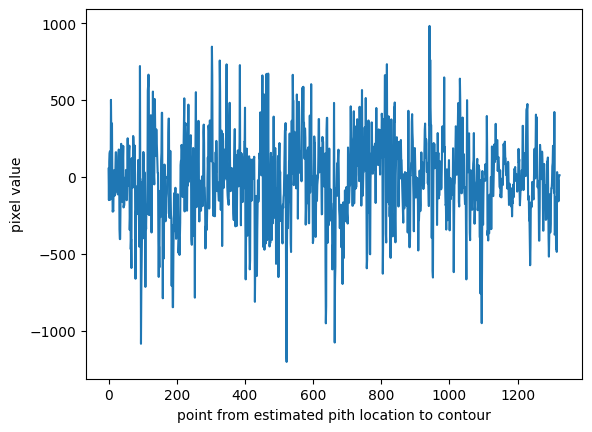

line length: 1323.3154924799321, point: [299 655]
inc count 288, dec count 281
peaks 224
good_count 193, bad_count 193


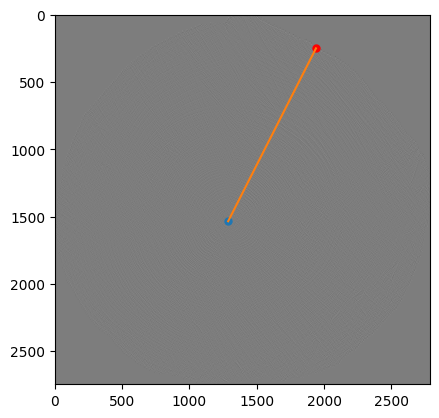

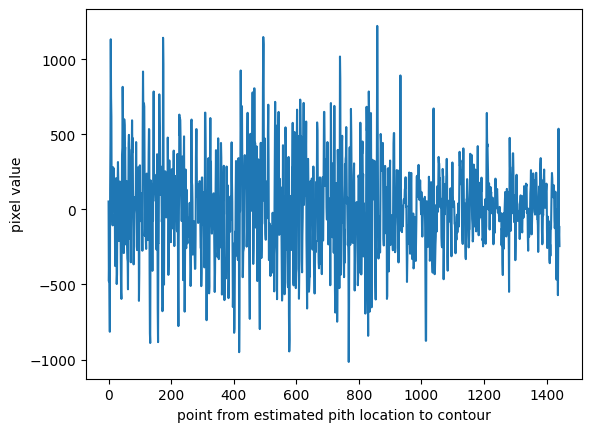

line length: 1441.0020359895823, point: [1940  250]
inc count 282, dec count 291
peaks 252
good_count 201, bad_count 202


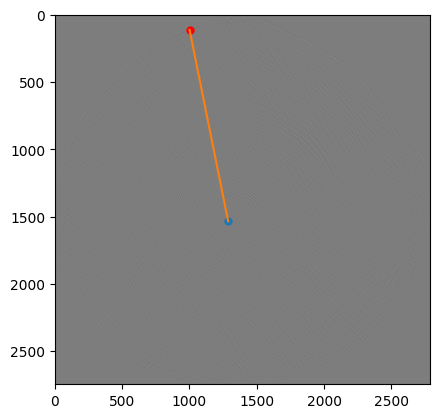

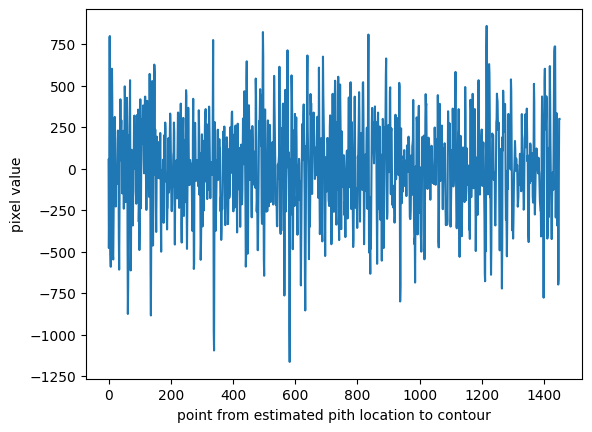

line length: 1450.3786445709013, point: [1001  113]
inc count 283, dec count 287
peaks 248
good_count 187, bad_count 186


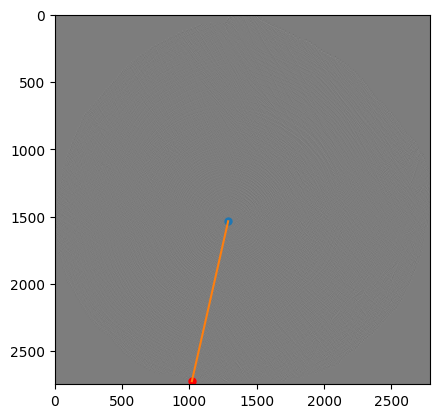

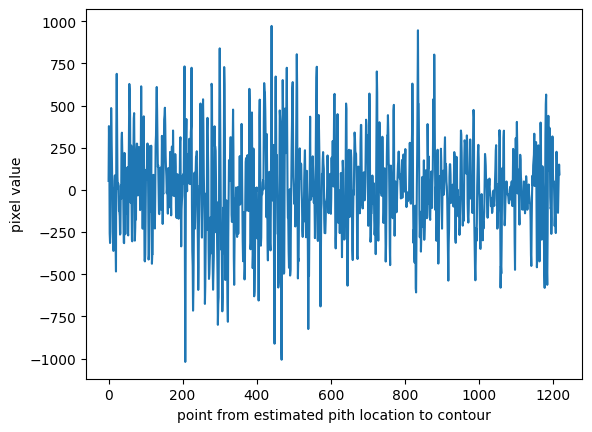

line length: 1218.3752782366407, point: [1018 2723]
inc count 227, dec count 233
peaks 186
good_count 149, bad_count 150


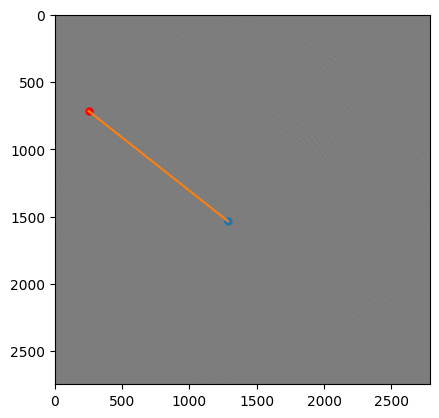

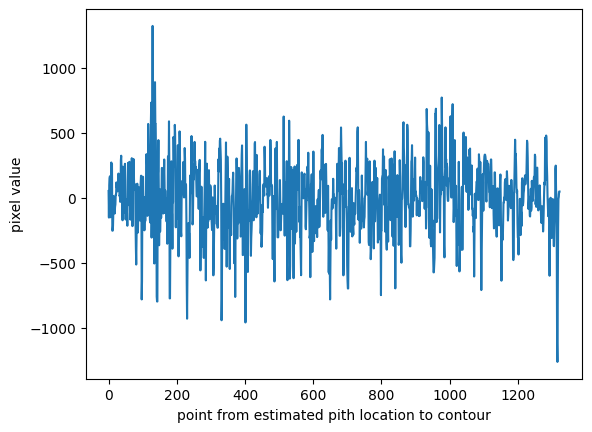

line length: 1322.2936866037496, point: [250 715]
inc count 272, dec count 264
peaks 221
good_count 198, bad_count 197


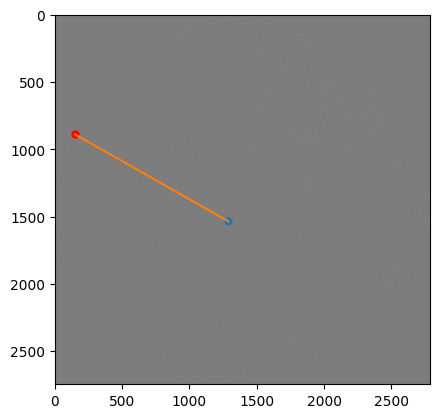

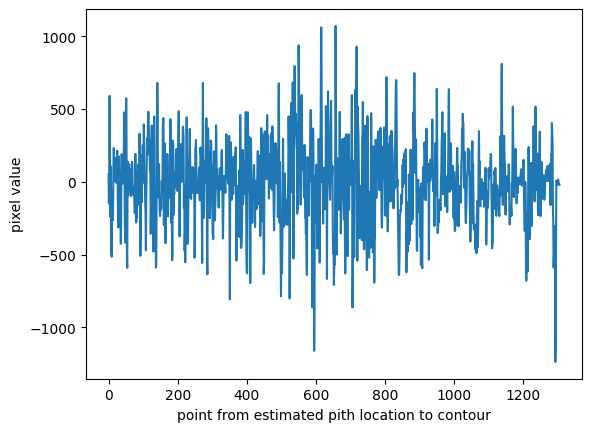

line length: 1306.6670259780462, point: [151 890]
inc count 281, dec count 268
peaks 225
good_count 190, bad_count 190


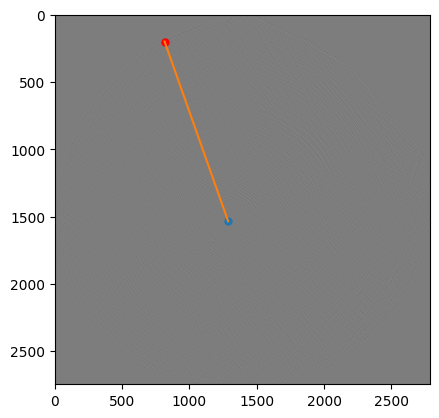

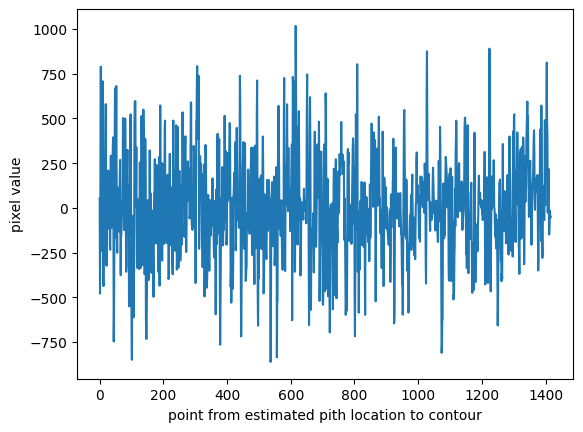

line length: 1416.9030830908944, point: [815 199]
inc count 306, dec count 298
peaks 245
good_count 199, bad_count 199


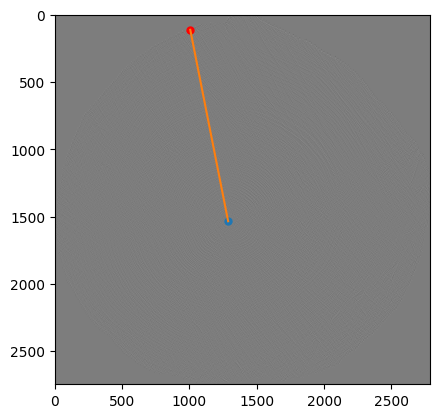

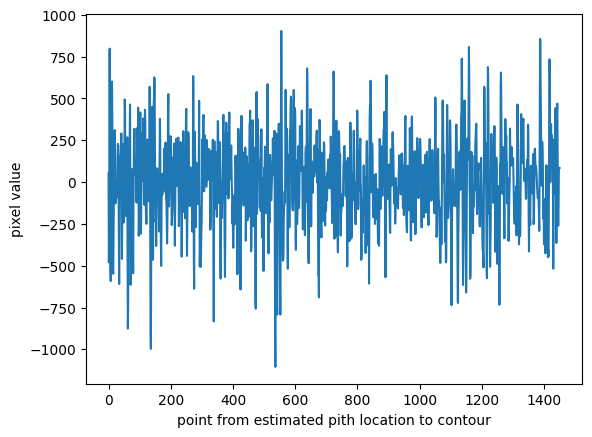

line length: 1450.3802677720805, point: [1006  112]
inc count 276, dec count 283
peaks 236
good_count 188, bad_count 188


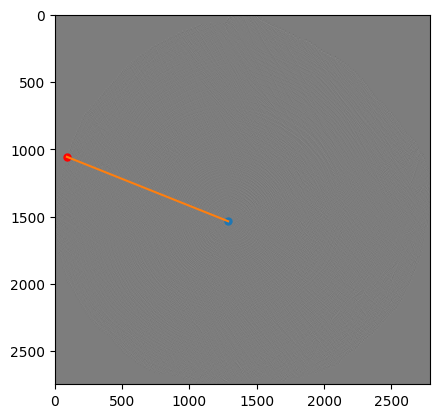

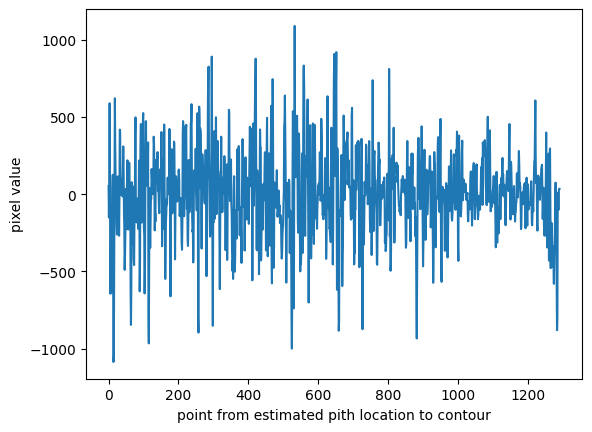

line length: 1290.5925191342742, point: [  89 1056]
inc count 250, dec count 260
peaks 224
good_count 176, bad_count 176


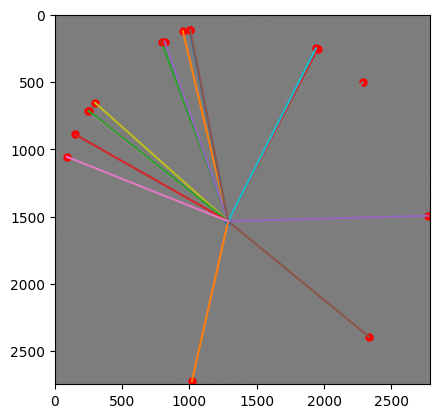

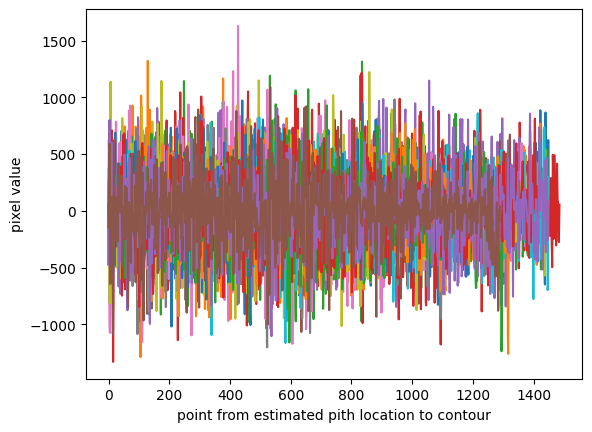

2 1-11c00bf7cc3e03dc86bde8a20c8ab390b0b2f2a4_d5d5dbc0f05ff34587375f4a567740b61c4731a6_instant_210319.jpg


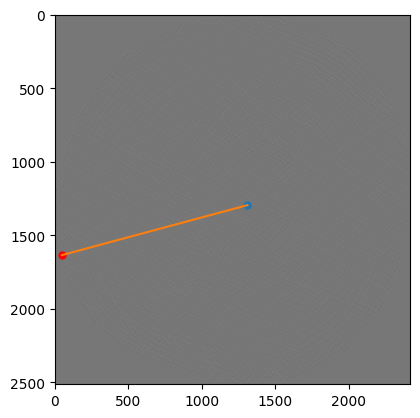

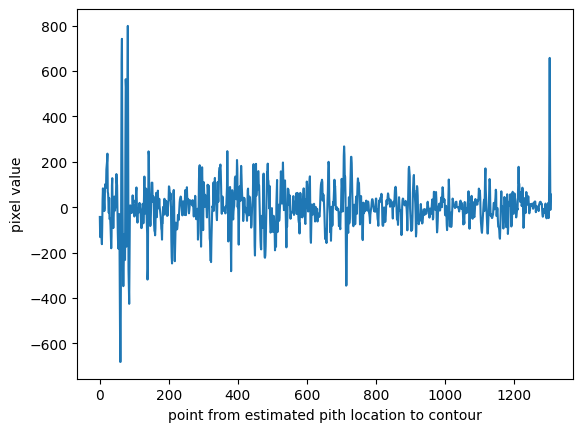

line length: 1306.9907223188673, point: [  47 1635]
inc count 222, dec count 227
peaks 168
good_count 117, bad_count 118


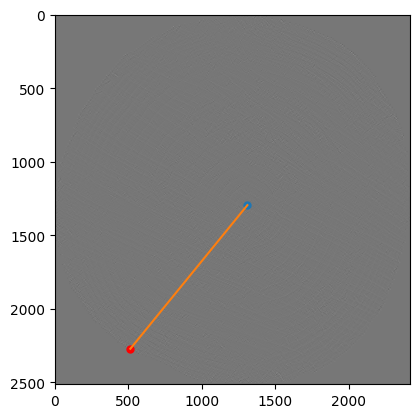

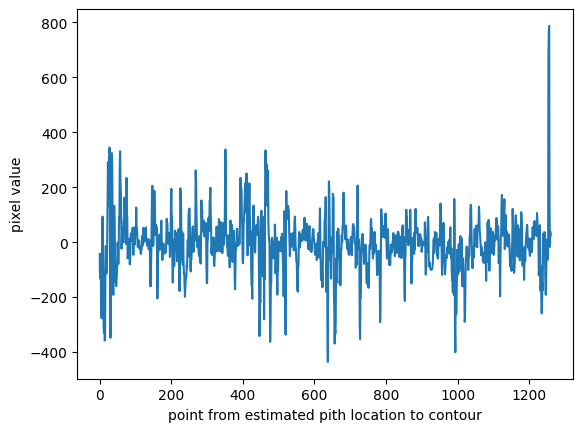

line length: 1260.1111116081001, point: [ 513 2272]
inc count 241, dec count 239
peaks 177
good_count 123, bad_count 123


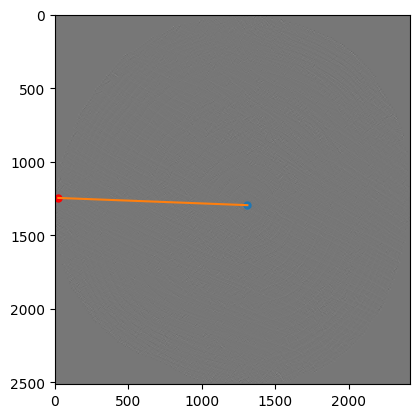

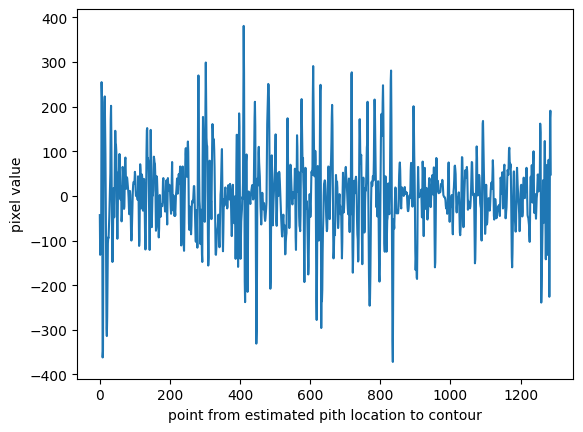

line length: 1286.976501239016, point: [  23 1246]
inc count 195, dec count 198
peaks 148
good_count 106, bad_count 106


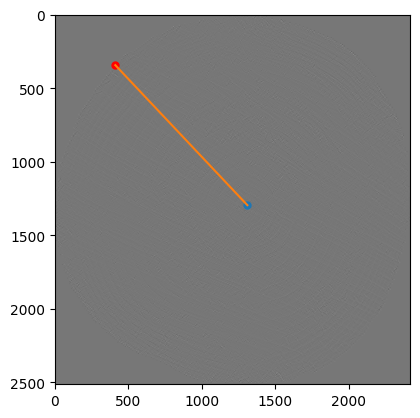

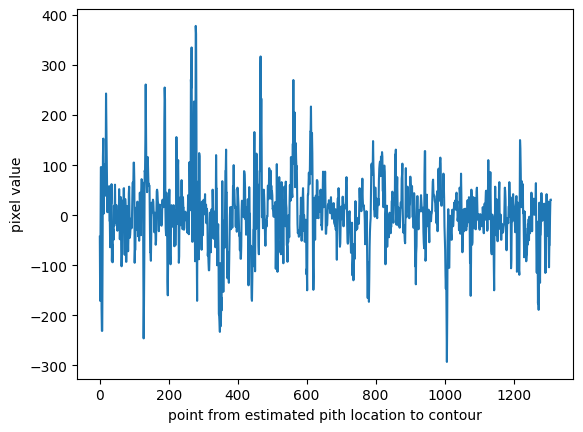

line length: 1308.8507201615275, point: [411 343]
inc count 269, dec count 264
peaks 203
good_count 140, bad_count 141


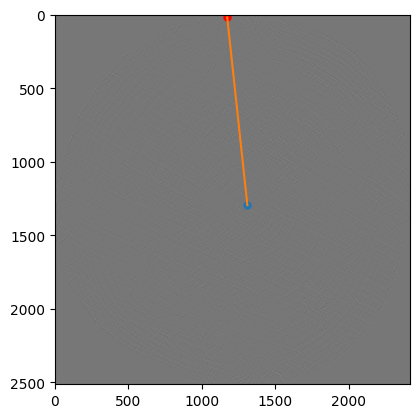

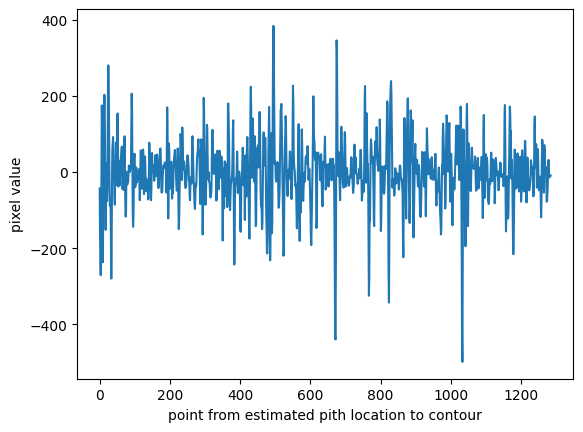

line length: 1284.4966396267503, point: [1172   18]
inc count 204, dec count 213
peaks 161
good_count 109, bad_count 110


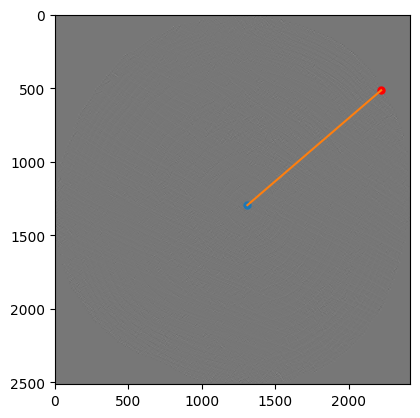

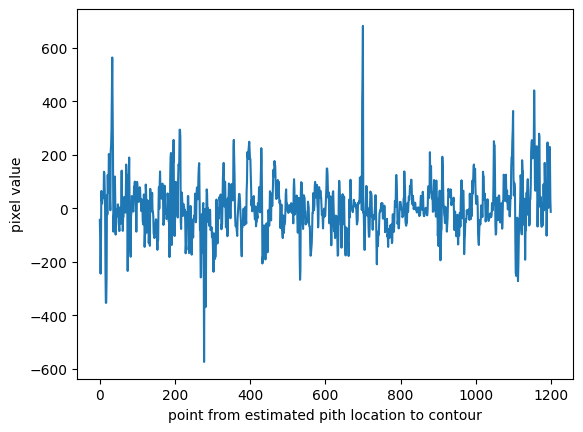

line length: 1199.2716996641439, point: [2219  514]
inc count 226, dec count 239
peaks 170
good_count 123, bad_count 124


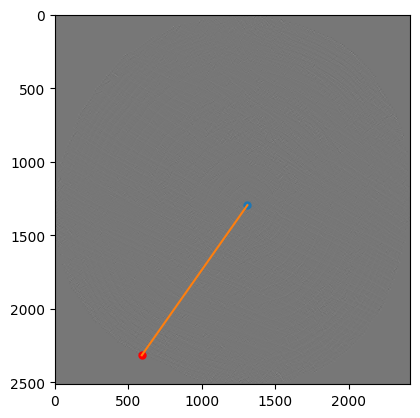

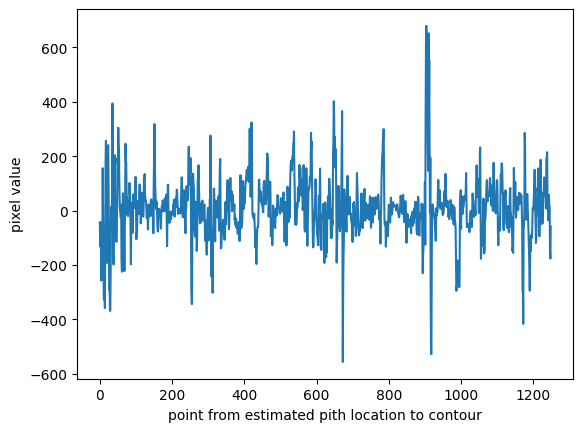

line length: 1248.0703694446338, point: [ 591 2316]
inc count 241, dec count 237
peaks 195
good_count 143, bad_count 144


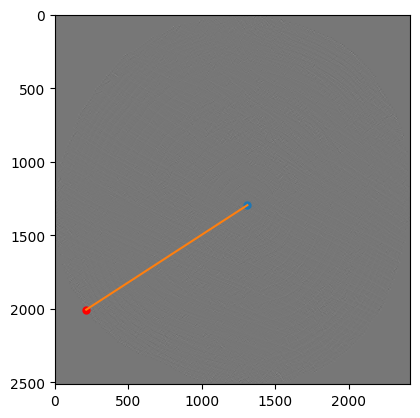

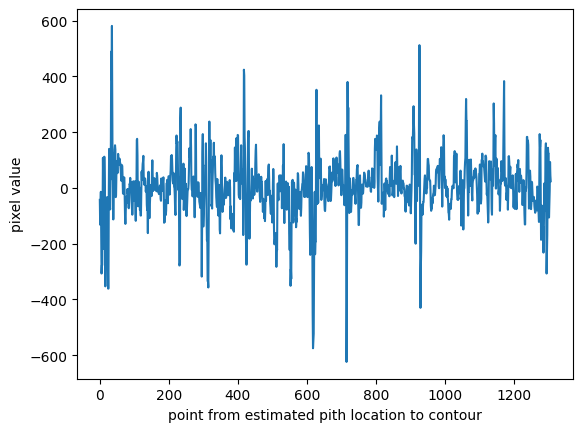

line length: 1306.3622905623788, point: [ 213 2006]
inc count 279, dec count 255
peaks 208
good_count 141, bad_count 142


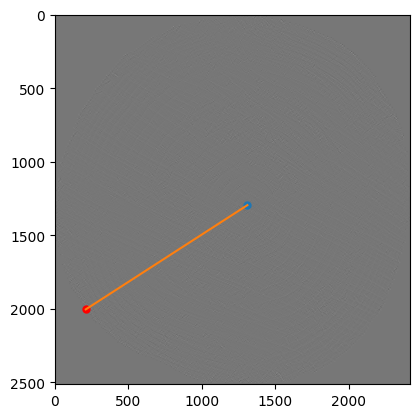

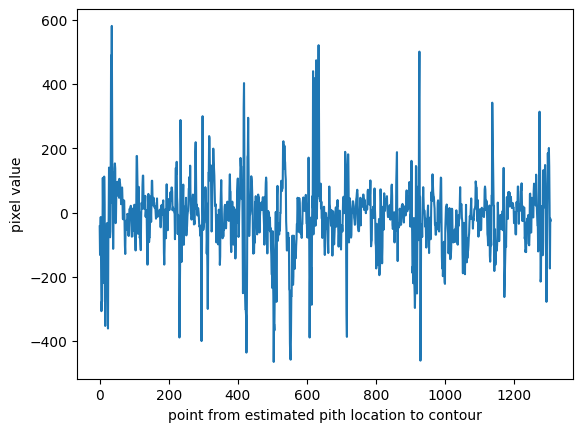

line length: 1307.7952131579993, point: [ 210 2004]
inc count 255, dec count 261
peaks 173
good_count 145, bad_count 146


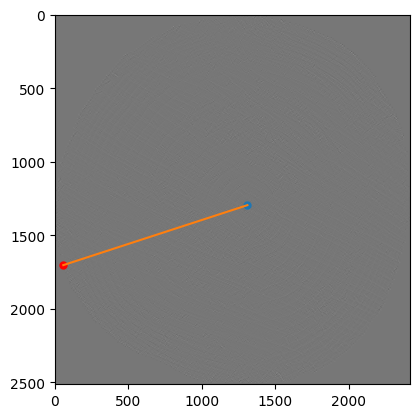

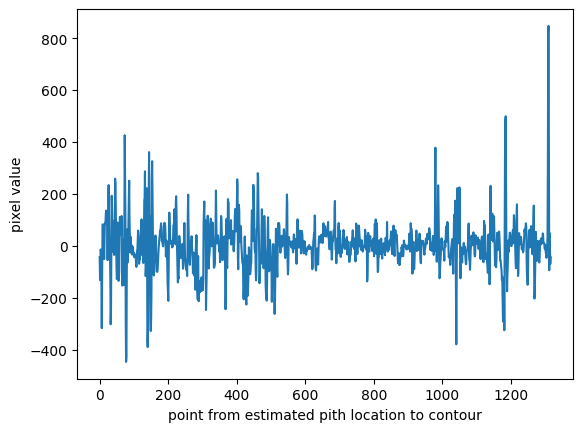

line length: 1316.7860340327802, point: [  57 1703]
inc count 245, dec count 241
peaks 192
good_count 123, bad_count 124


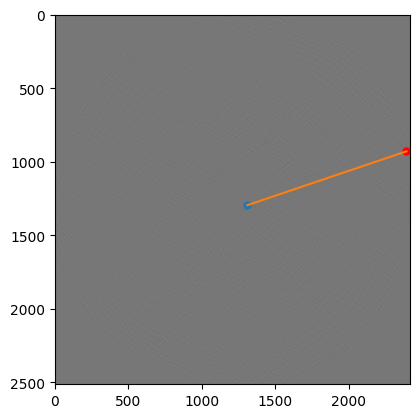

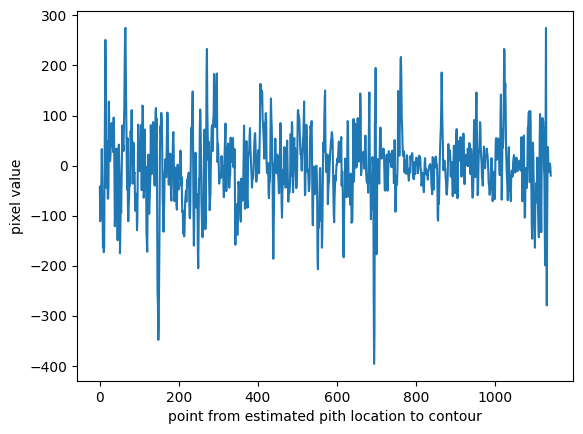

line length: 1142.243958712711, point: [2391  929]
inc count 203, dec count 208
peaks 149
good_count 95, bad_count 96


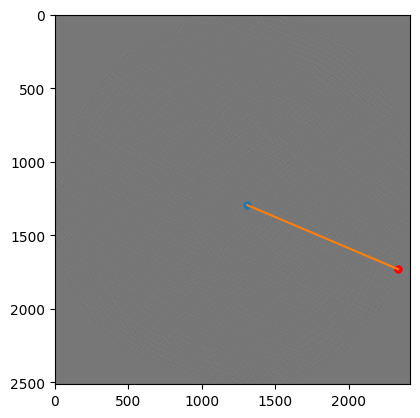

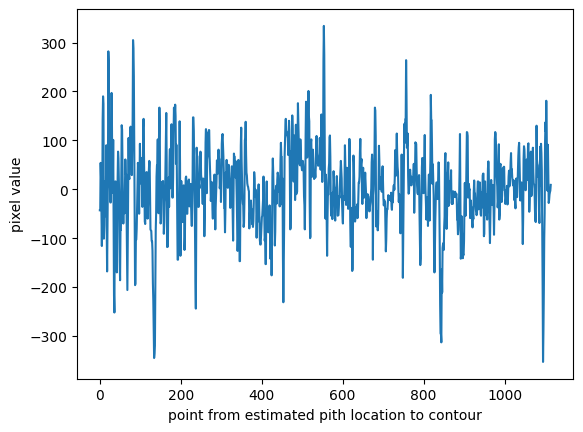

line length: 1114.6979285731677, point: [2335 1731]
inc count 198, dec count 196
peaks 153
good_count 113, bad_count 114


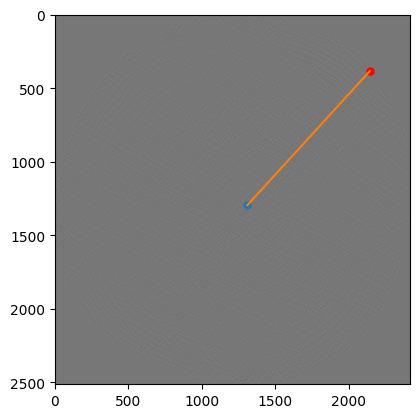

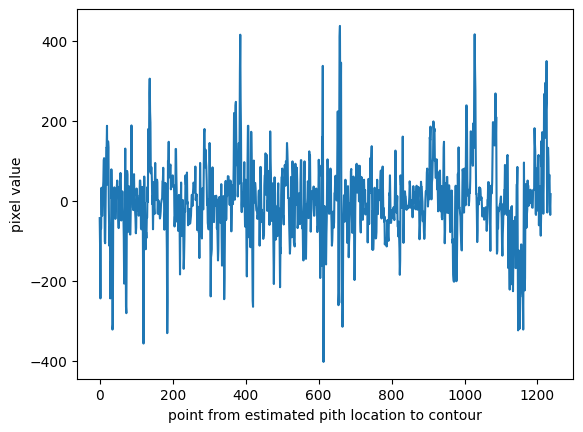

line length: 1236.6753850846558, point: [2143  382]
inc count 249, dec count 240
peaks 189
good_count 142, bad_count 143


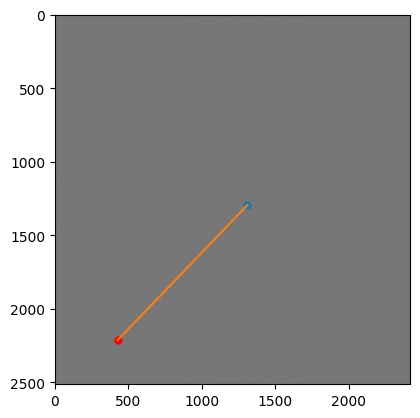

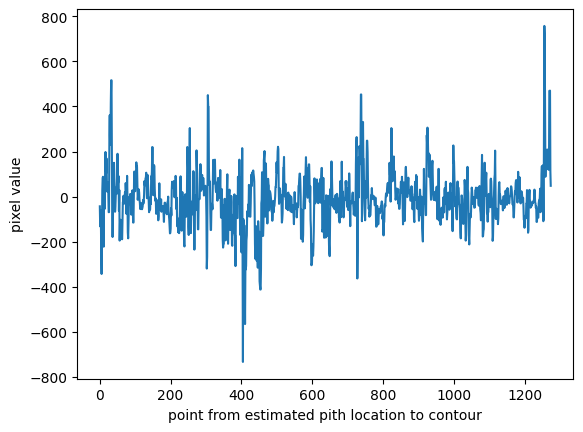

line length: 1274.3667795852039, point: [ 426 2214]
inc count 242, dec count 233
peaks 171
good_count 136, bad_count 137


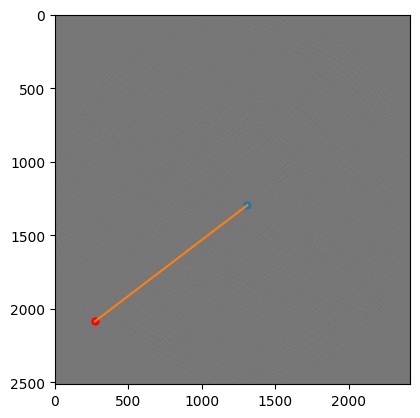

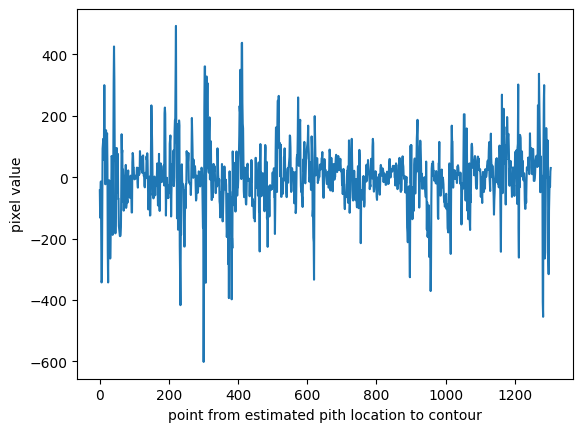

line length: 1304.171973891773, point: [ 272 2086]
inc count 265, dec count 270
peaks 197
good_count 156, bad_count 156


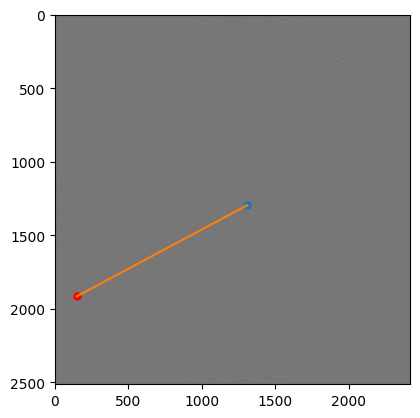

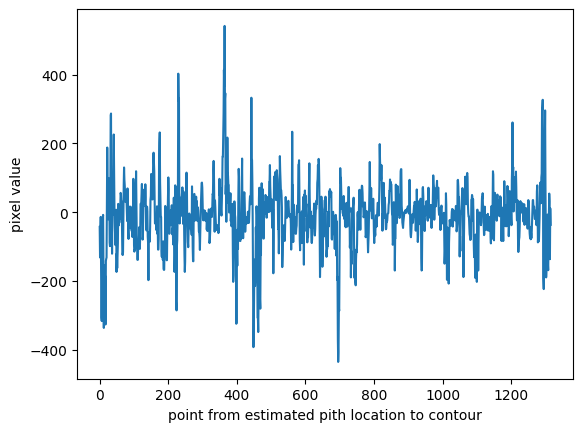

line length: 1315.2491584171314, point: [ 149 1915]
inc count 267, dec count 262
peaks 180
good_count 134, bad_count 134


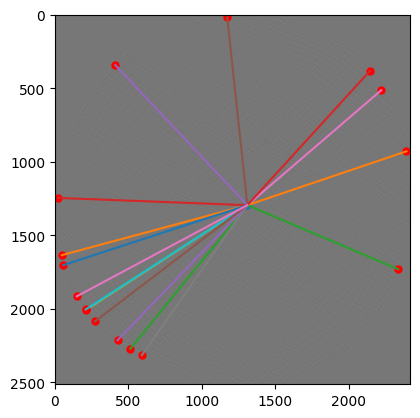

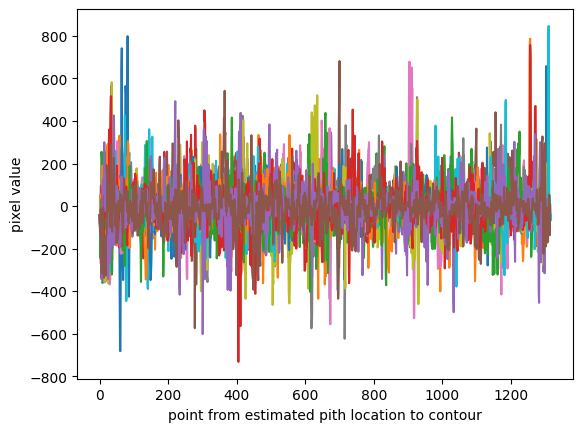

3 2-8c5de8aa63e57b1e5d3a11ce4c4e2ded042b2ef3_0693ab68bf2278539a3733129d6964ba7719f7b2.jpg


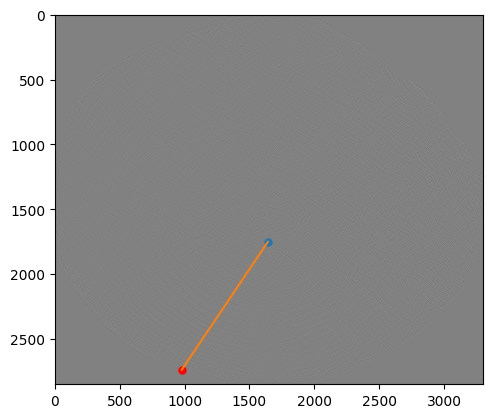

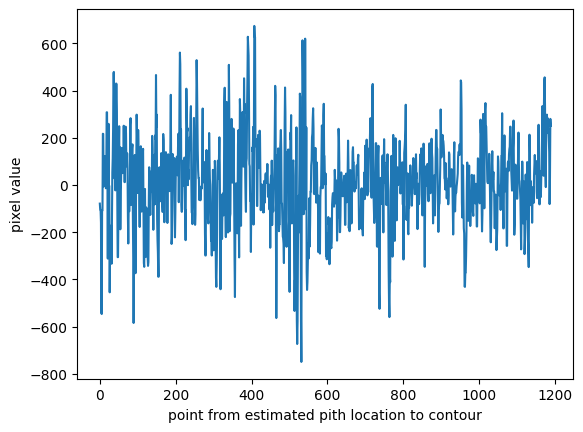

line length: 1189.5220806232307, point: [ 978 2738]
inc count 232, dec count 228
peaks 200
good_count 170, bad_count 171


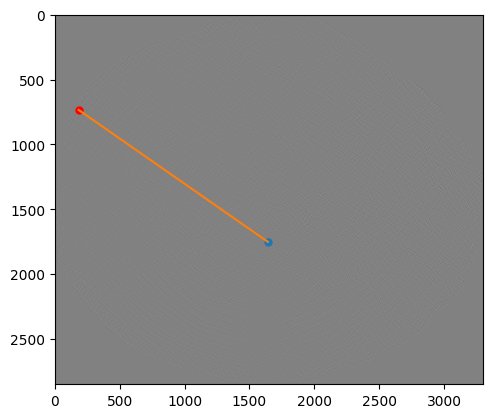

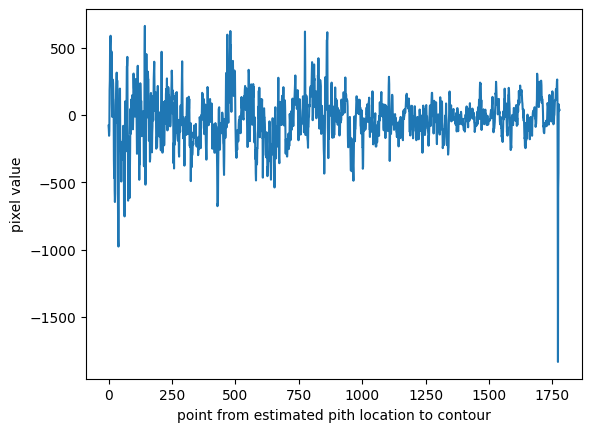

line length: 1778.5411390063718, point: [183 734]
inc count 375, dec count 370
peaks 238
good_count 216, bad_count 216


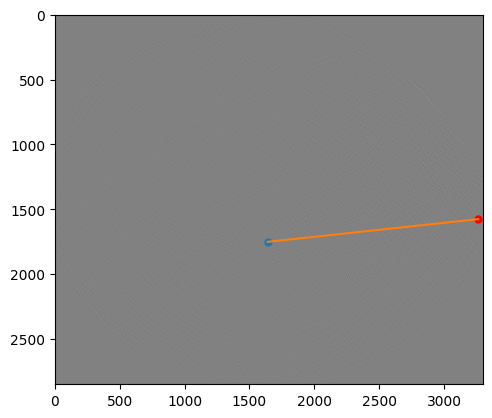

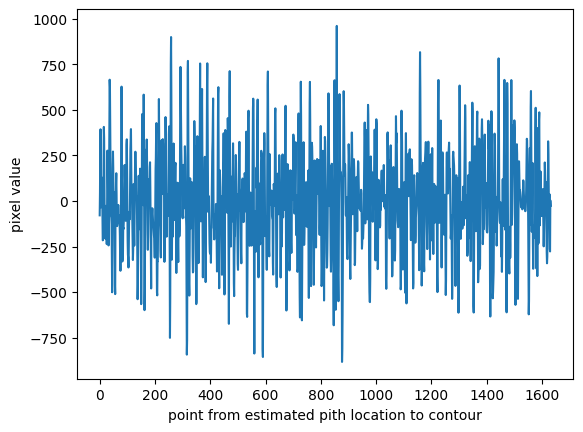

line length: 1631.3900850223051, point: [3264 1576]
inc count 250, dec count 253
peaks 220
good_count 169, bad_count 169


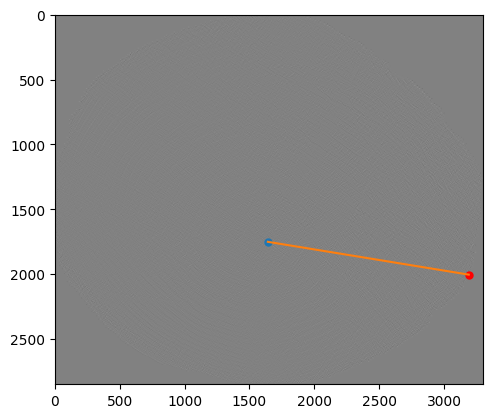

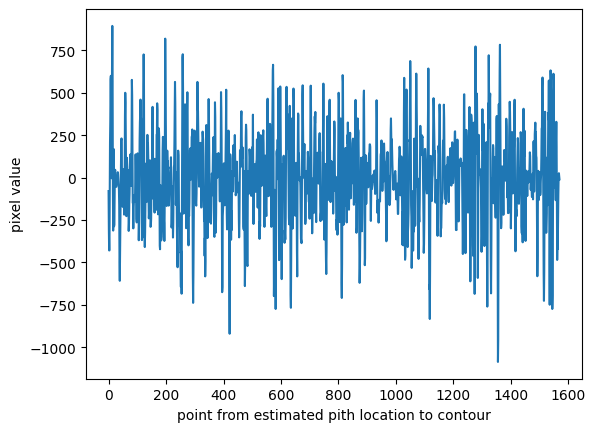

line length: 1569.483009717207, point: [3191 2004]
inc count 275, dec count 272
peaks 226
good_count 167, bad_count 167


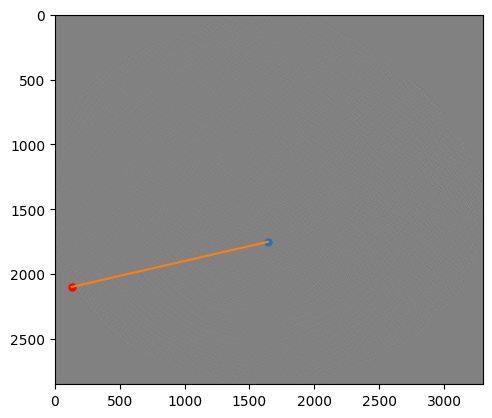

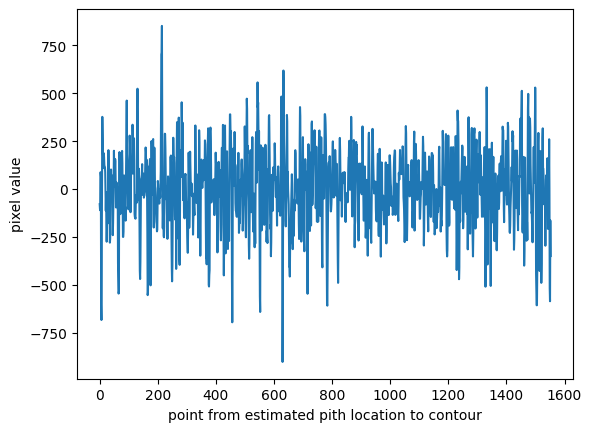

line length: 1552.5193952285993, point: [ 129 2099]
inc count 264, dec count 270
peaks 231
good_count 170, bad_count 171


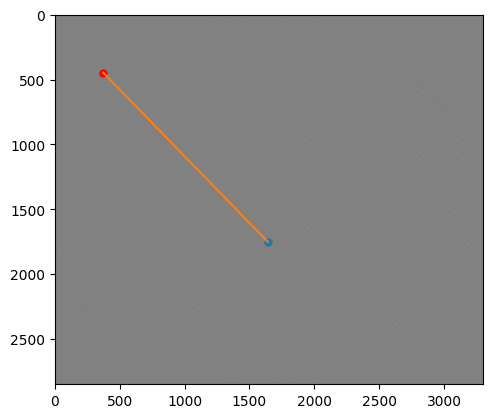

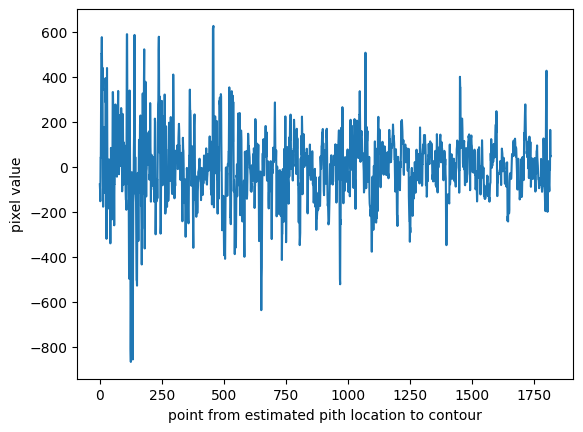

line length: 1819.627846506188, point: [373 447]
inc count 358, dec count 352
peaks 272
good_count 208, bad_count 208


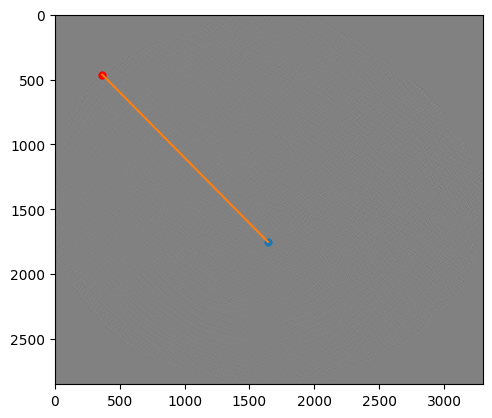

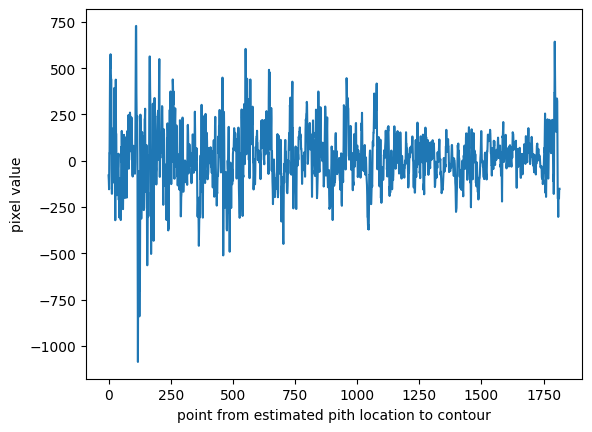

line length: 1814.5293649273522, point: [365 462]
inc count 339, dec count 346
peaks 283
good_count 192, bad_count 192


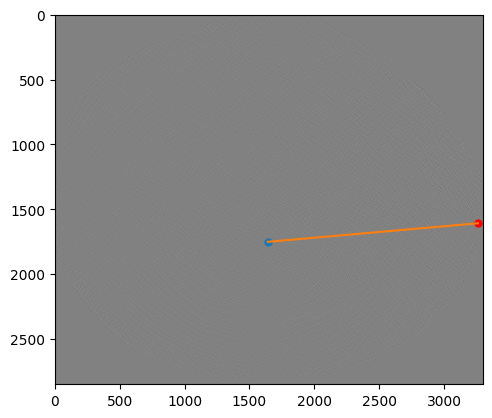

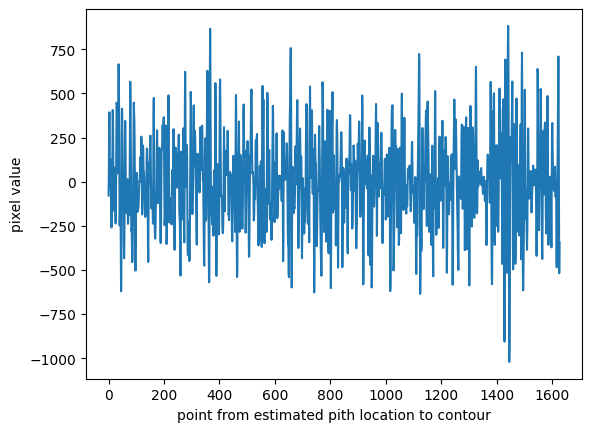

line length: 1626.274602004787, point: [3262 1608]
inc count 257, dec count 255
peaks 215
good_count 165, bad_count 165


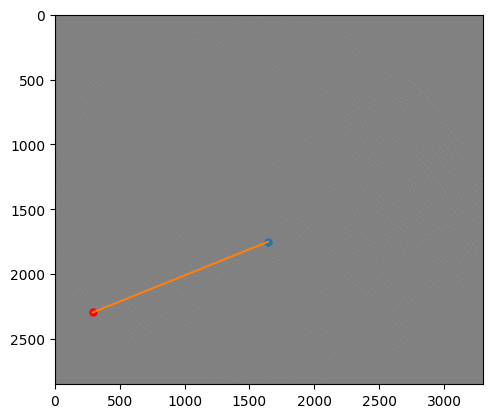

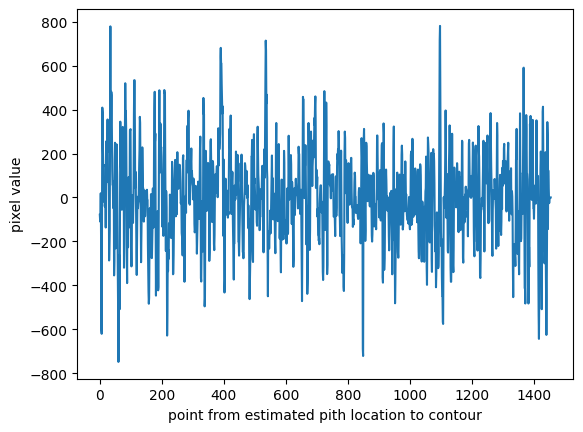

line length: 1455.4864618913086, point: [ 292 2295]
inc count 260, dec count 270
peaks 214
good_count 165, bad_count 166


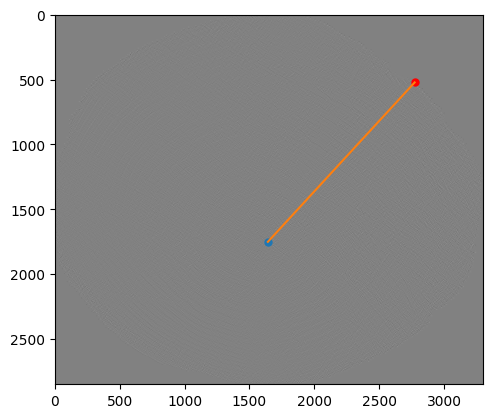

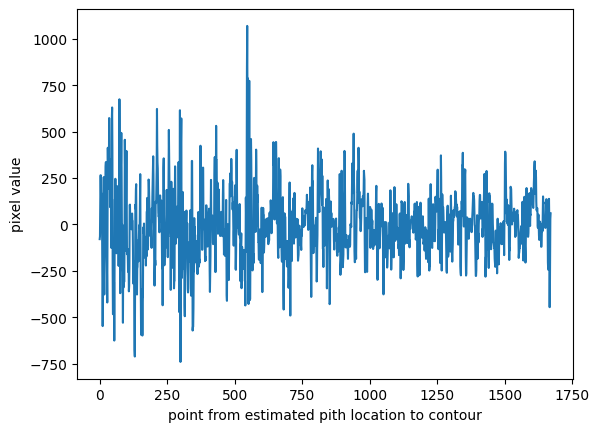

line length: 1670.919903055609, point: [2774  522]
inc count 303, dec count 293
peaks 237
good_count 201, bad_count 200


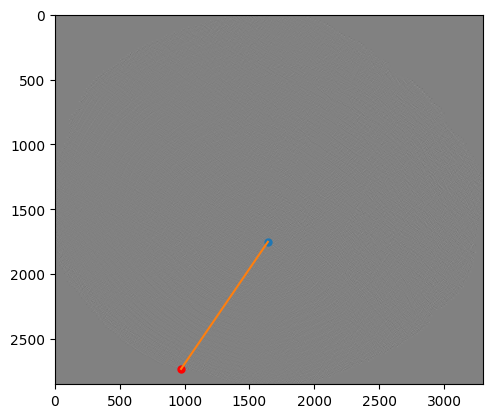

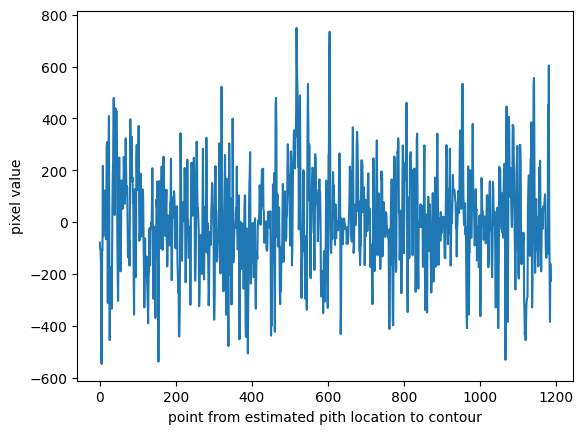

line length: 1186.5328098829686, point: [ 973 2731]
inc count 218, dec count 218
peaks 186
good_count 159, bad_count 160


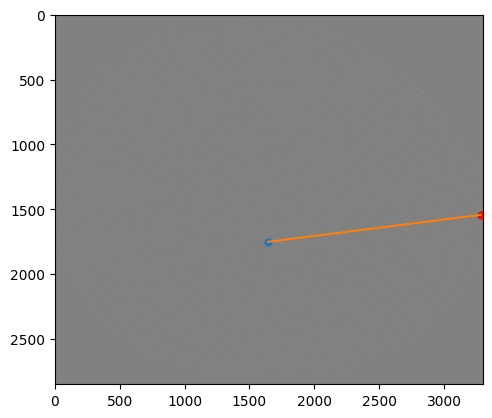

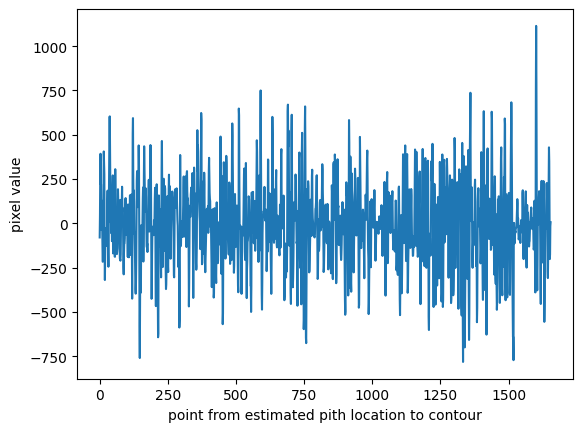

line length: 1654.1079851035427, point: [3283 1543]
inc count 276, dec count 278
peaks 233
good_count 186, bad_count 186


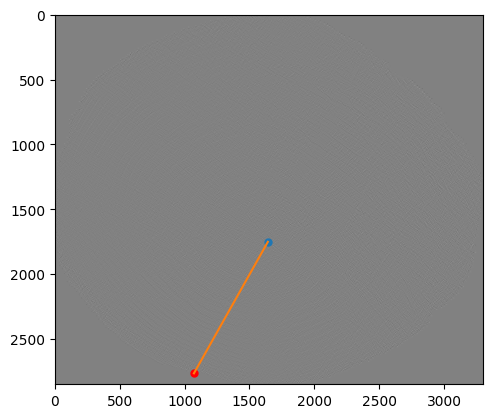

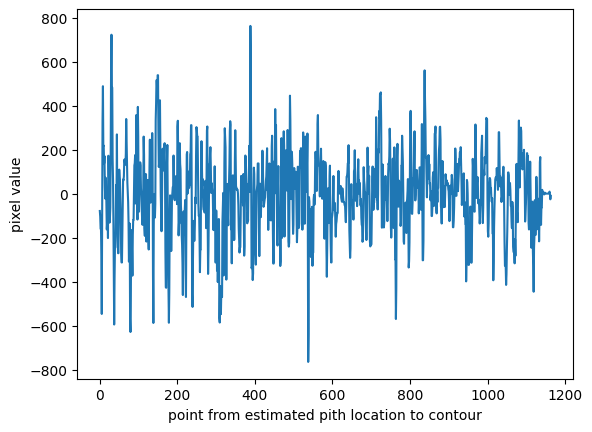

line length: 1163.1784087064948, point: [1072 2765]
inc count 206, dec count 203
peaks 184
good_count 131, bad_count 132


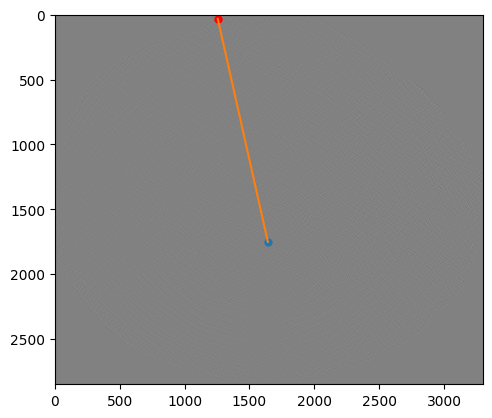

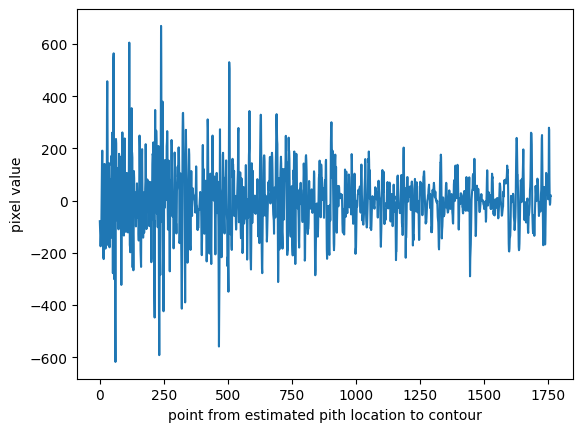

line length: 1761.8827835112972, point: [1256   32]
inc count 288, dec count 287
peaks 229
good_count 157, bad_count 158


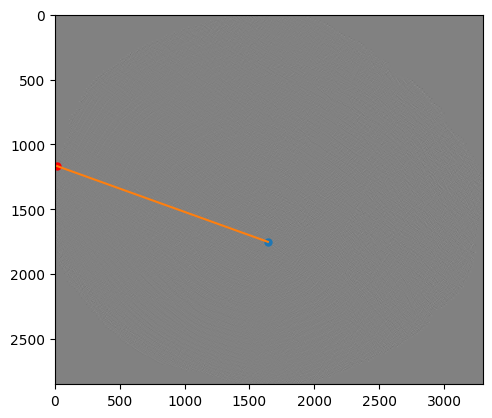

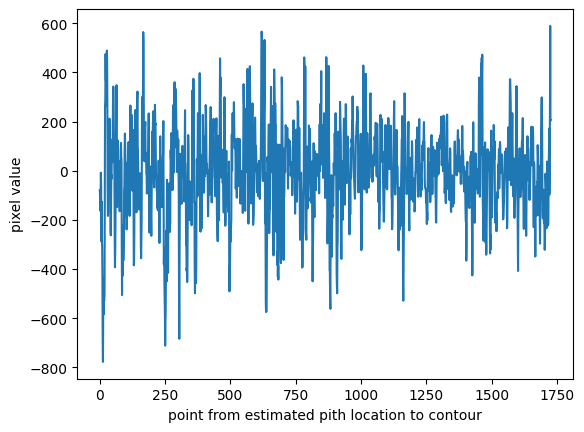

line length: 1726.8083119828395, point: [  17 1167]
inc count 332, dec count 332
peaks 257
good_count 168, bad_count 168


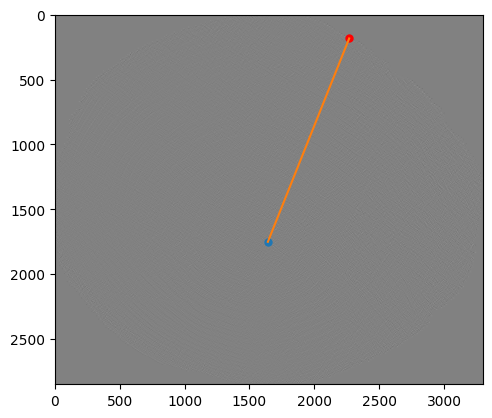

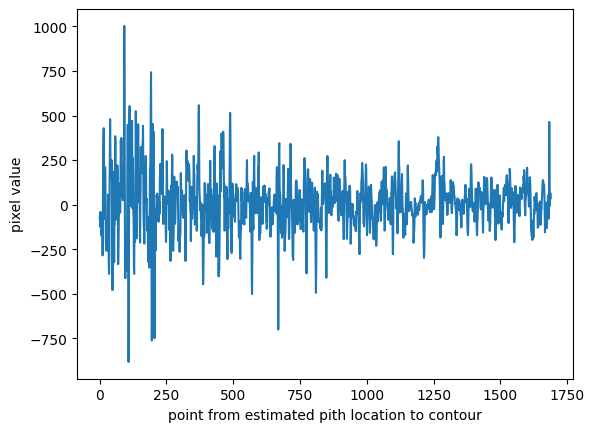

line length: 1688.7693769669247, point: [2269  183]
inc count 291, dec count 292
peaks 239
good_count 176, bad_count 176


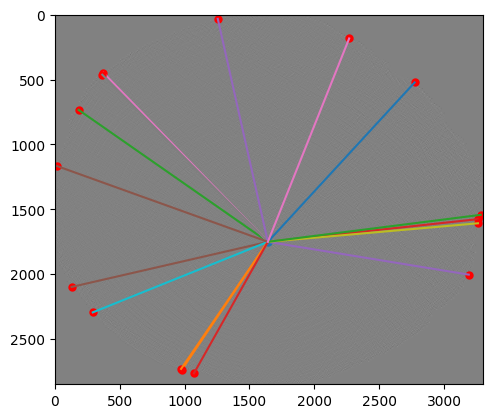

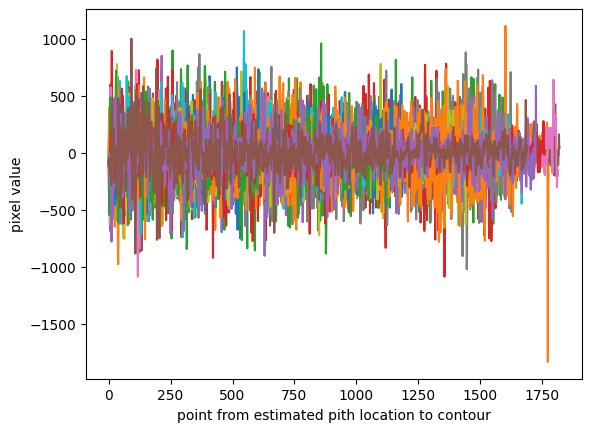

4 1-3d78e56849a16c0b17831129f6059e367574a138_8560eccb0f16269a00f2d6c6a5fab7419529c803_instant.jpg


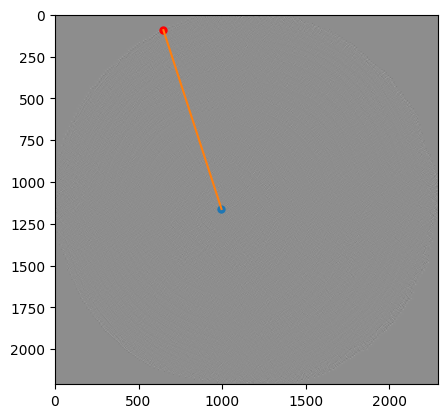

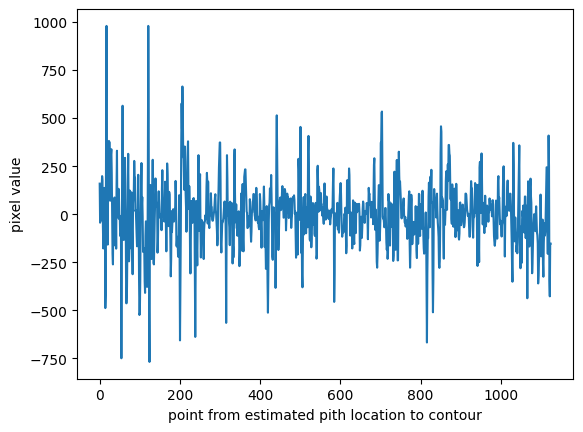

line length: 1124.8308276532237, point: [649  92]
inc count 215, dec count 220
peaks 188
good_count 156, bad_count 155


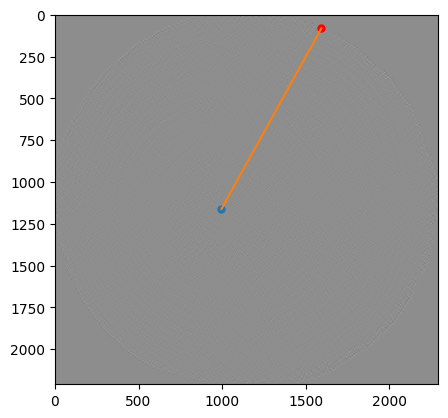

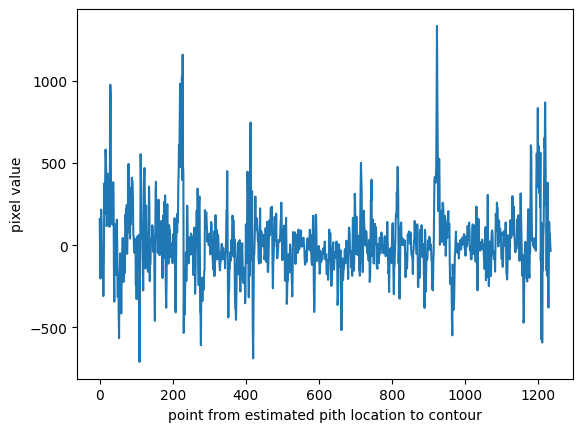

line length: 1235.0473125433034, point: [1594   81]
inc count 269, dec count 271
peaks 220
good_count 162, bad_count 161


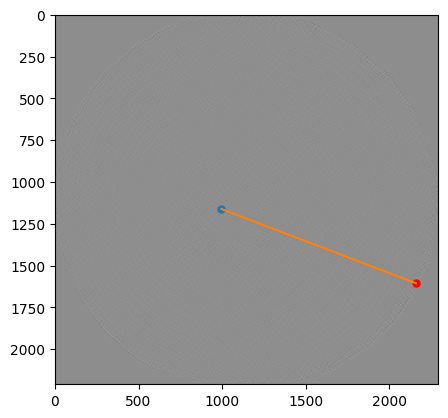

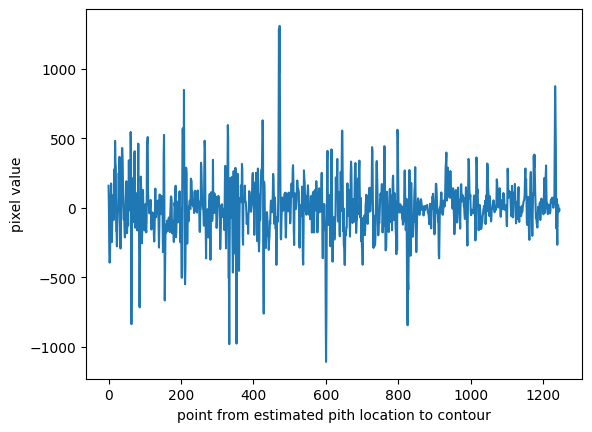

line length: 1245.4895145657254, point: [2160 1606]
inc count 254, dec count 254
peaks 206
good_count 161, bad_count 161


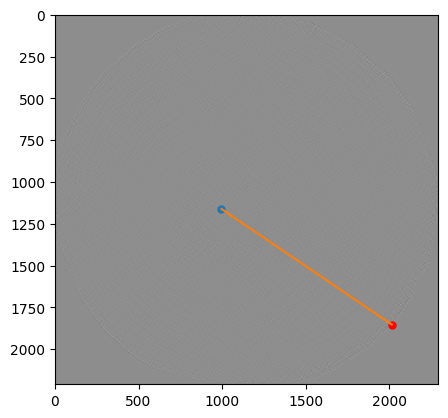

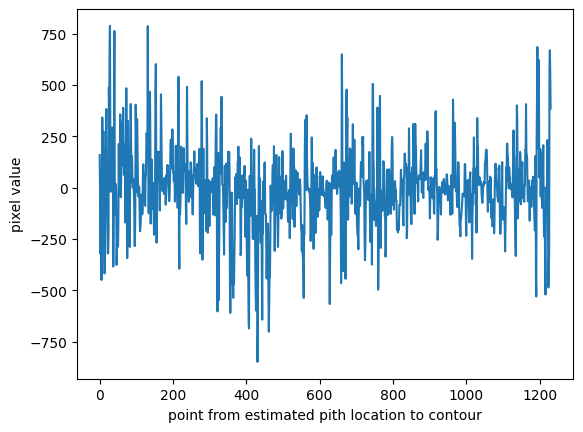

line length: 1230.9544808203814, point: [2015 1853]
inc count 252, dec count 256
peaks 222
good_count 173, bad_count 173


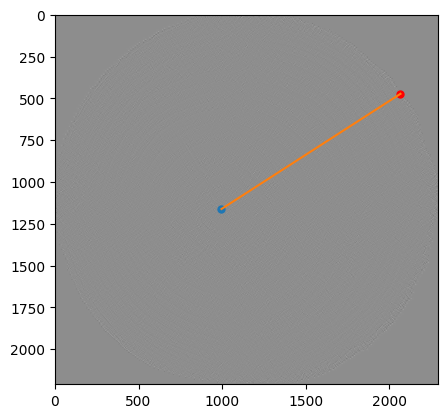

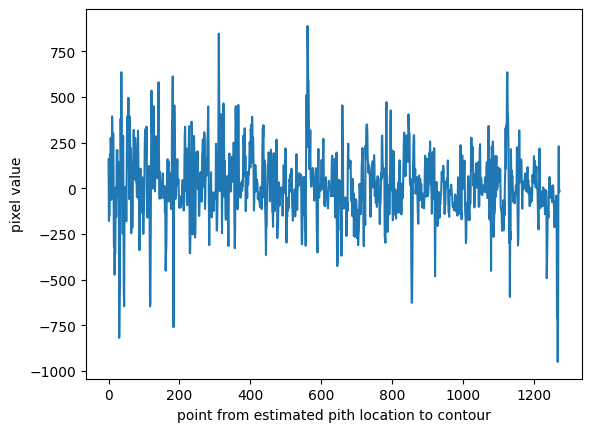

line length: 1273.0617676771942, point: [2067  473]
inc count 297, dec count 288
peaks 235
good_count 163, bad_count 163


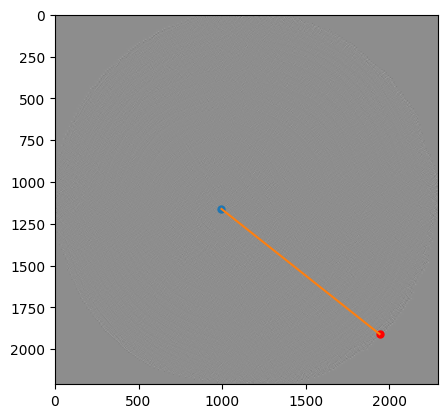

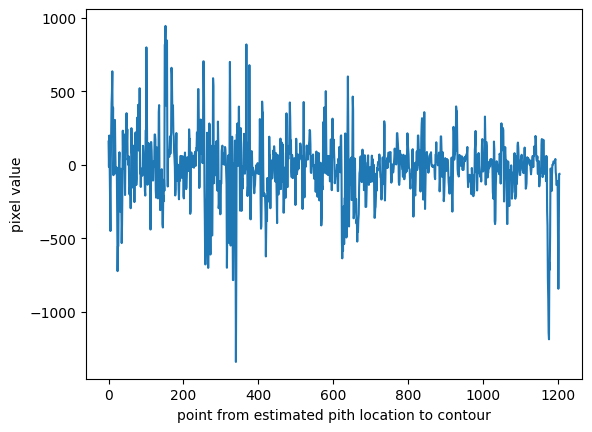

line length: 1205.7791994166867, point: [1942 1910]
inc count 255, dec count 245
peaks 204
good_count 178, bad_count 178


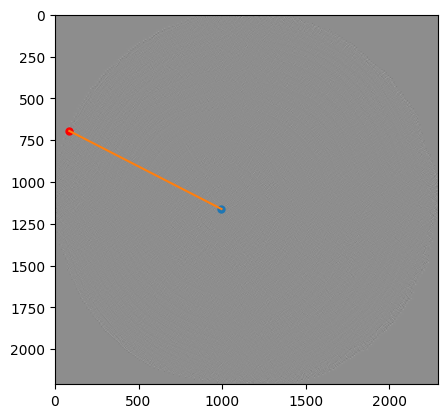

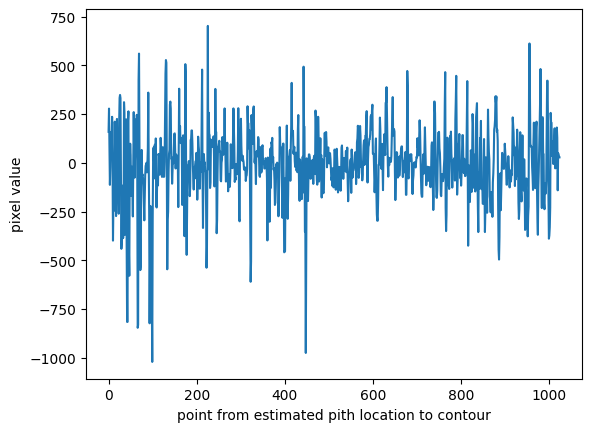

line length: 1023.1162950892565, point: [ 86 695]
inc count 211, dec count 208
peaks 177
good_count 145, bad_count 145


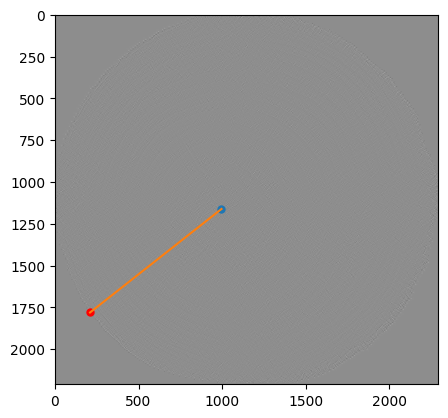

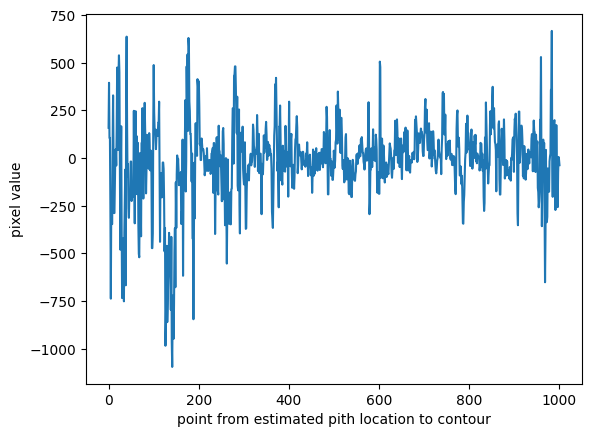

line length: 1000.8911172169223, point: [ 210 1781]
inc count 219, dec count 216
peaks 177
good_count 143, bad_count 144


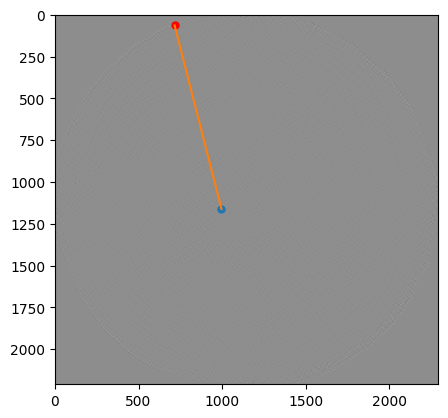

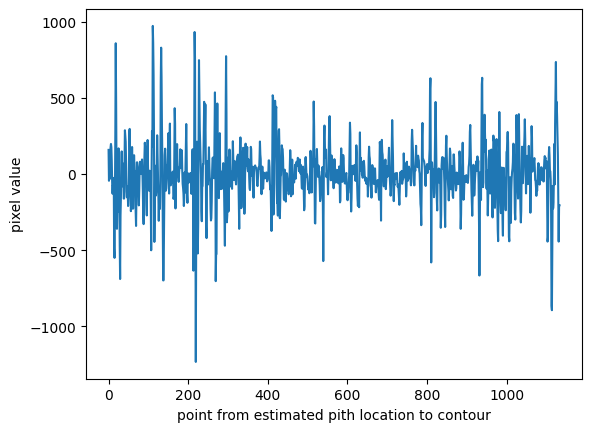

line length: 1133.0829231166333, point: [716  64]
inc count 215, dec count 217
peaks 177
good_count 145, bad_count 145


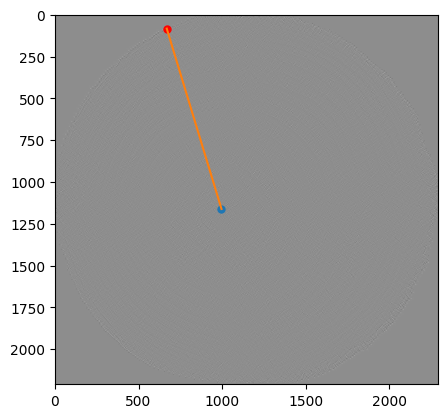

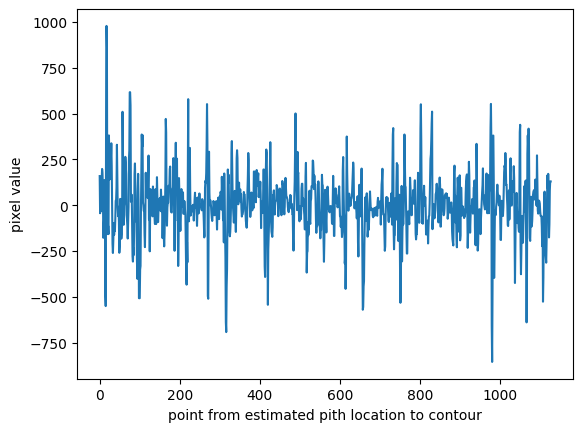

line length: 1127.4247357970867, point: [669  83]
inc count 213, dec count 212
peaks 182
good_count 136, bad_count 136


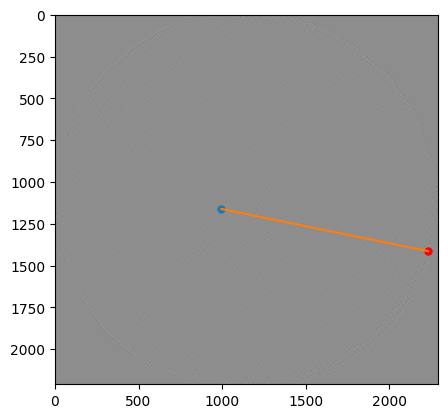

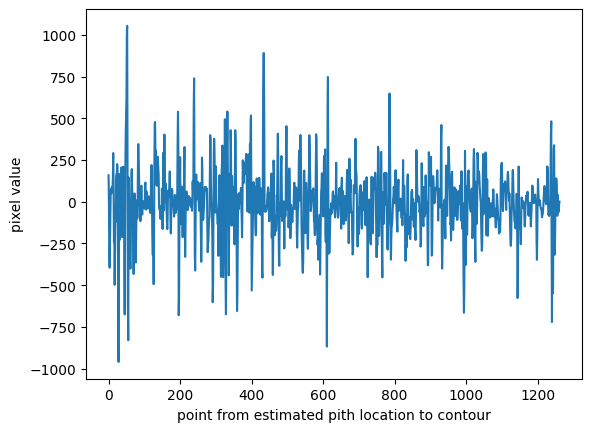

line length: 1261.068290188366, point: [2232 1414]
inc count 250, dec count 252
peaks 195
good_count 165, bad_count 166


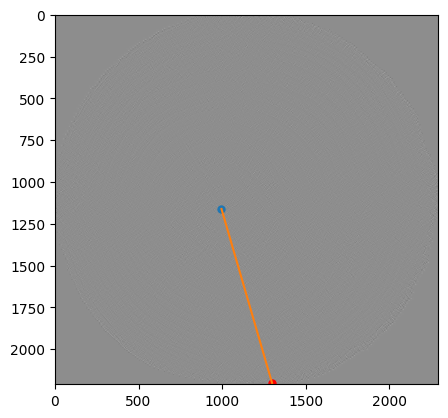

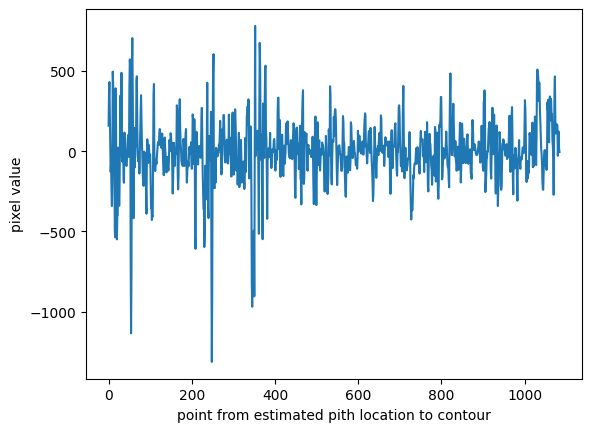

line length: 1084.2420686086073, point: [1299 2203]
inc count 215, dec count 212
peaks 175
good_count 141, bad_count 141


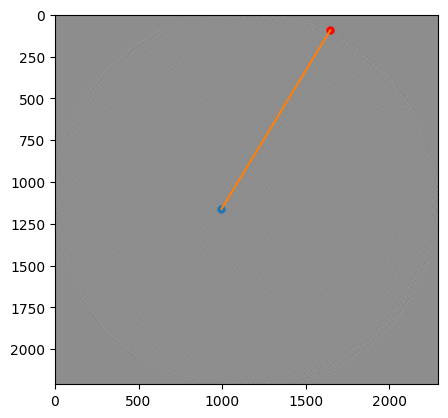

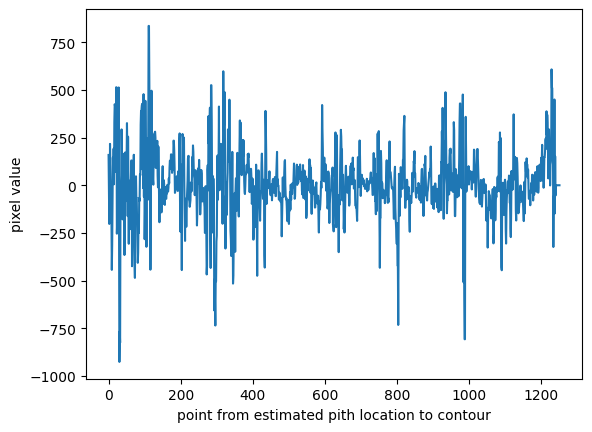

line length: 1251.279487397526, point: [1647   93]
inc count 278, dec count 287
peaks 224
good_count 160, bad_count 160


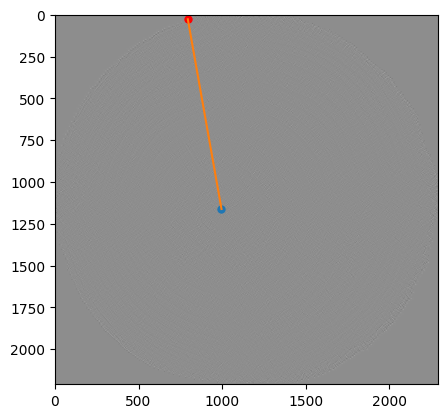

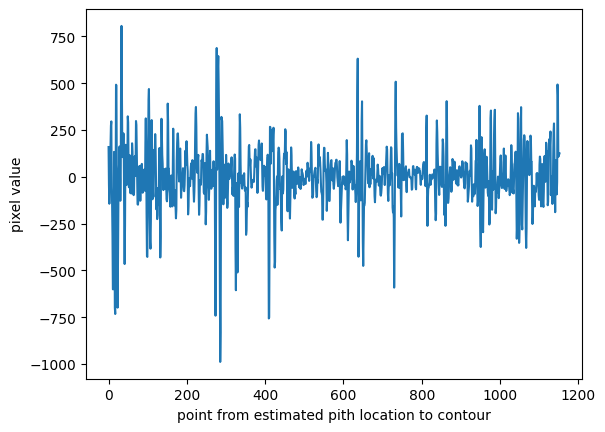

line length: 1152.5727595898968, point: [795  27]
inc count 223, dec count 221
peaks 174
good_count 131, bad_count 130


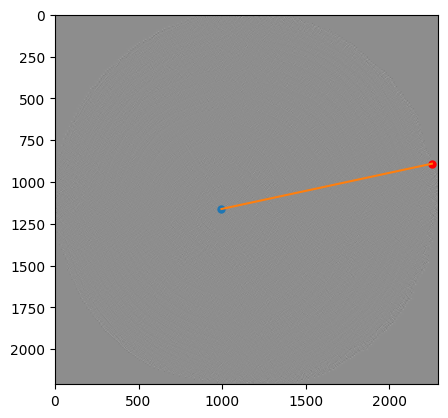

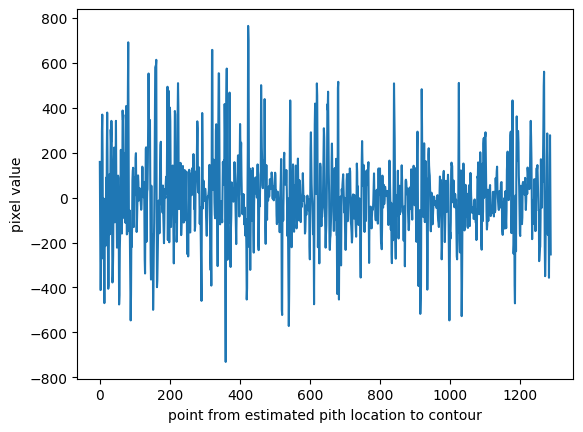

line length: 1287.412007481294, point: [2255  891]
inc count 257, dec count 263
peaks 205
good_count 159, bad_count 160


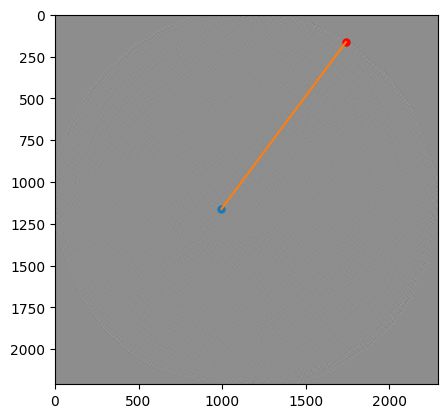

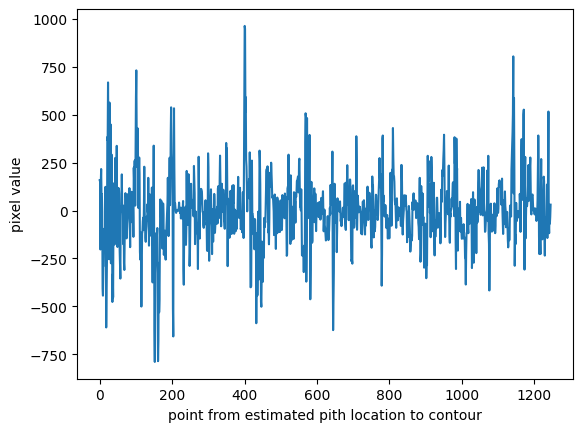

line length: 1245.8377221256328, point: [1741  163]
inc count 308, dec count 311
peaks 230
good_count 182, bad_count 182


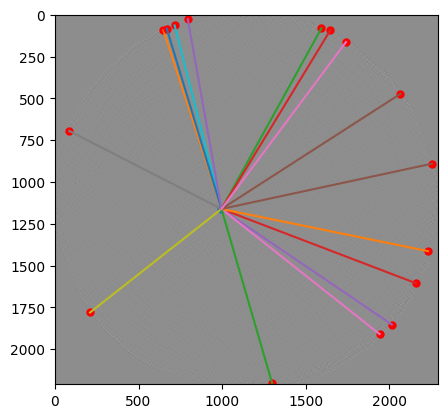

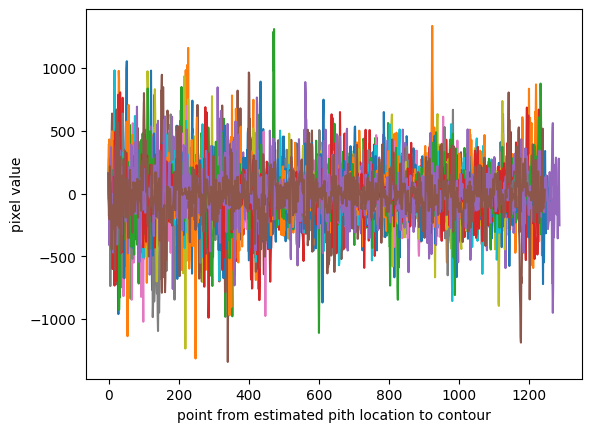

5 1-947a57fc1b94be1fb8a5cce439cd8112016648b1_b151d6624e13c4d31f300f909ebb63577e42a730_instant.jpg


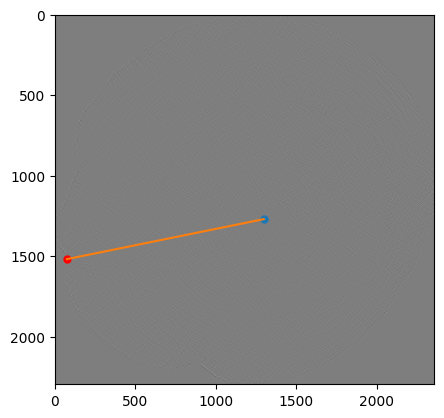

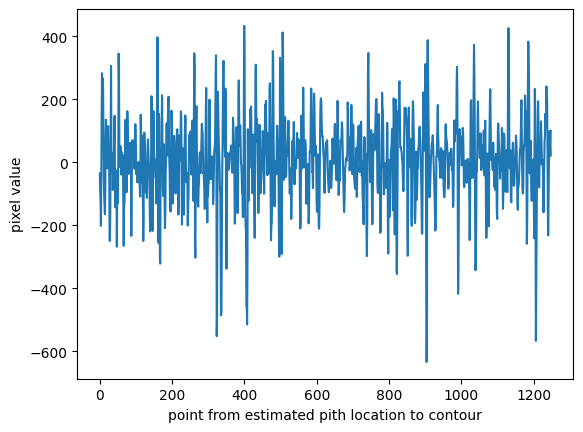

line length: 1247.251264596085, point: [  75 1518]
inc count 215, dec count 213
peaks 181
good_count 129, bad_count 129


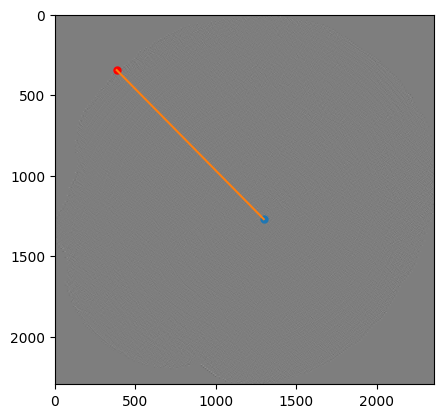

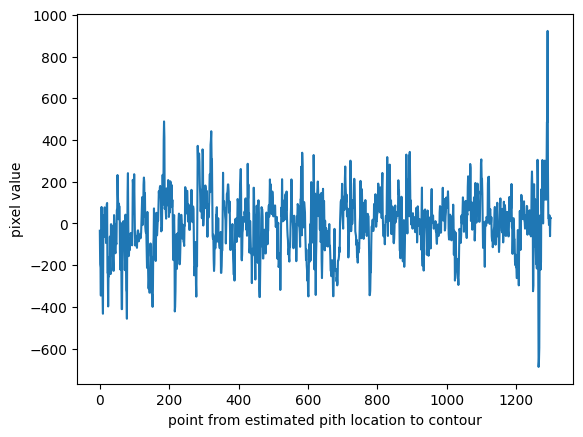

line length: 1300.3642218581583, point: [384 344]
inc count 286, dec count 269
peaks 212
good_count 158, bad_count 159


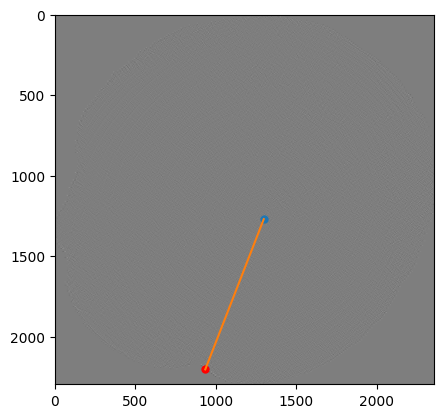

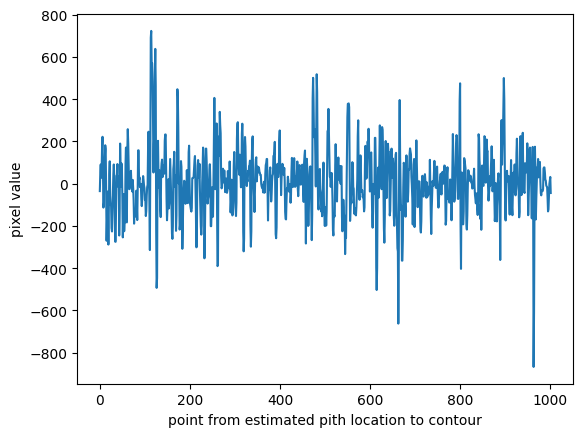

line length: 1001.536540401971, point: [ 934 2203]
inc count 185, dec count 183
peaks 160
good_count 126, bad_count 125


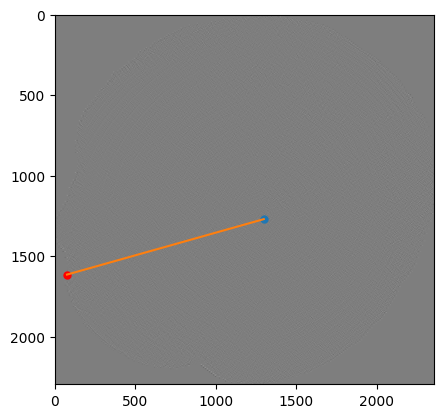

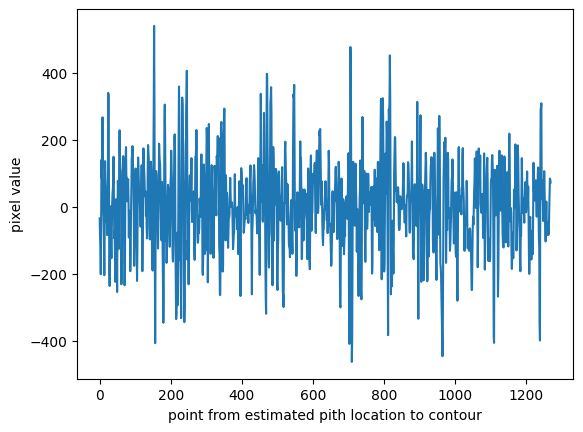

line length: 1269.8546731759222, point: [  75 1614]
inc count 225, dec count 223
peaks 188
good_count 152, bad_count 152


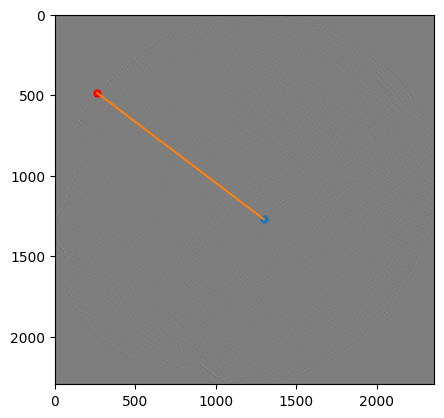

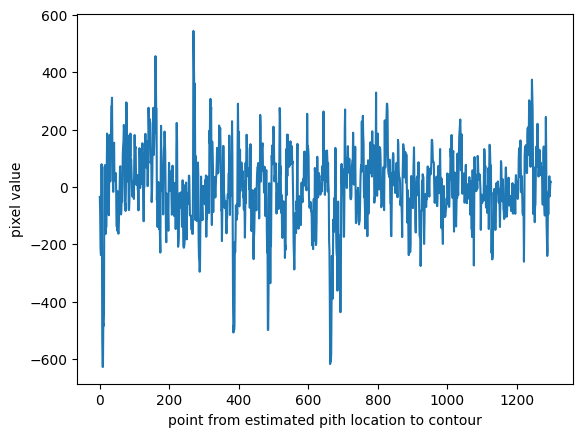

line length: 1297.6422139324184, point: [263 486]
inc count 286, dec count 276
peaks 211
good_count 170, bad_count 170


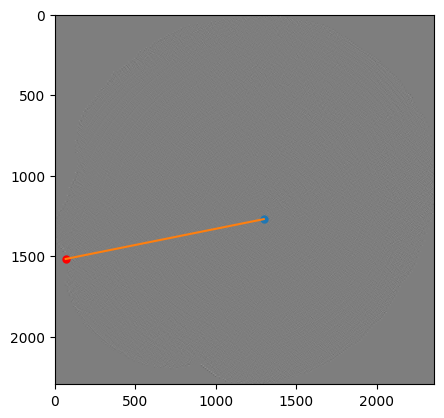

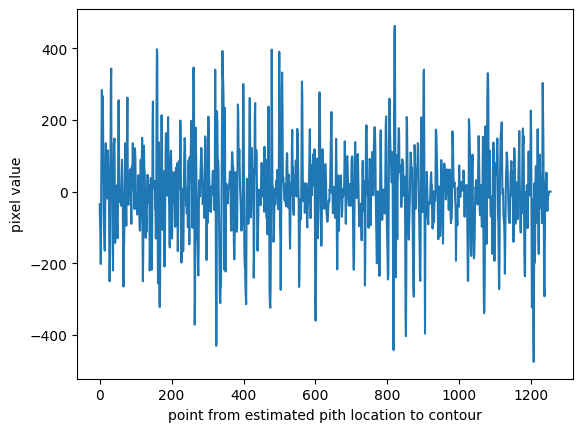

line length: 1254.8946326471294, point: [  67 1517]
inc count 220, dec count 220
peaks 184
good_count 142, bad_count 143


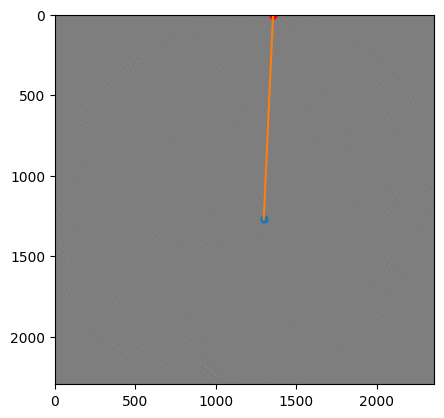

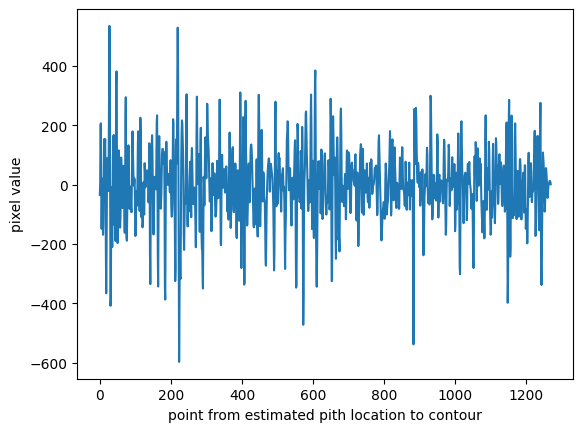

line length: 1269.983317011532, point: [1355    1]
inc count 204, dec count 206
peaks 170
good_count 137, bad_count 137


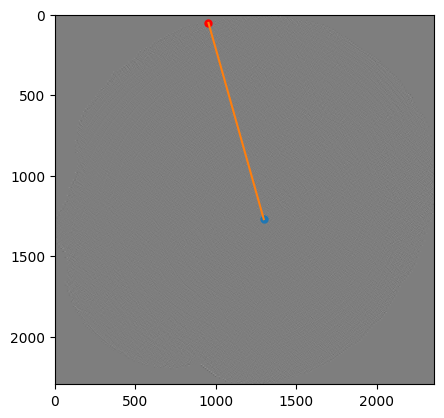

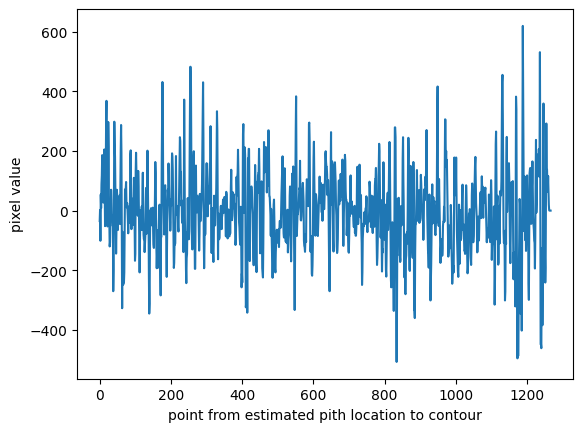

line length: 1266.096399251159, point: [954  51]
inc count 245, dec count 244
peaks 184
good_count 138, bad_count 139


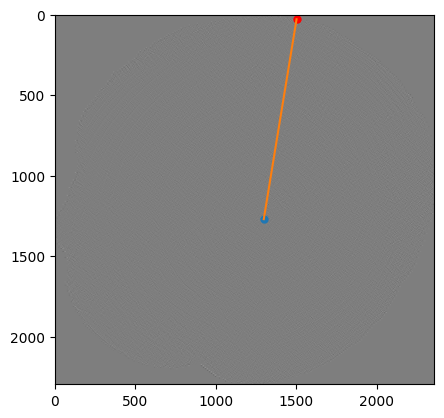

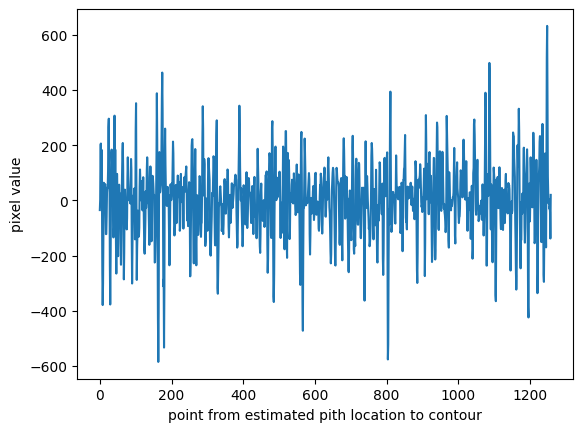

line length: 1258.2720818037385, point: [1501   28]
inc count 221, dec count 221
peaks 188
good_count 141, bad_count 141


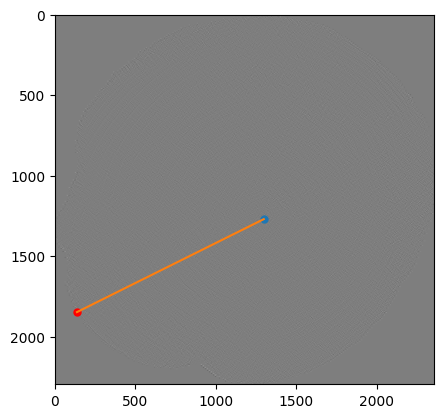

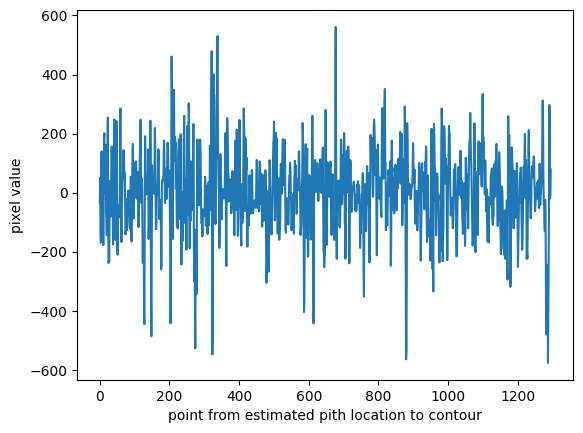

line length: 1295.9778157322687, point: [ 137 1847]
inc count 251, dec count 246
peaks 213
good_count 167, bad_count 167


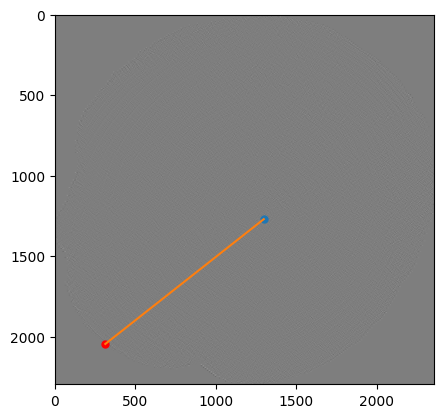

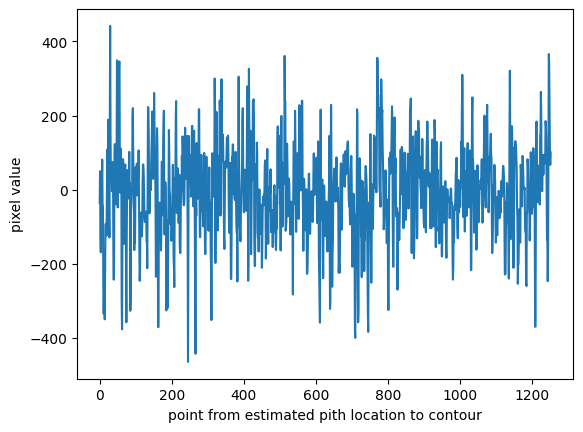

line length: 1252.9733570822596, point: [ 313 2045]
inc count 218, dec count 217
peaks 188
good_count 159, bad_count 159


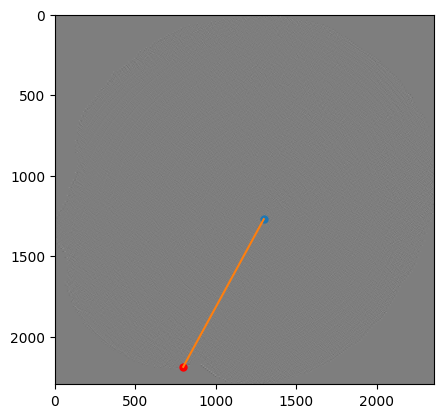

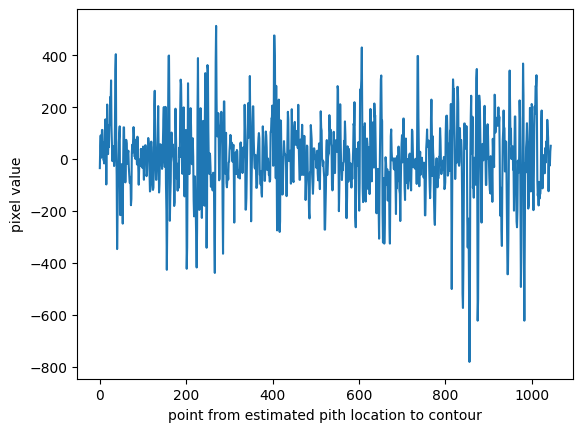

line length: 1044.8792437416, point: [ 797 2187]
inc count 205, dec count 209
peaks 172
good_count 130, bad_count 130


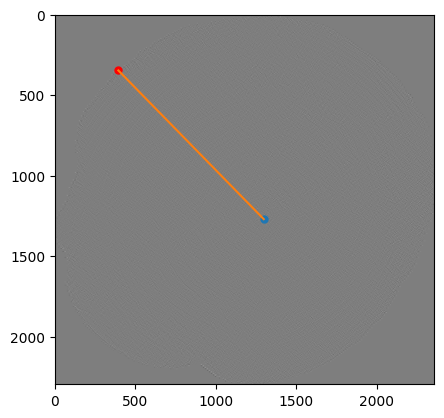

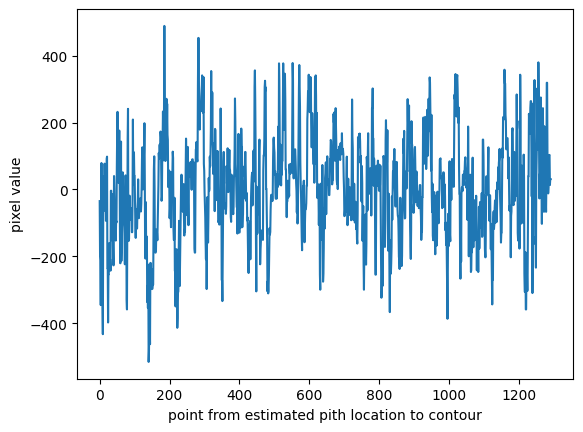

line length: 1291.9298841356326, point: [394 346]
inc count 271, dec count 264
peaks 201
good_count 143, bad_count 144


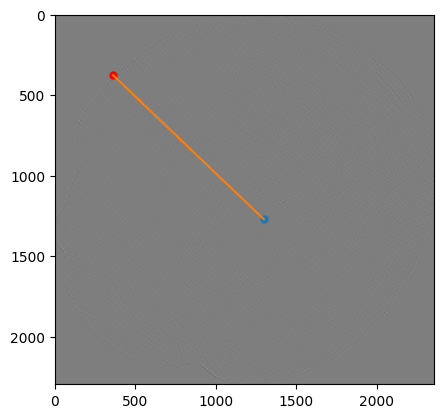

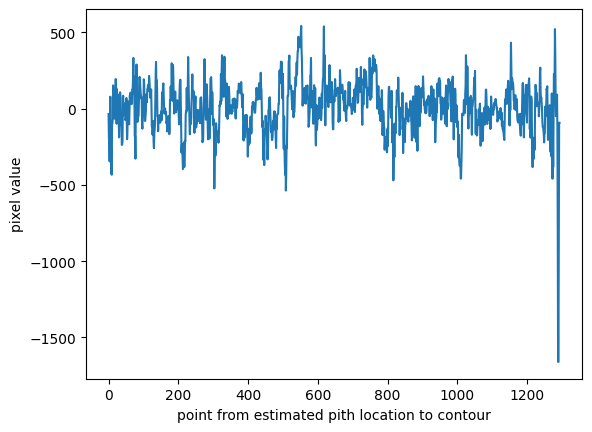

line length: 1293.5982713617975, point: [362 376]
inc count 289, dec count 277
peaks 213
good_count 145, bad_count 146


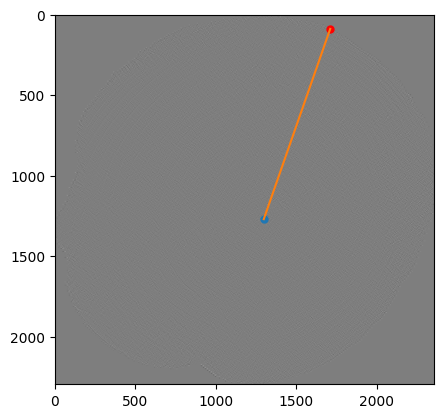

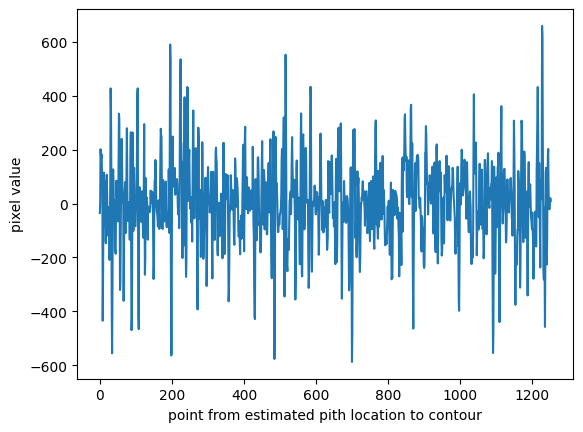

line length: 1251.6725105569844, point: [1710   88]
inc count 235, dec count 232
peaks 190
good_count 150, bad_count 150


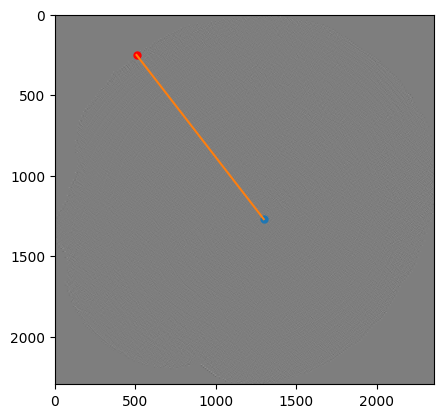

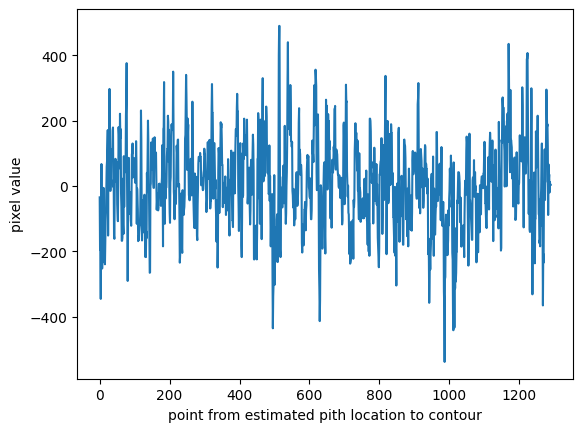

line length: 1290.0664209858382, point: [507 250]
inc count 264, dec count 264
peaks 200
good_count 161, bad_count 161


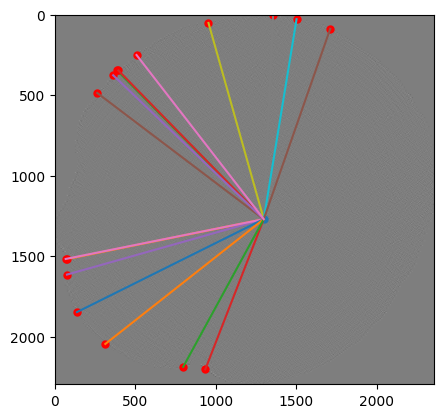

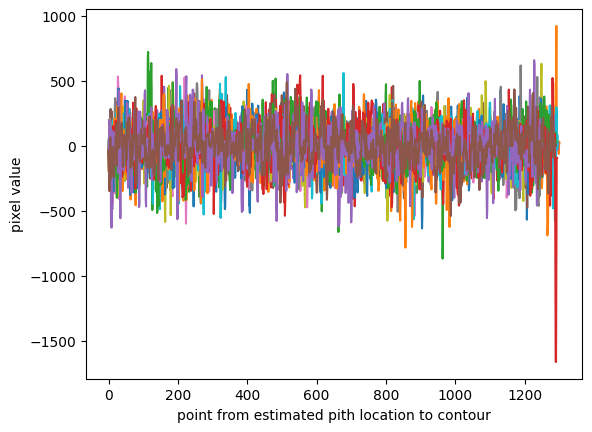

6 1-1f43f59e9f5ead12a13b1cd892a8757242367189_9cd89303dd466e6b178399f8d02b12aae69ec707_instant.jpg


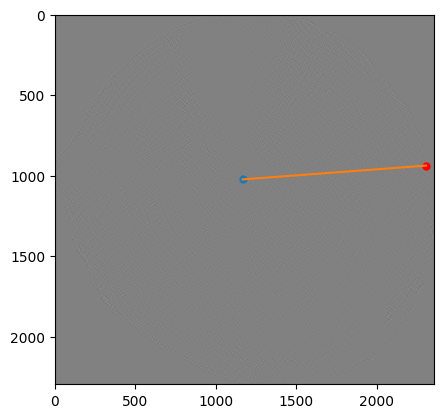

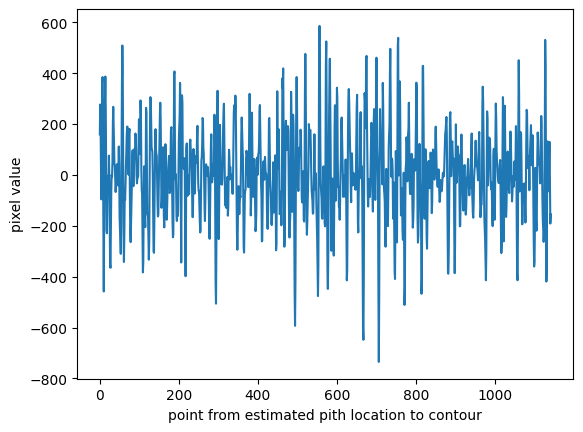

line length: 1142.0930746959957, point: [2305  937]
inc count 188, dec count 188
peaks 154
good_count 124, bad_count 124


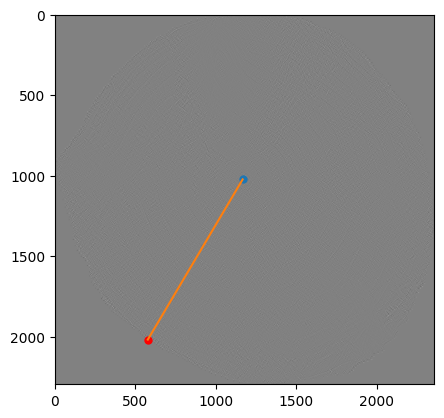

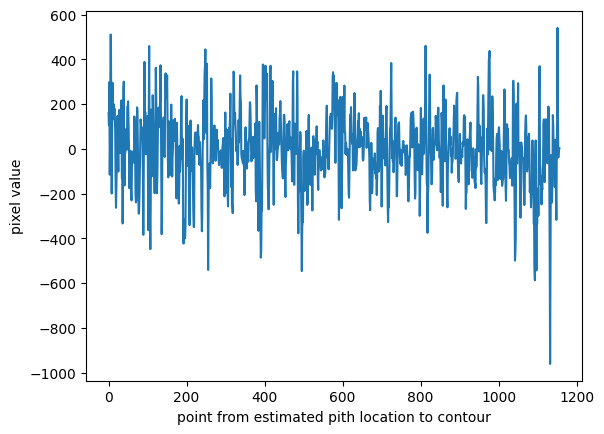

line length: 1156.557335721613, point: [ 577 2018]
inc count 208, dec count 216
peaks 188
good_count 145, bad_count 145


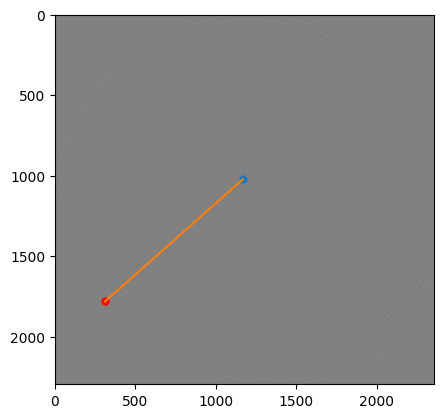

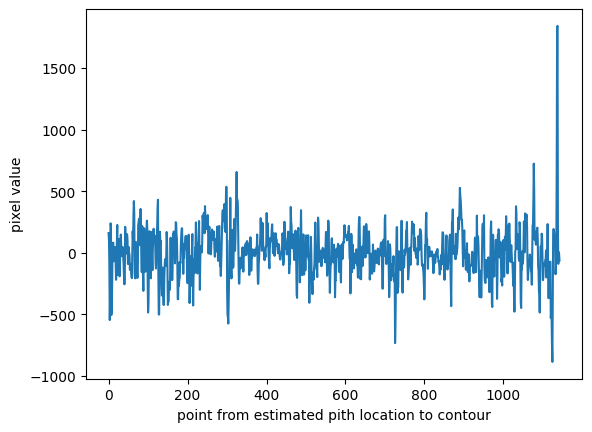

line length: 1142.8960691759066, point: [ 311 1781]
inc count 221, dec count 219
peaks 183
good_count 152, bad_count 153


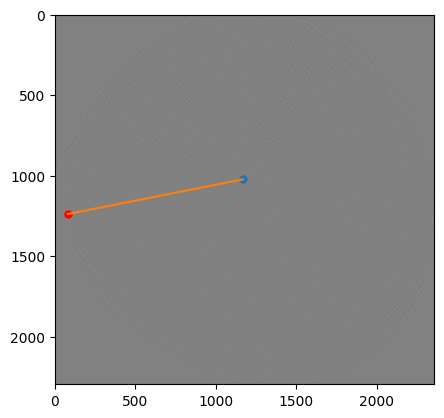

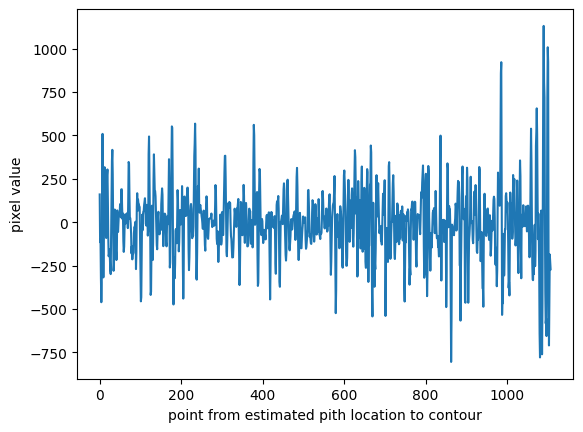

line length: 1107.2561036278953, point: [  80 1238]
inc count 211, dec count 211
peaks 165
good_count 122, bad_count 123


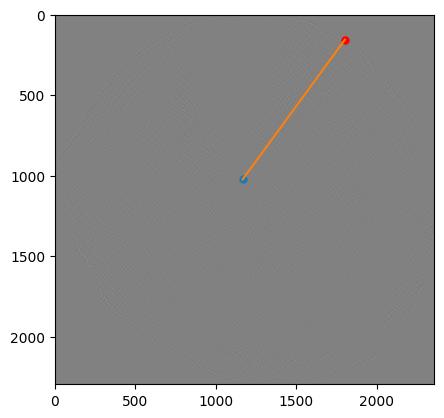

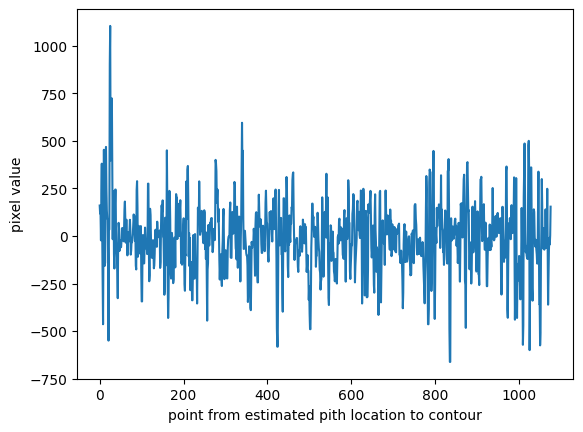

line length: 1075.1862884197183, point: [1801  155]
inc count 214, dec count 201
peaks 171
good_count 152, bad_count 151


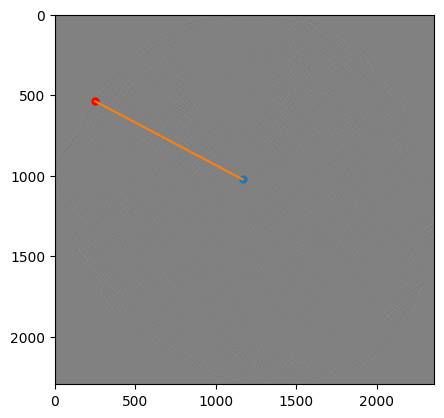

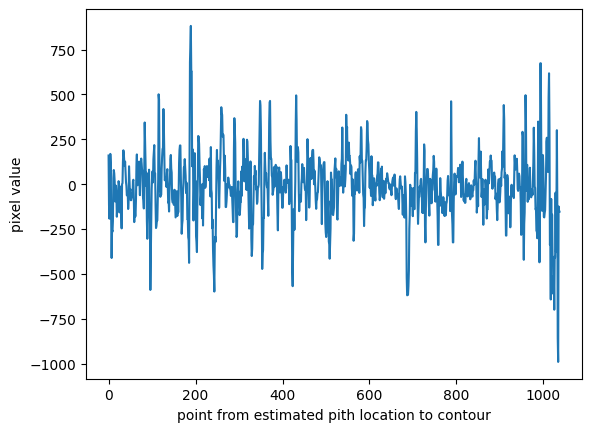

line length: 1037.817694670592, point: [249 537]
inc count 219, dec count 215
peaks 159
good_count 114, bad_count 114


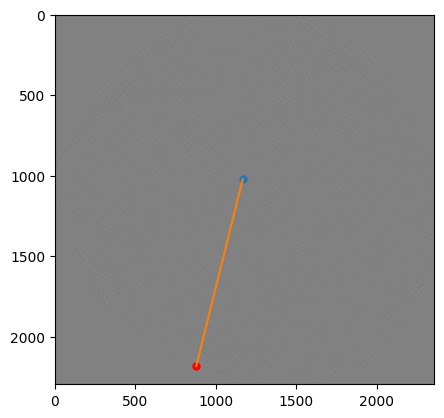

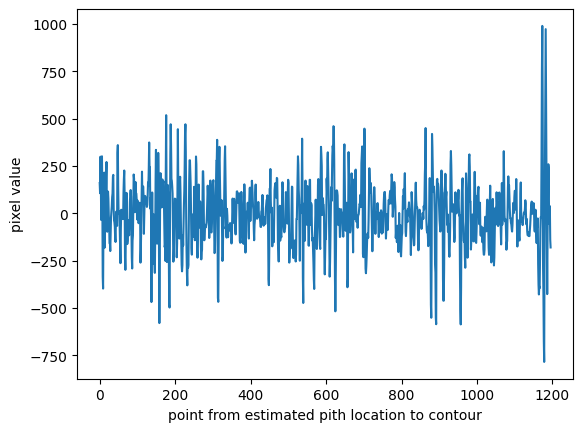

line length: 1195.5049864312255, point: [ 878 2183]
inc count 212, dec count 212
peaks 164
good_count 134, bad_count 134


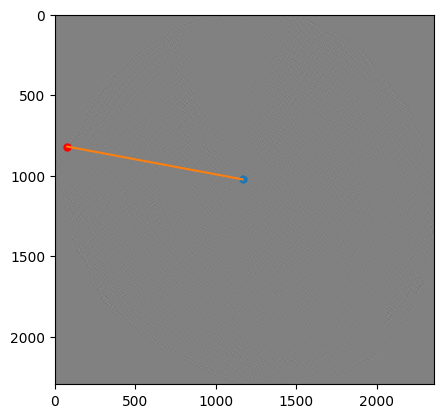

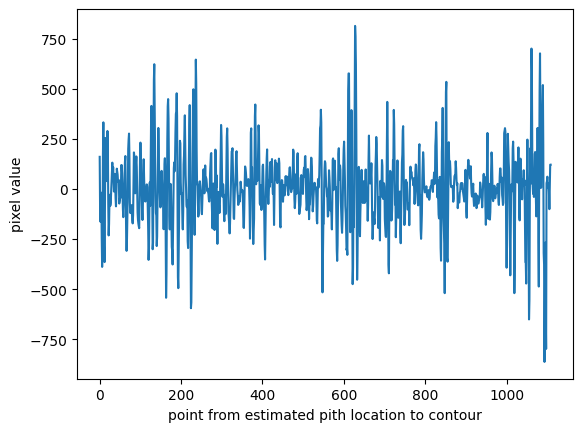

line length: 1108.0213260031448, point: [ 77 819]
inc count 189, dec count 191
peaks 162
good_count 116, bad_count 116


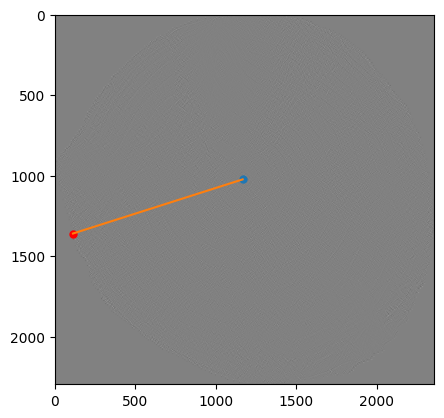

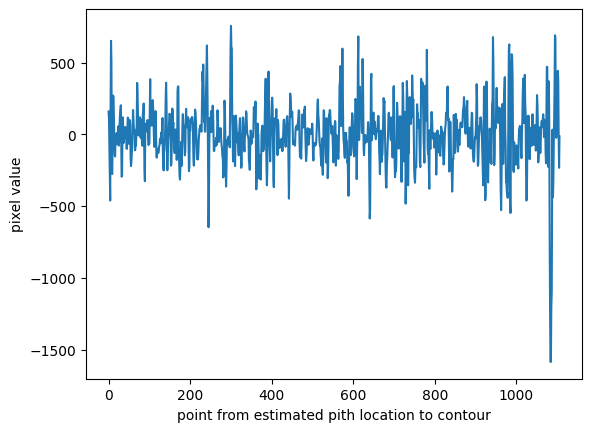

line length: 1106.4640907660162, point: [ 112 1359]
inc count 202, dec count 198
peaks 172
good_count 126, bad_count 127


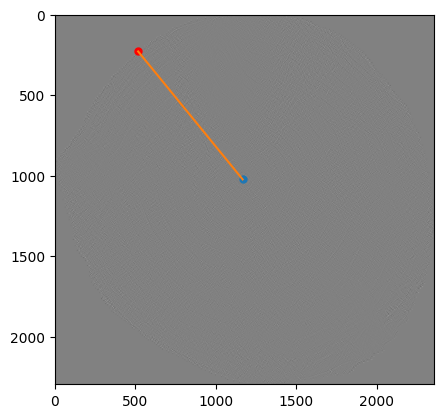

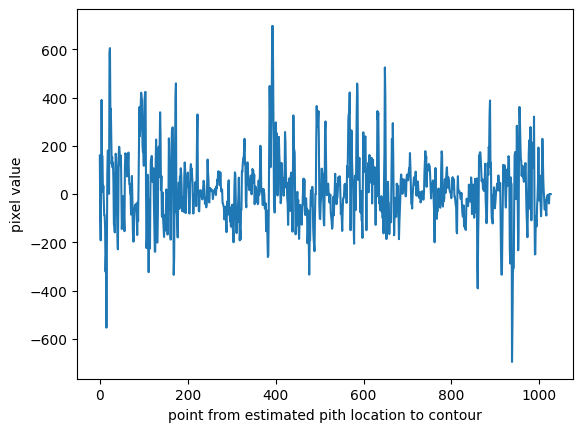

line length: 1026.145083000533, point: [517 228]
inc count 211, dec count 211
peaks 177
good_count 119, bad_count 119


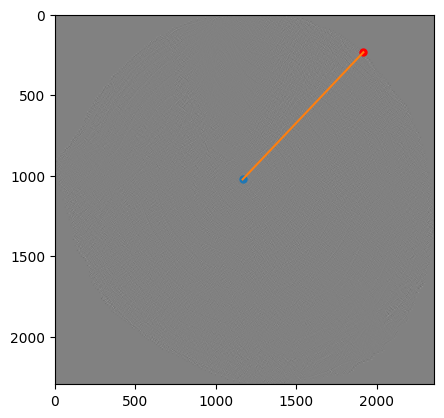

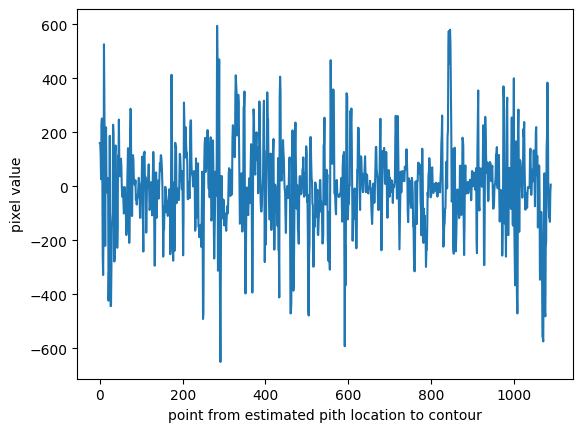

line length: 1089.0307712029062, point: [1916  233]
inc count 204, dec count 185
peaks 168
good_count 135, bad_count 135


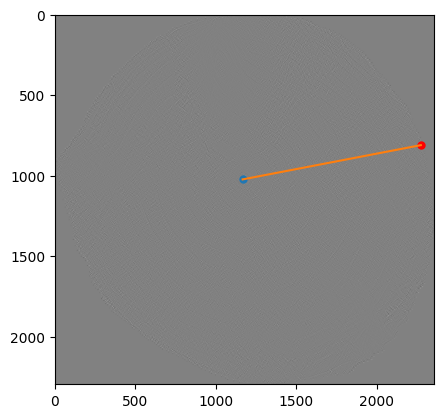

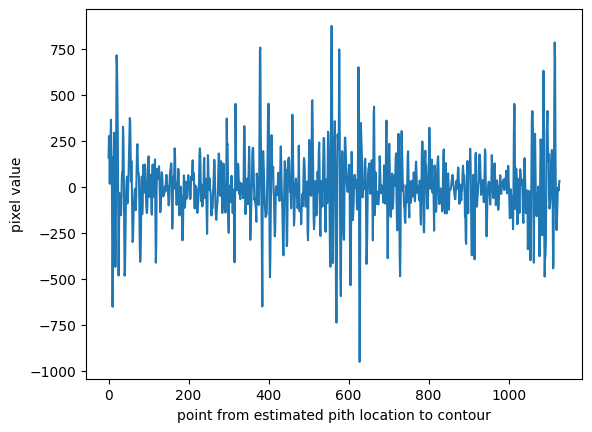

line length: 1127.1285254601169, point: [2273  810]
inc count 185, dec count 188
peaks 159
good_count 130, bad_count 129


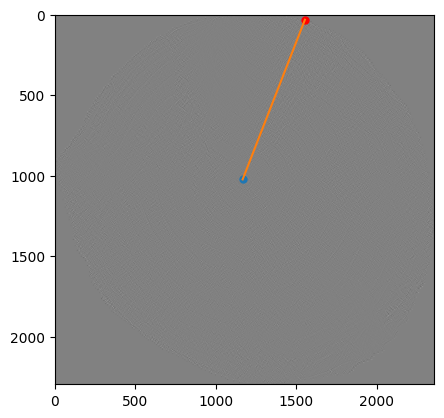

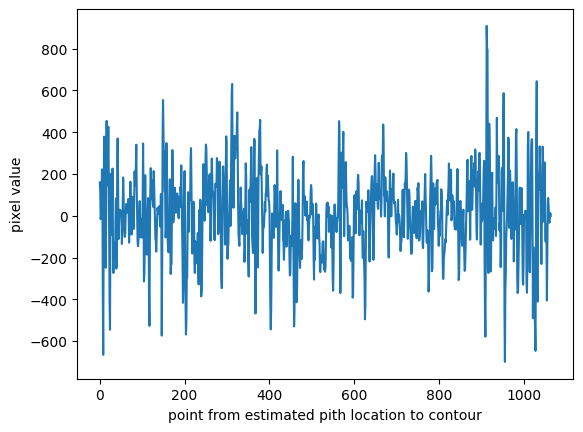

line length: 1064.5225264099636, point: [1553   31]
inc count 203, dec count 202
peaks 175
good_count 128, bad_count 128


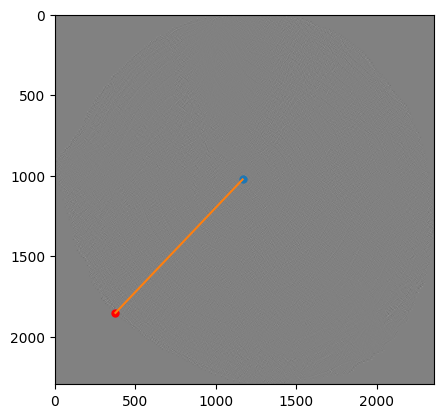

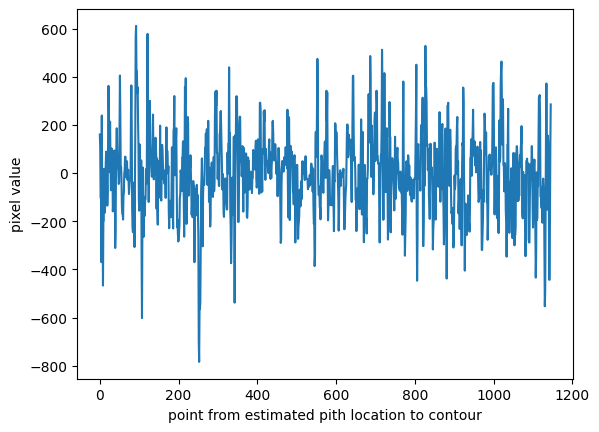

line length: 1145.4187614850032, point: [ 376 1852]
inc count 233, dec count 239
peaks 193
good_count 150, bad_count 151


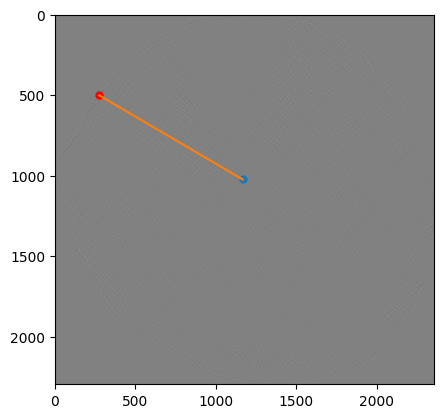

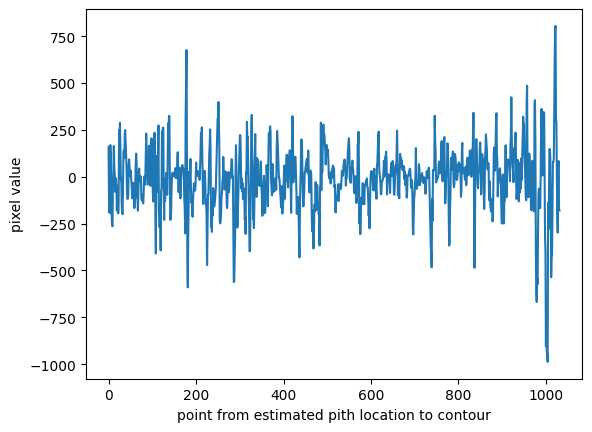

line length: 1031.764767146083, point: [276 501]
inc count 192, dec count 191
peaks 150
good_count 115, bad_count 115


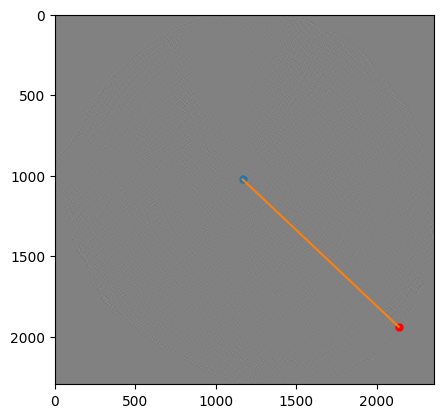

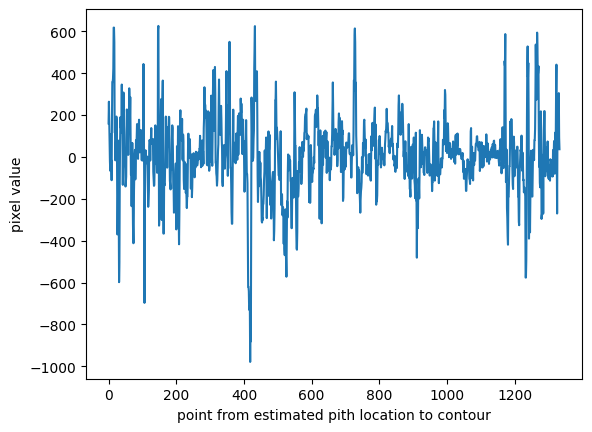

line length: 1332.823703041536, point: [2135 1938]
inc count 284, dec count 271
peaks 229
good_count 150, bad_count 149


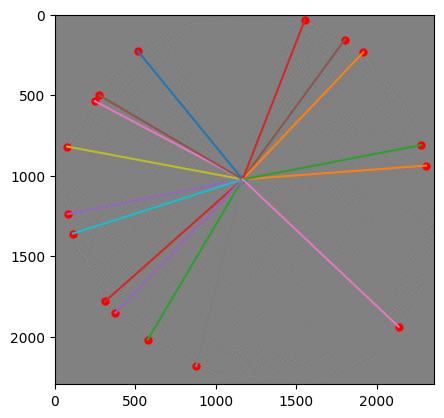

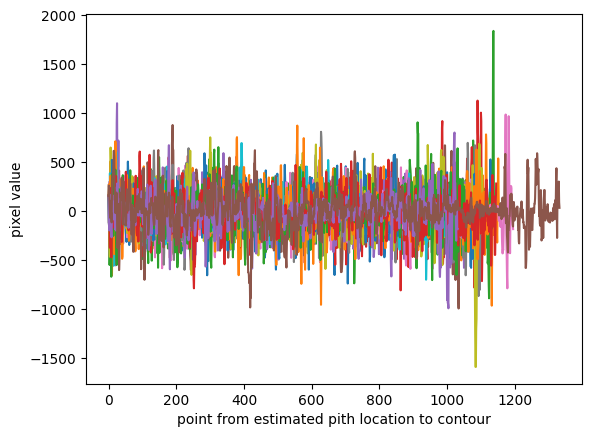

7 1-85fde97a518625ed46589a6be46300e36c3ad0d9_6626ee8bedc11ff89bd5a6205d10710e72ed9801_instant_210319.jpg


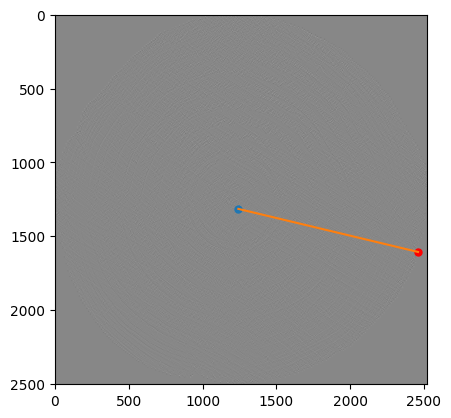

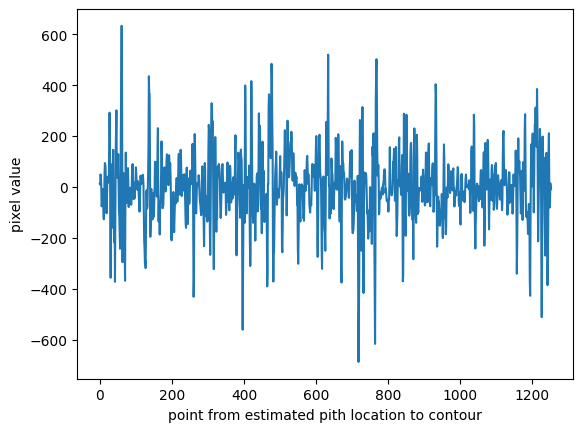

line length: 1251.9101382468857, point: [2460 1607]
inc count 234, dec count 240
peaks 176
good_count 143, bad_count 143


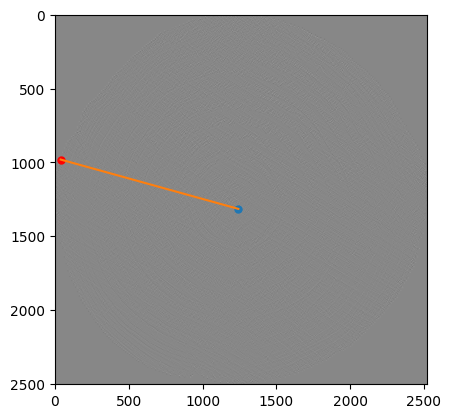

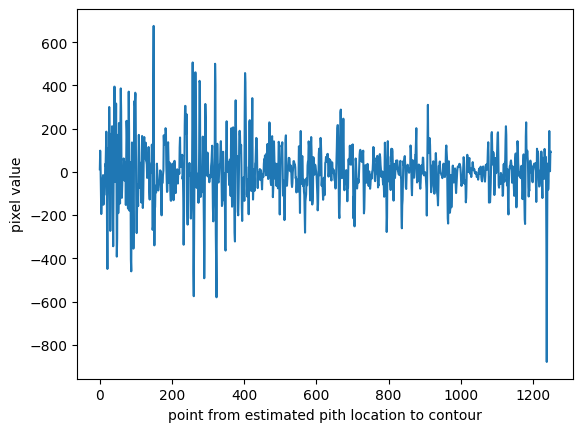

line length: 1249.109304707337, point: [ 39 981]
inc count 241, dec count 237
peaks 189
good_count 143, bad_count 143


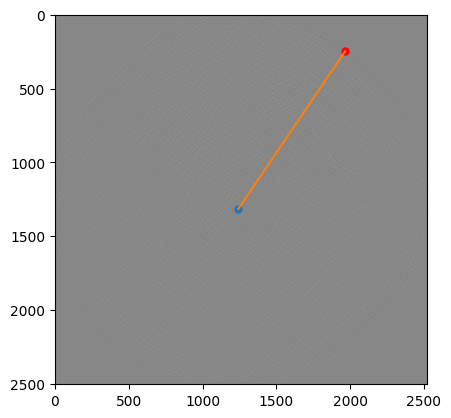

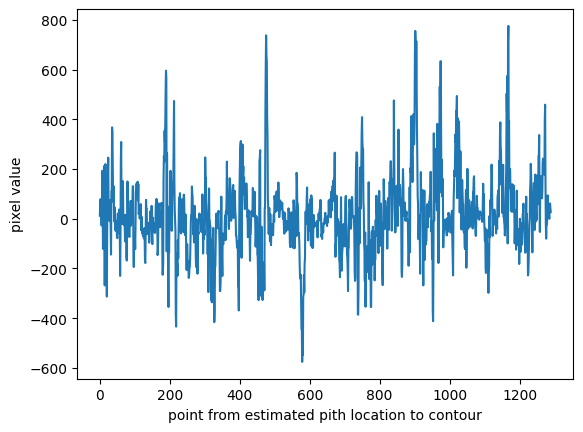

line length: 1289.284811525524, point: [1966  248]
inc count 284, dec count 285
peaks 218
good_count 155, bad_count 155


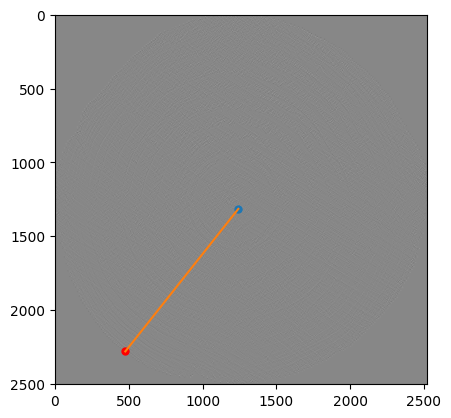

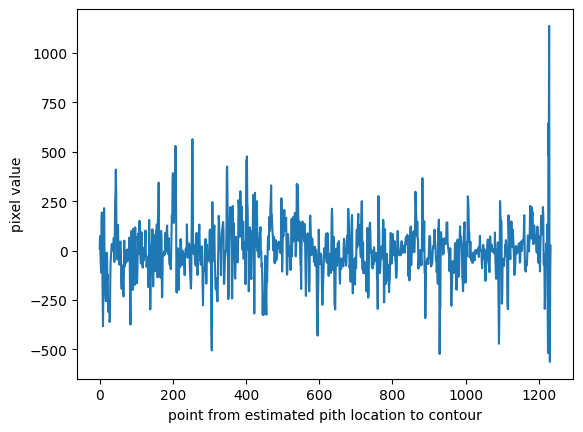

line length: 1232.4276924550918, point: [ 477 2281]
inc count 247, dec count 247
peaks 194
good_count 160, bad_count 160


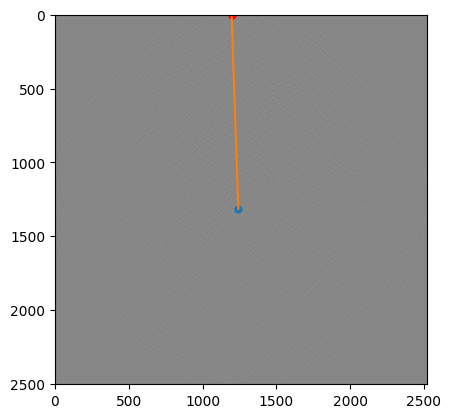

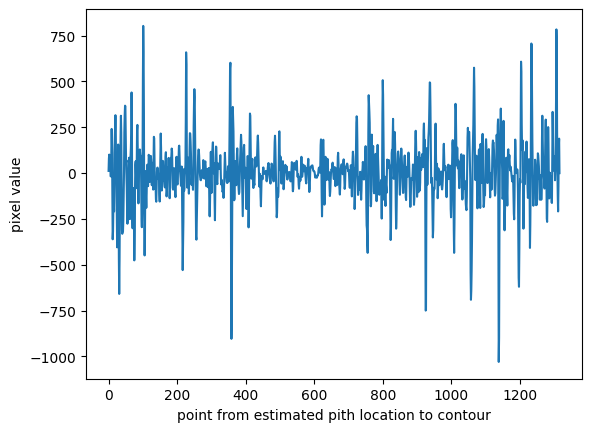

line length: 1315.9856679145728, point: [1197    0]
inc count 225, dec count 225
peaks 183
good_count 128, bad_count 128


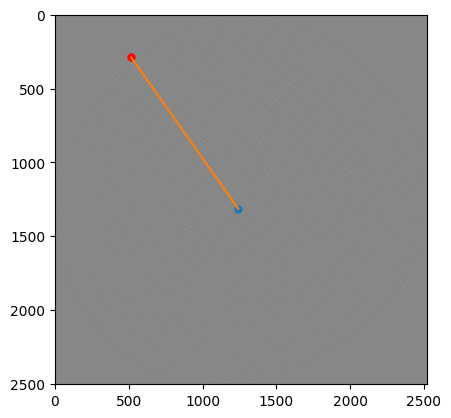

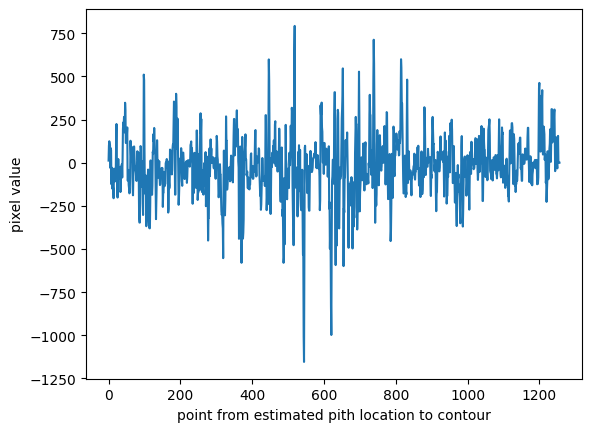

line length: 1256.7953079637084, point: [517 289]
inc count 263, dec count 251
peaks 194
good_count 156, bad_count 156


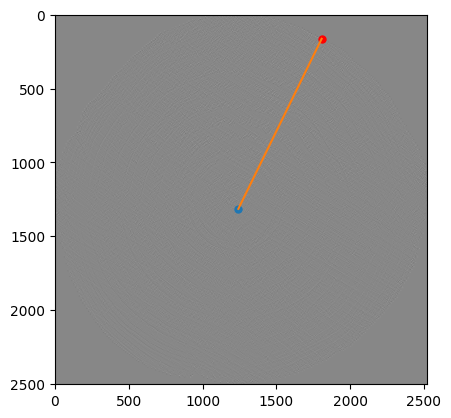

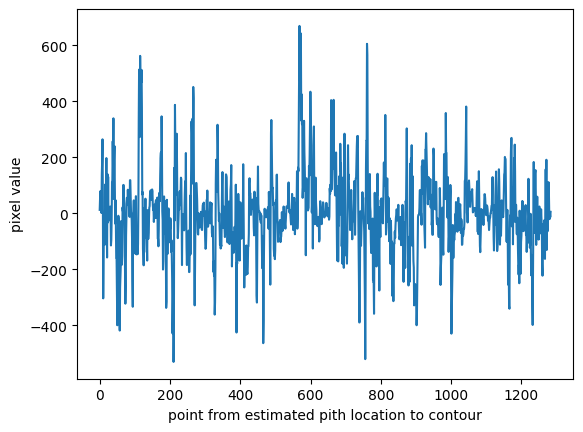

line length: 1283.0178375012472, point: [1807  163]
inc count 285, dec count 284
peaks 208
good_count 143, bad_count 143


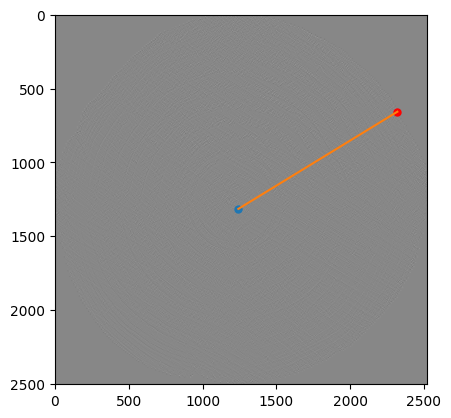

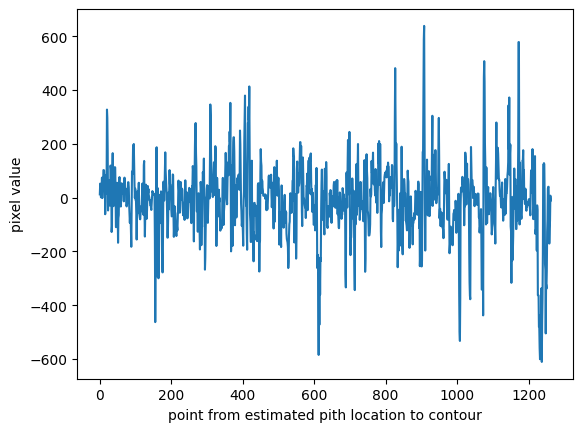

line length: 1262.5657836166615, point: [2320  657]
inc count 258, dec count 259
peaks 195
good_count 157, bad_count 157


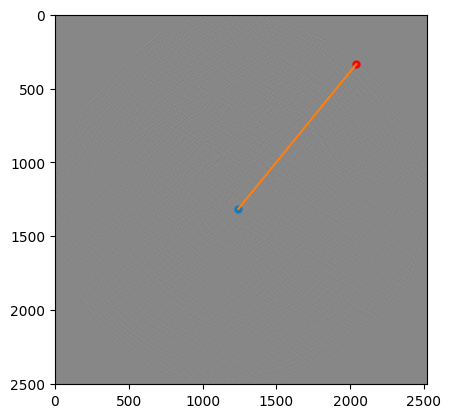

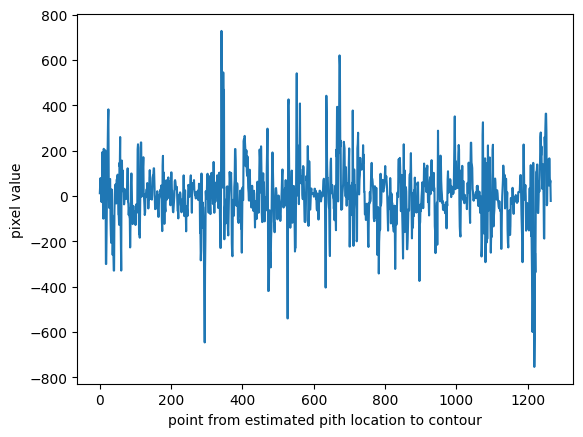

line length: 1265.634436982111, point: [2042  334]
inc count 259, dec count 261
peaks 213
good_count 146, bad_count 146


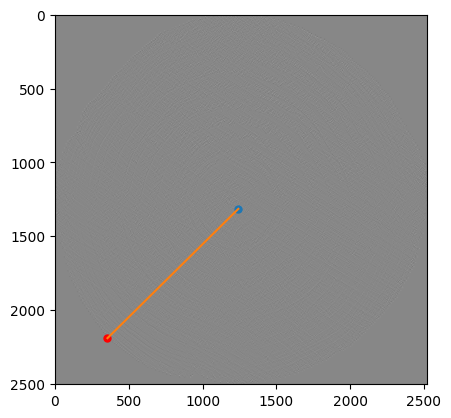

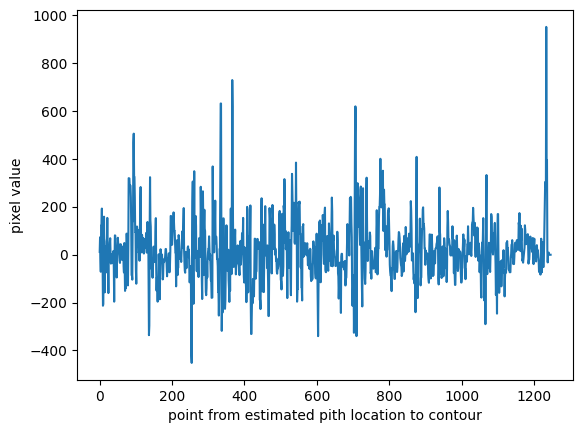

line length: 1246.2114241319443, point: [ 356 2191]
inc count 241, dec count 237
peaks 208
good_count 159, bad_count 159


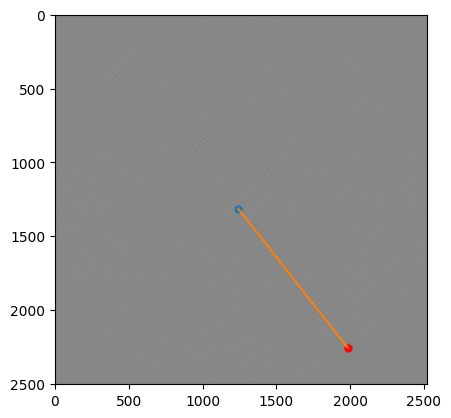

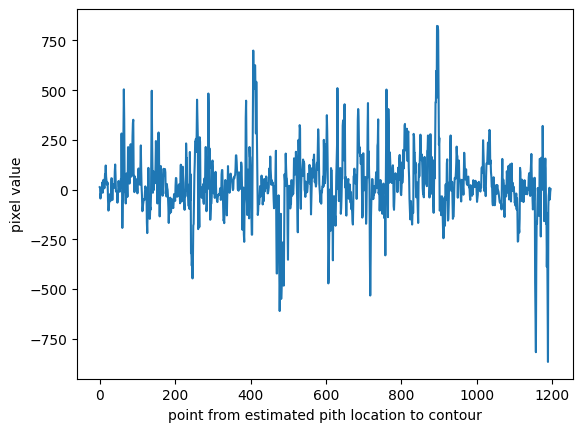

line length: 1196.4379366992807, point: [1983 2255]
inc count 244, dec count 245
peaks 209
good_count 149, bad_count 149


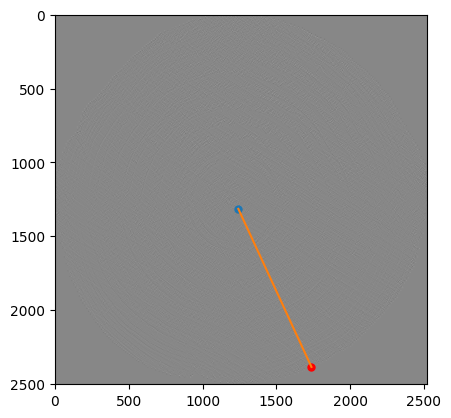

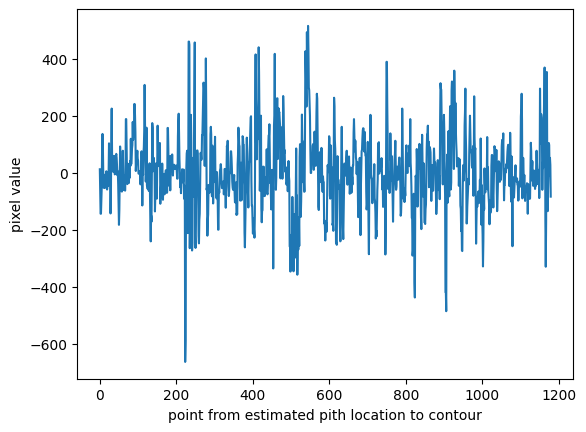

line length: 1179.8596692058886, point: [1738 2386]
inc count 238, dec count 248
peaks 180
good_count 138, bad_count 138


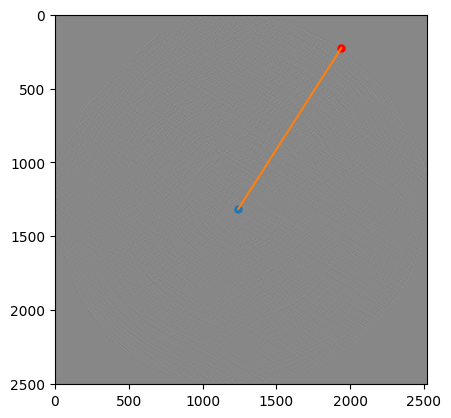

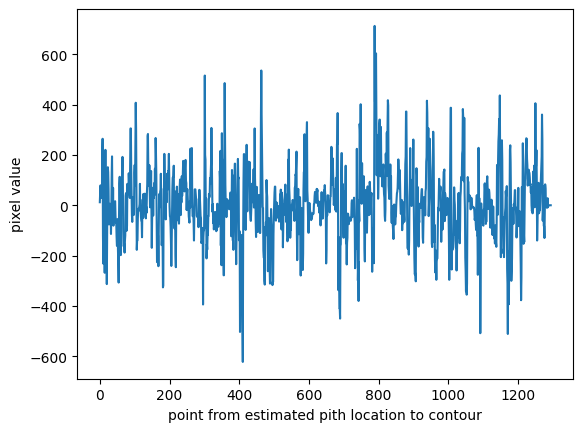

line length: 1294.1920758180154, point: [1940  225]
inc count 265, dec count 276
peaks 204
good_count 149, bad_count 149


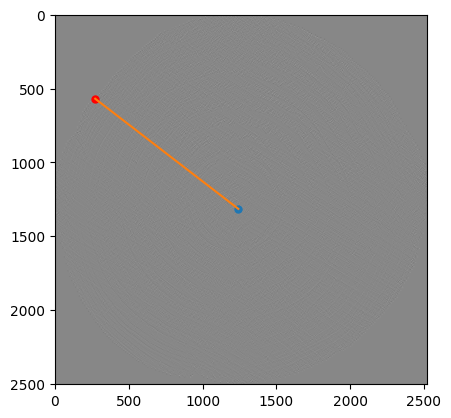

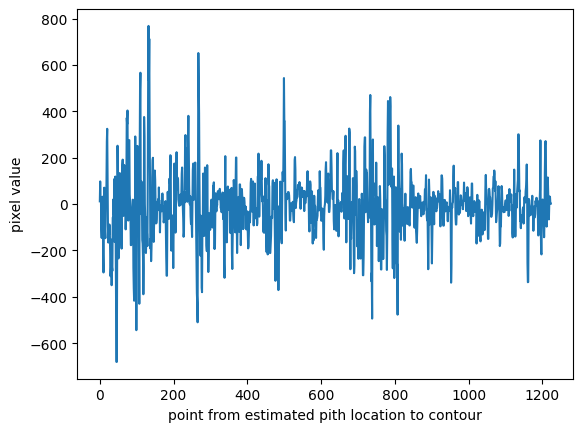

line length: 1223.4704301065733, point: [273 569]
inc count 241, dec count 234
peaks 193
good_count 162, bad_count 163


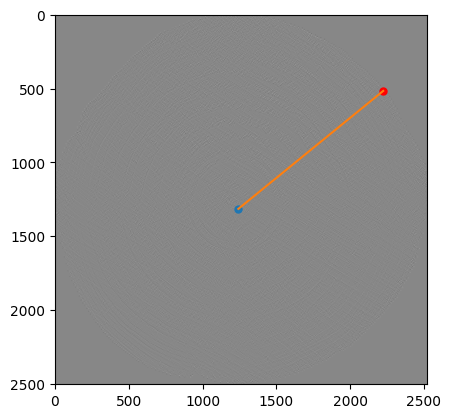

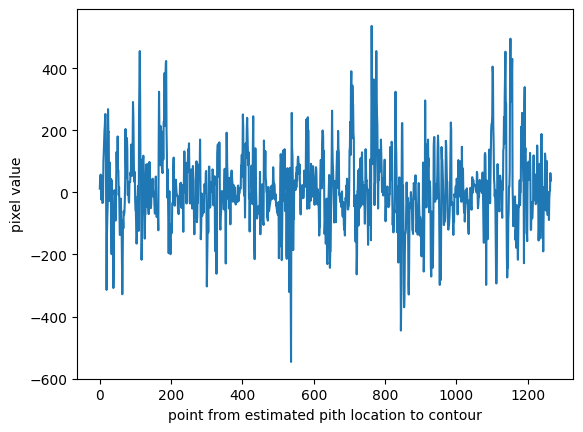

line length: 1265.6676714260893, point: [2224  516]
inc count 249, dec count 252
peaks 204
good_count 147, bad_count 146


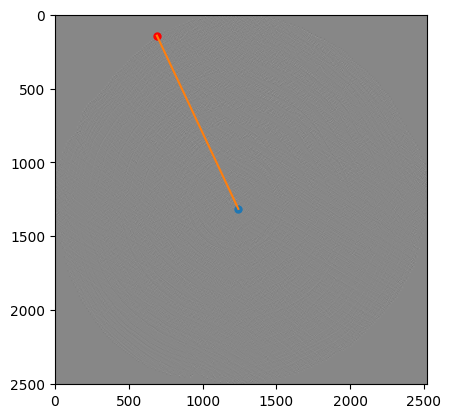

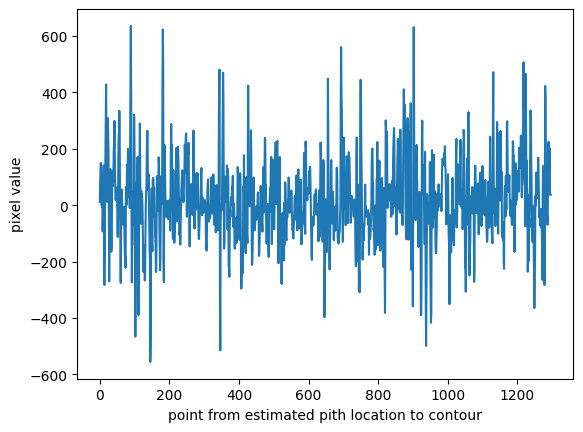

line length: 1296.388031088708, point: [691 142]
inc count 260, dec count 241
peaks 219
good_count 157, bad_count 157


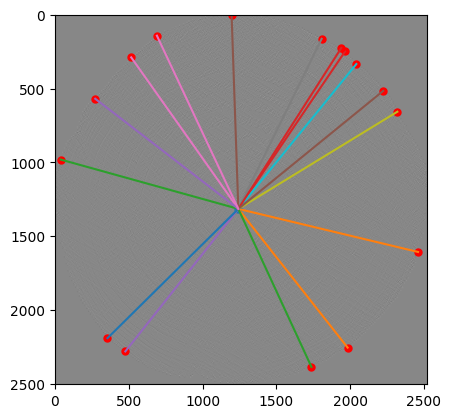

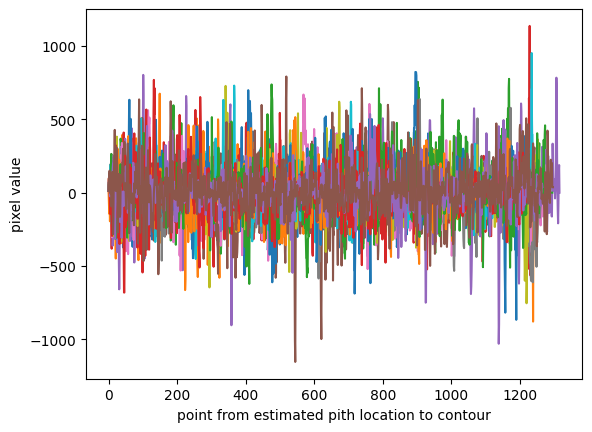

8 1-e50b5a99fd9bab50130099c750df6d80f50a9b4e_fdafeaf4b1ec0417f969870e07a0d6401488df85_instant.jpg


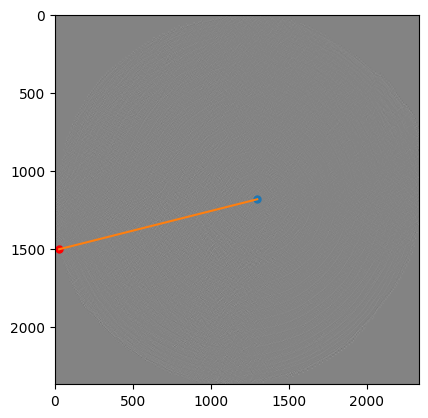

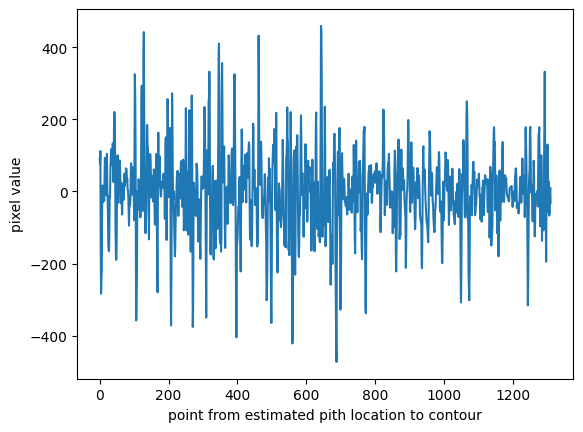

line length: 1309.508147692709, point: [  27 1503]
inc count 230, dec count 239
peaks 187
good_count 125, bad_count 126


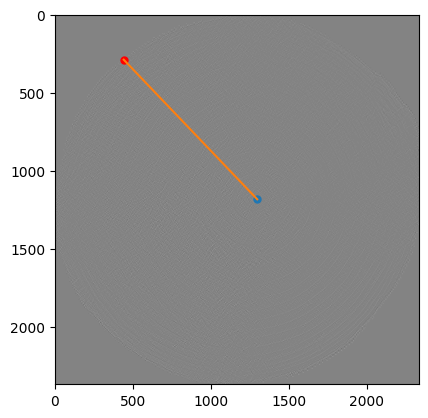

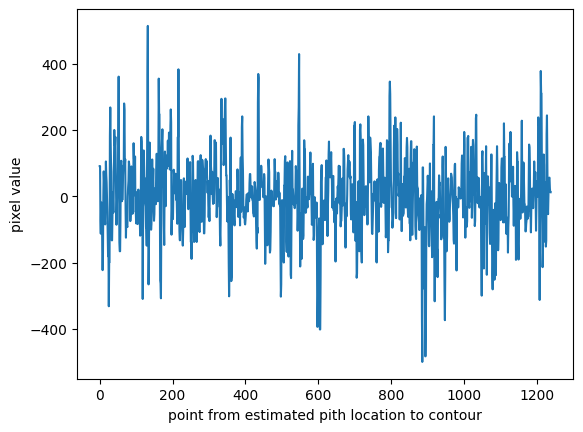

line length: 1238.0912983493295, point: [441 288]
inc count 229, dec count 232
peaks 189
good_count 161, bad_count 161


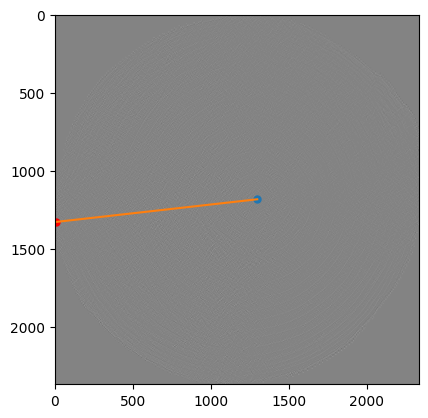

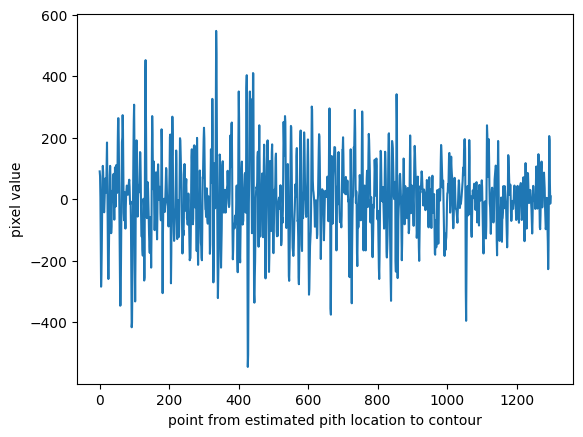

line length: 1298.8911885241123, point: [   6 1328]
inc count 208, dec count 210
peaks 174
good_count 126, bad_count 126


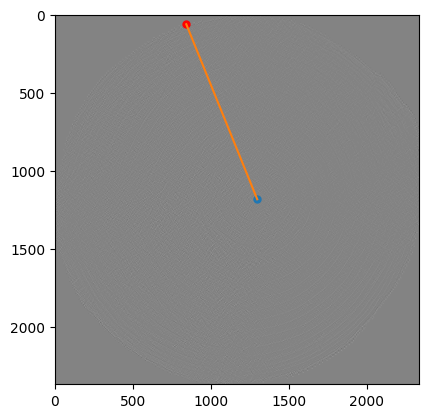

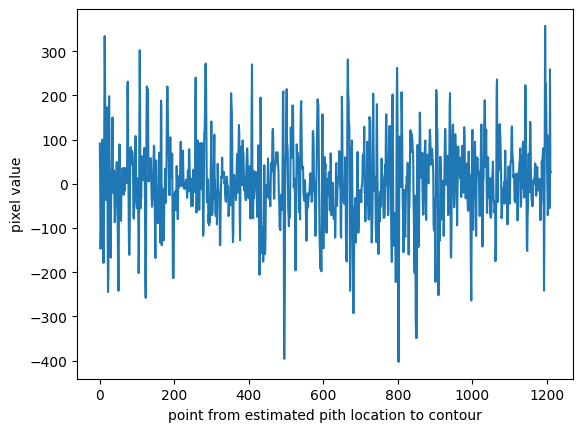

line length: 1210.416708472735, point: [842  61]
inc count 217, dec count 216
peaks 174
good_count 134, bad_count 134


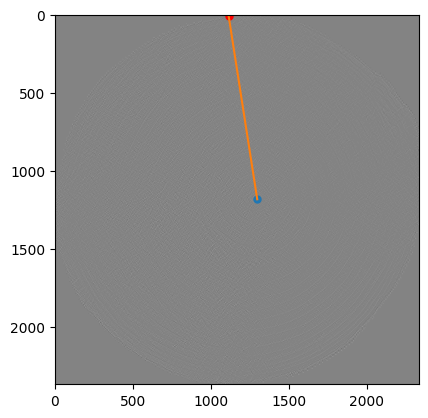

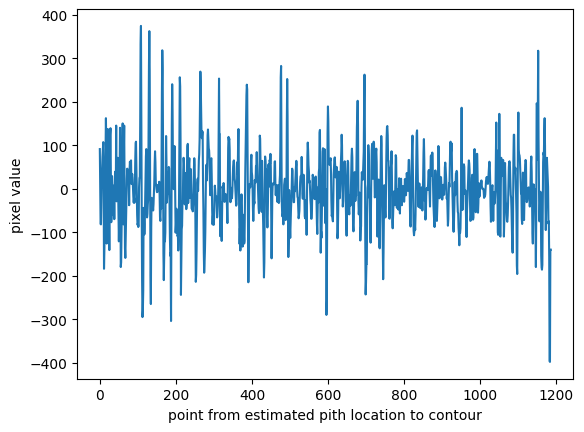

line length: 1185.9117233864422, point: [1114   11]
inc count 205, dec count 207
peaks 142
good_count 110, bad_count 111


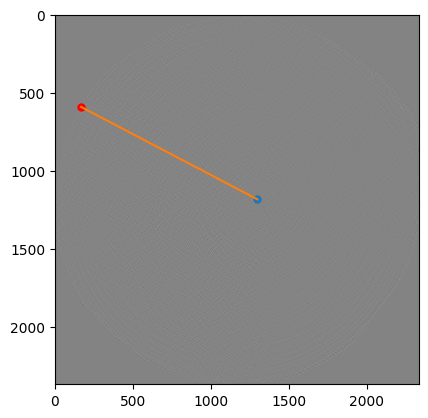

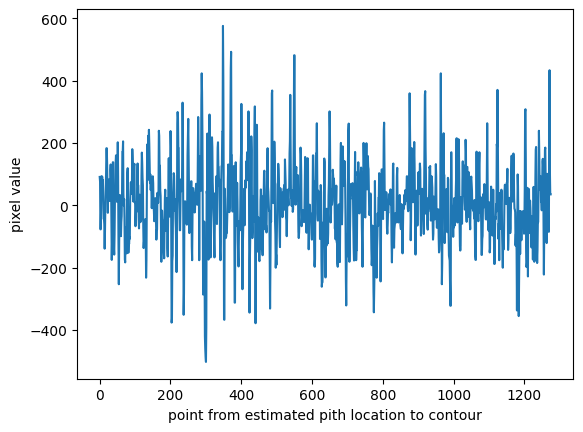

line length: 1274.4518470031296, point: [168 591]
inc count 244, dec count 237
peaks 198
good_count 145, bad_count 144


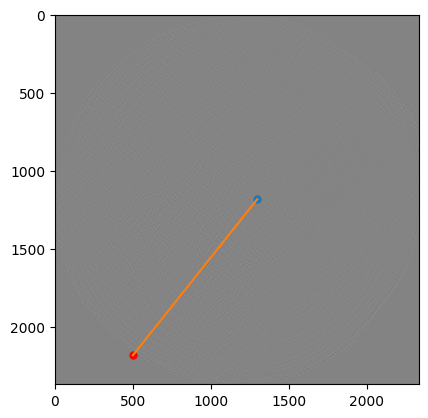

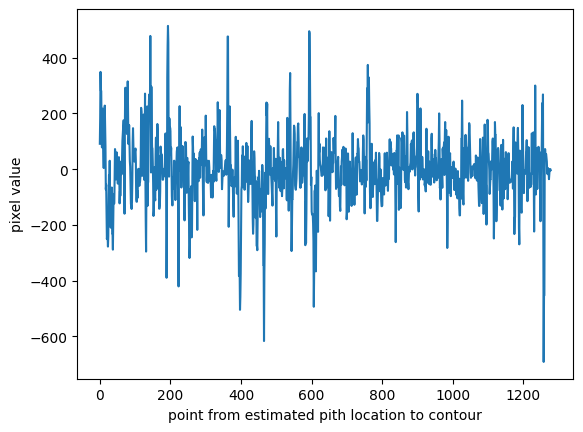

line length: 1278.0091000856478, point: [ 500 2182]
inc count 250, dec count 251
peaks 206
good_count 168, bad_count 168


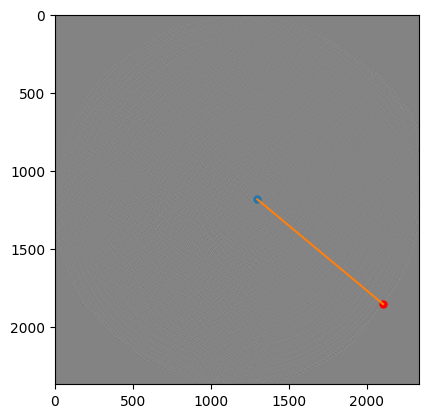

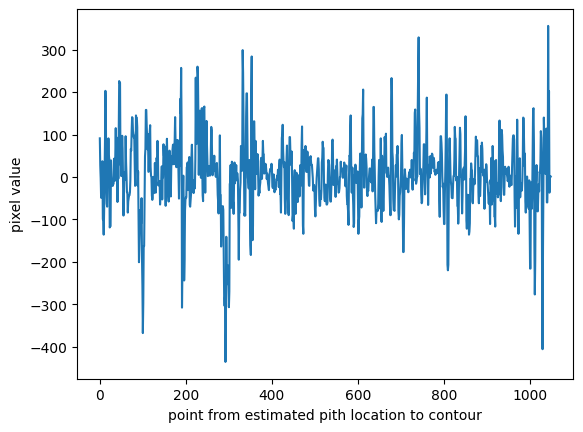

line length: 1049.1088080291076, point: [2103 1854]
inc count 193, dec count 195
peaks 165
good_count 108, bad_count 109


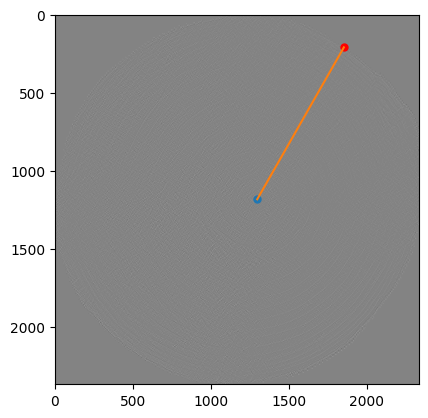

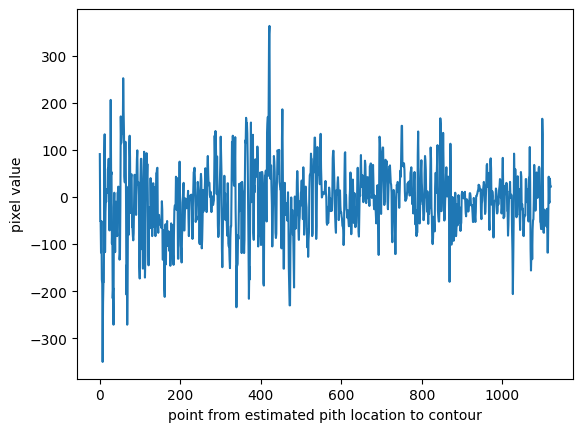

line length: 1120.9338563747497, point: [1852  209]
inc count 205, dec count 210
peaks 146
good_count 115, bad_count 115


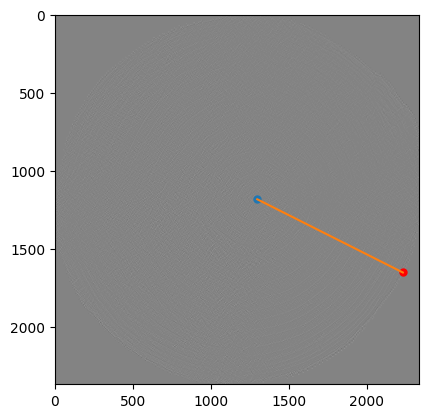

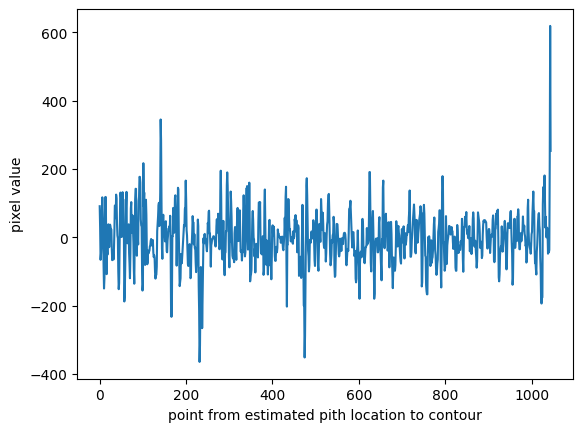

line length: 1044.588512033419, point: [2230 1652]
inc count 174, dec count 182
peaks 136
good_count 108, bad_count 107


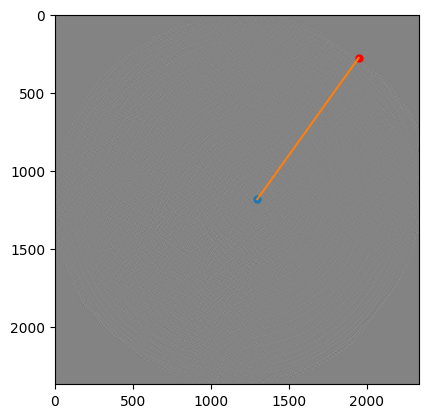

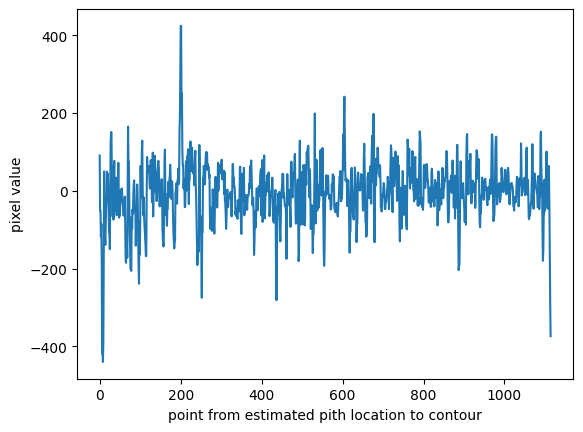

line length: 1114.4107161131378, point: [1946  277]
inc count 218, dec count 217
peaks 176
good_count 124, bad_count 125


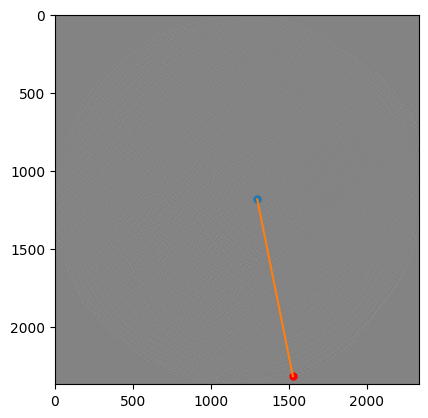

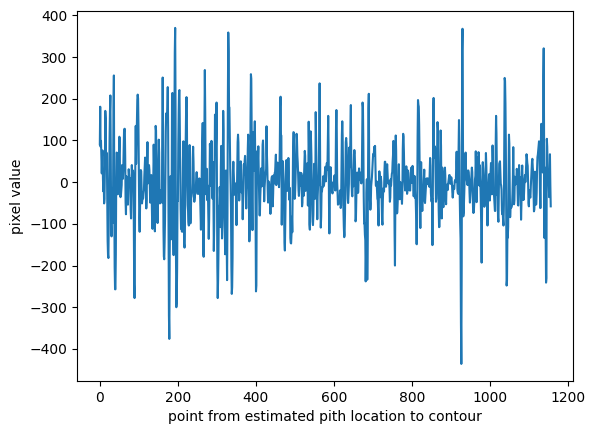

line length: 1156.011662046948, point: [1525 2316]
inc count 197, dec count 195
peaks 156
good_count 129, bad_count 129


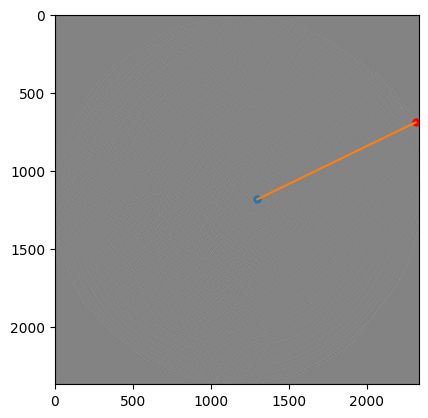

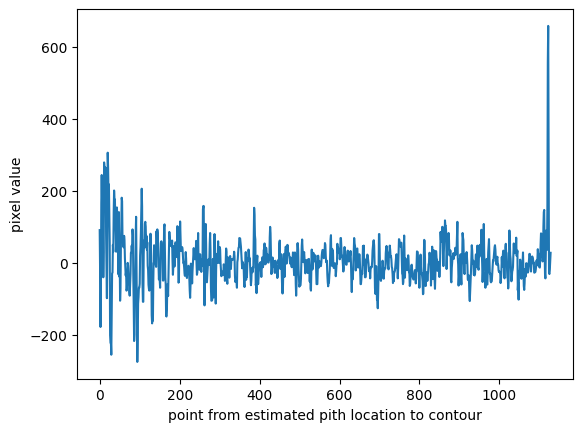

line length: 1128.5143223610055, point: [2312  690]
inc count 207, dec count 197
peaks 158
good_count 91, bad_count 91


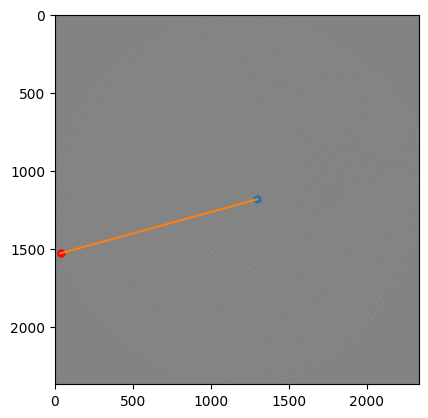

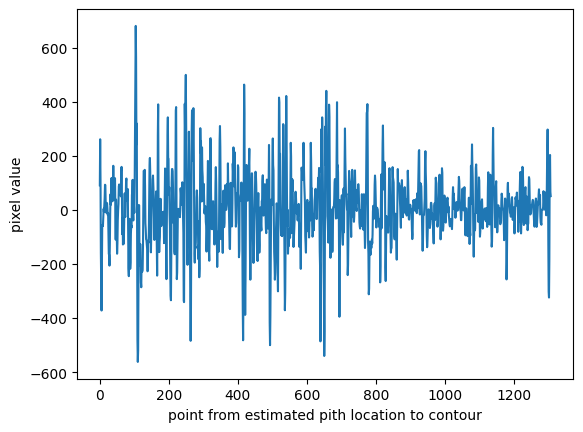

line length: 1307.4273779946834, point: [  36 1529]
inc count 235, dec count 241
peaks 188
good_count 141, bad_count 141


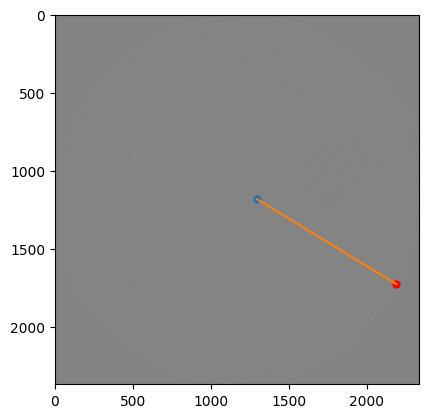

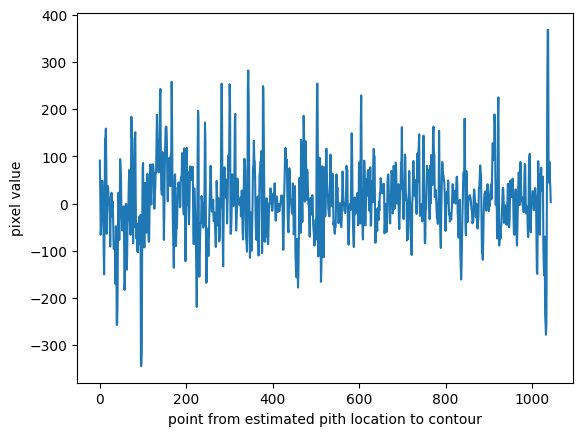

line length: 1043.7725228090549, point: [2188 1726]
inc count 181, dec count 186
peaks 153
good_count 114, bad_count 115


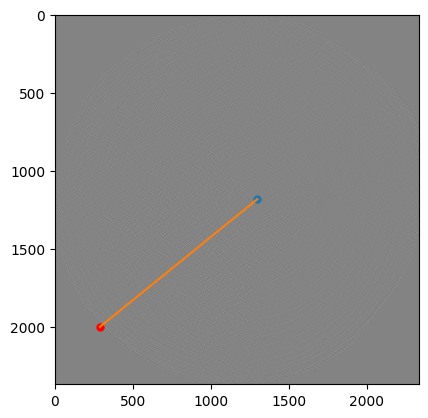

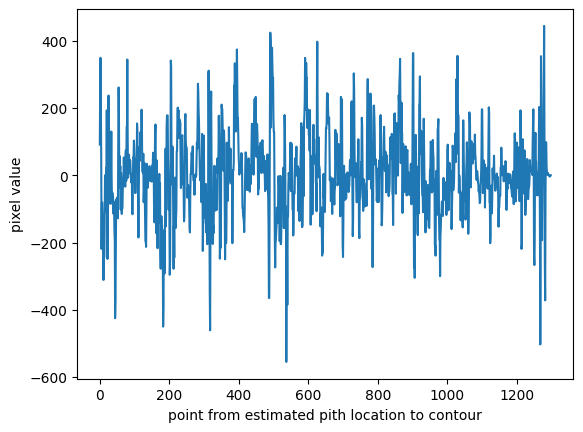

line length: 1297.4783800594926, point: [ 289 2000]
inc count 251, dec count 261
peaks 201
good_count 152, bad_count 152


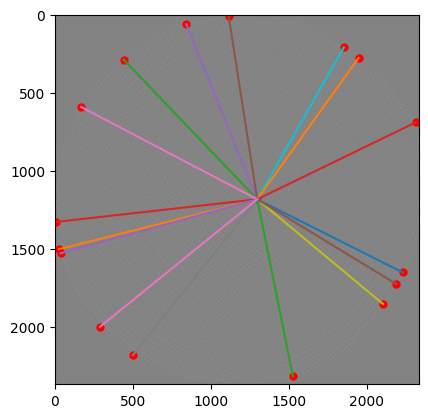

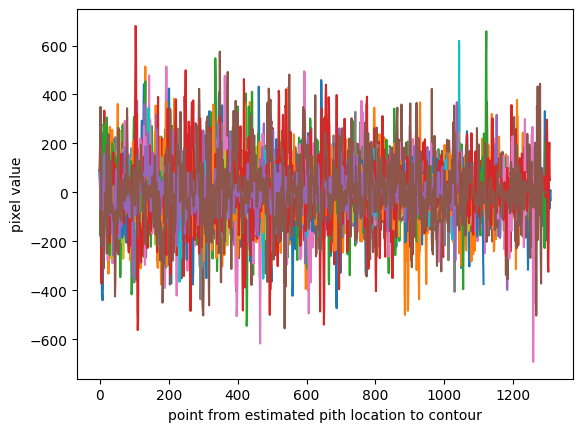

9 1-0d8eabdfed2cb1f0d455e5a2050d78ba39ae6cff_0665c9464c856662322717999ae3d8301ff48907_instant.jpg


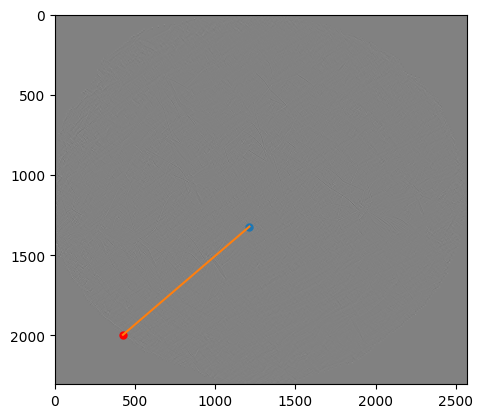

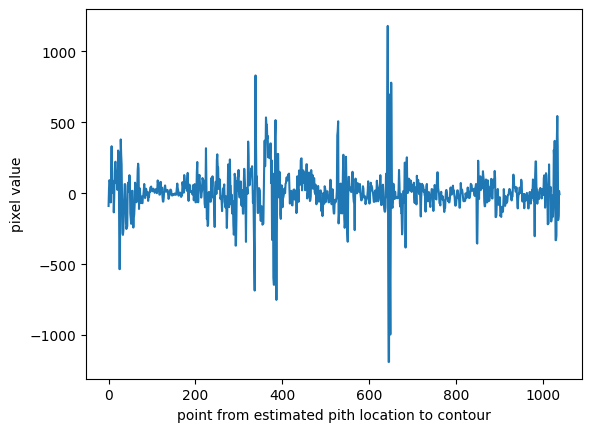

line length: 1038.3376887597922, point: [ 424 1996]
inc count 200, dec count 193
peaks 179
good_count 135, bad_count 134


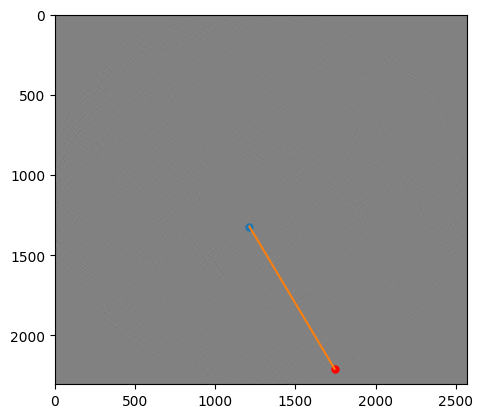

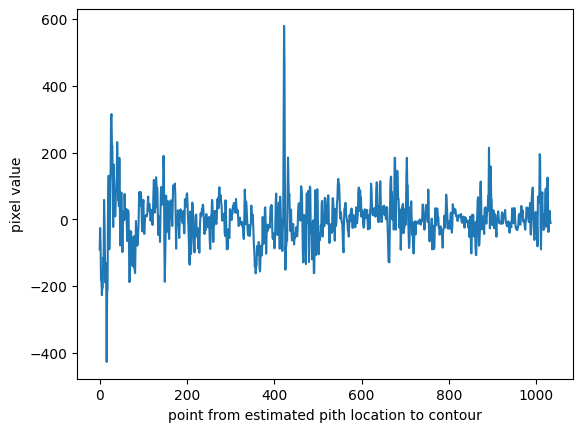

line length: 1033.8754087070633, point: [1744 2208]
inc count 203, dec count 209
peaks 146
good_count 108, bad_count 109


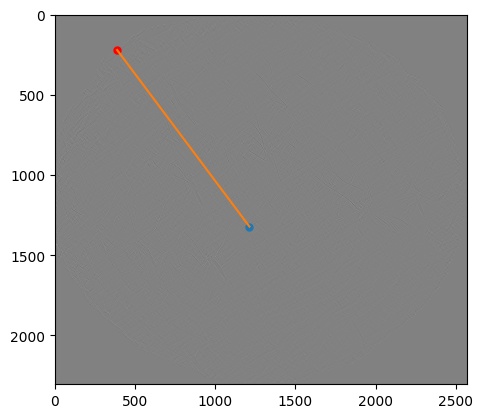

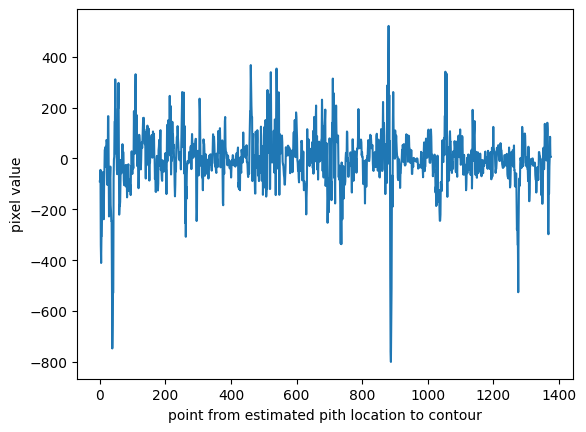

line length: 1375.7176685530394, point: [388 220]
inc count 261, dec count 272
peaks 207
good_count 175, bad_count 175


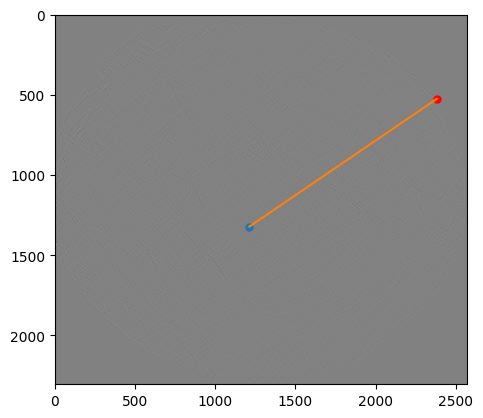

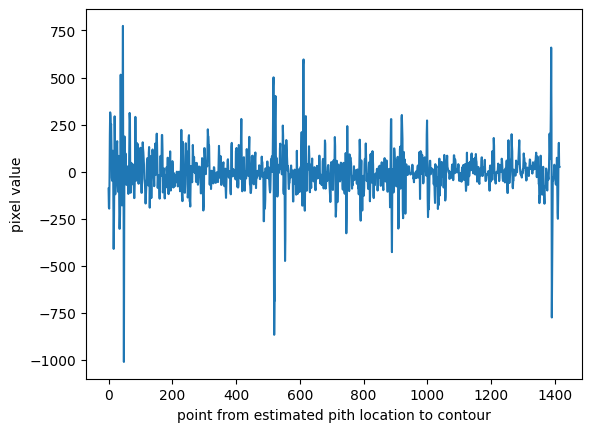

line length: 1414.8486395647574, point: [2382  524]
inc count 277, dec count 266
peaks 219
good_count 173, bad_count 173


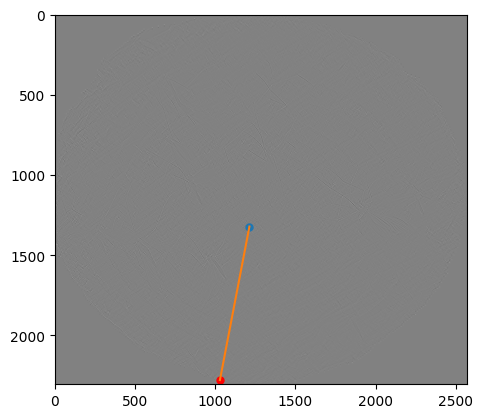

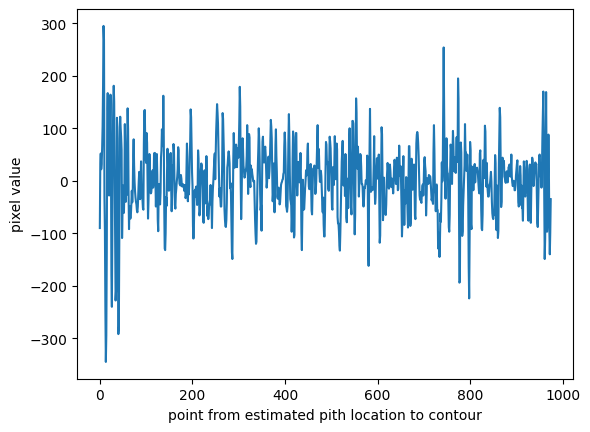

line length: 974.5793087405704, point: [1029 2278]
inc count 177, dec count 174
peaks 141
good_count 95, bad_count 95


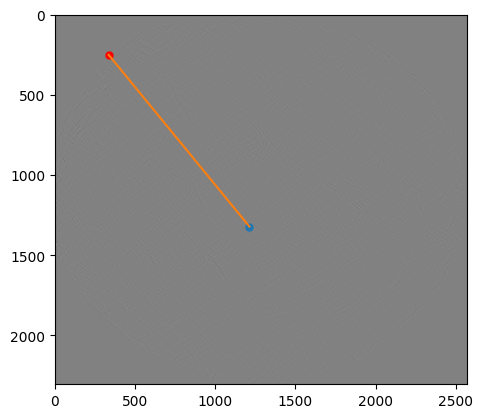

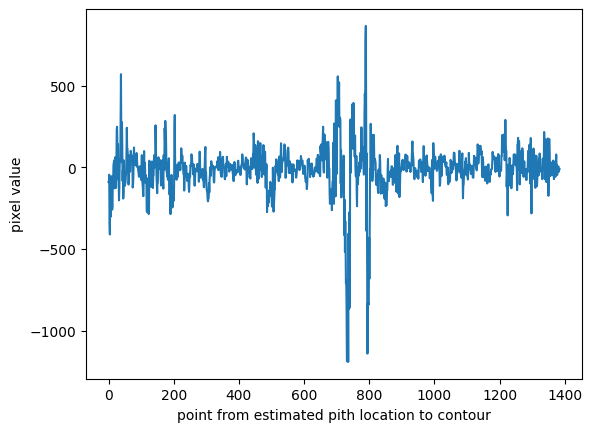

line length: 1384.8090580448345, point: [335 250]
inc count 293, dec count 297
peaks 215
good_count 178, bad_count 179


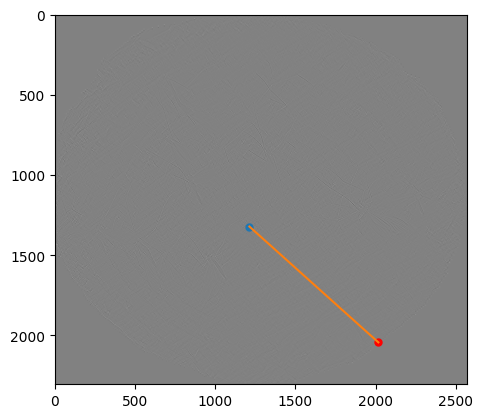

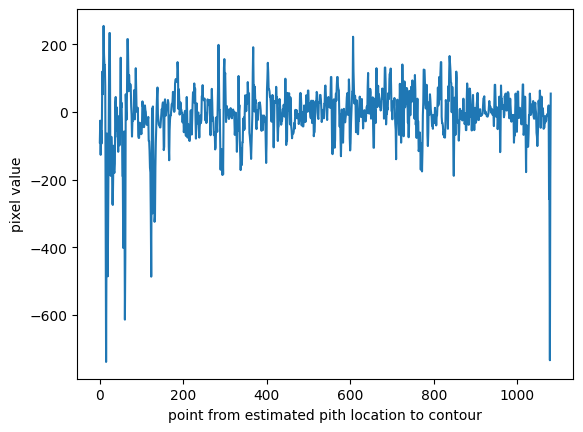

line length: 1080.6836867286872, point: [2017 2043]
inc count 211, dec count 218
peaks 152
good_count 105, bad_count 106


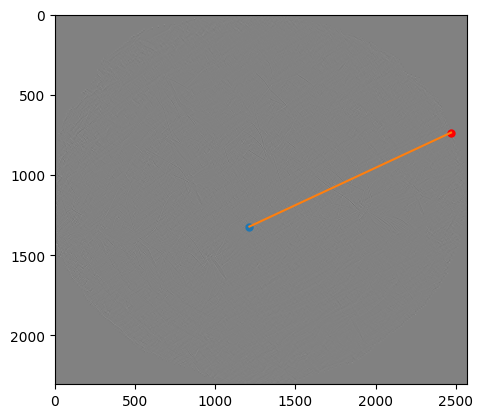

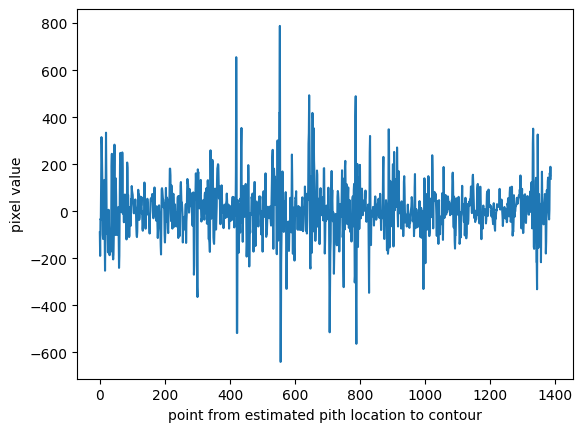

line length: 1386.9057572054146, point: [2470  735]
inc count 273, dec count 280
peaks 232
good_count 182, bad_count 181


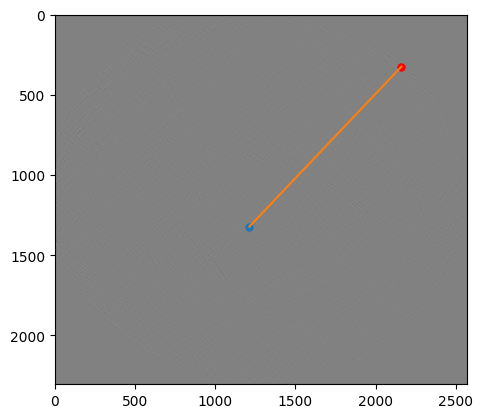

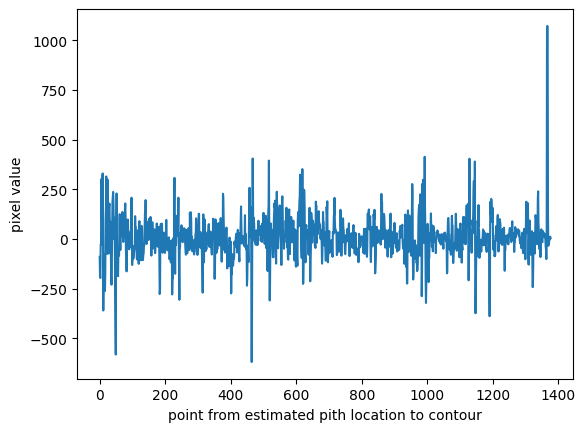

line length: 1376.4758045950061, point: [2161  323]
inc count 278, dec count 286
peaks 244
good_count 183, bad_count 184


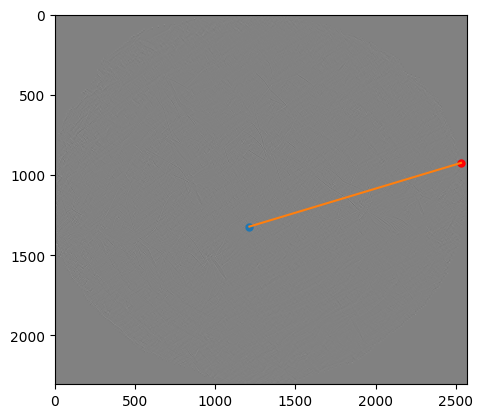

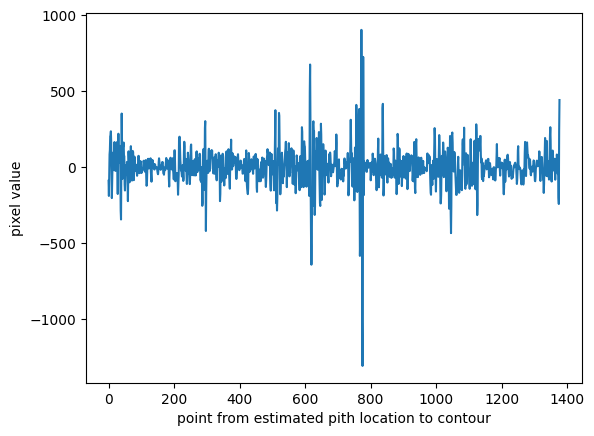

line length: 1377.484273374193, point: [2532  924]
inc count 267, dec count 265
peaks 221
good_count 168, bad_count 167


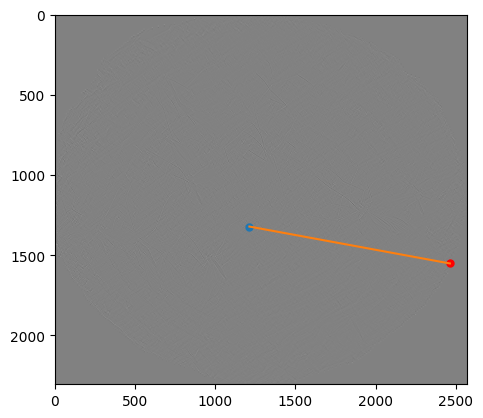

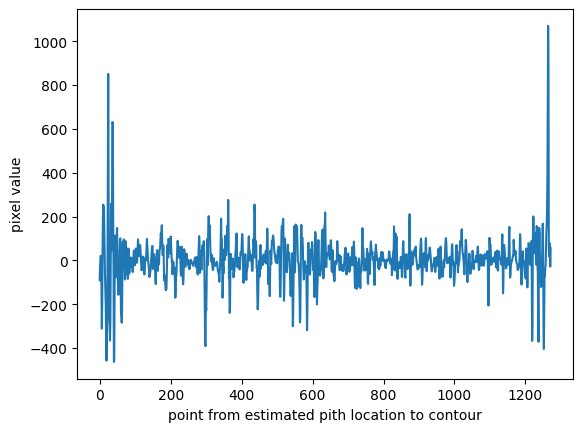

line length: 1271.0483455133303, point: [2463 1551]
inc count 239, dec count 233
peaks 177
good_count 115, bad_count 116


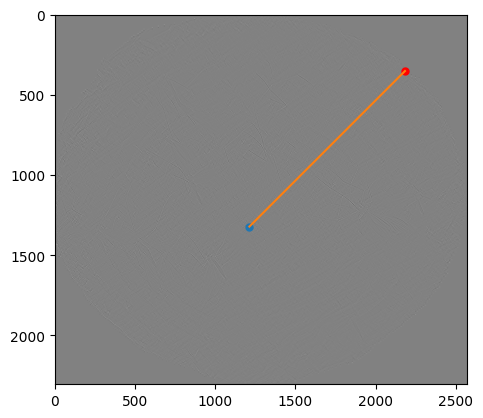

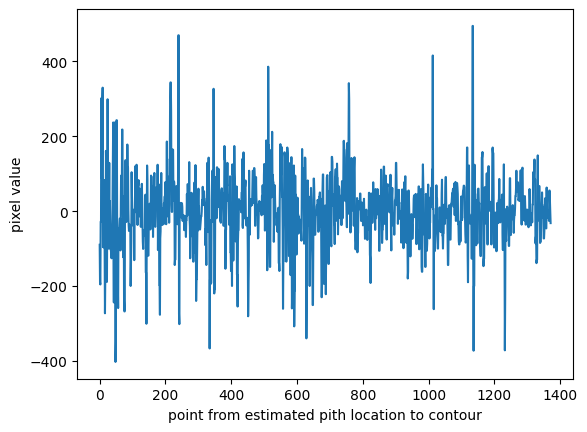

line length: 1371.7811491874215, point: [2183  351]
inc count 194, dec count 186
peaks 218
good_count 185, bad_count 186


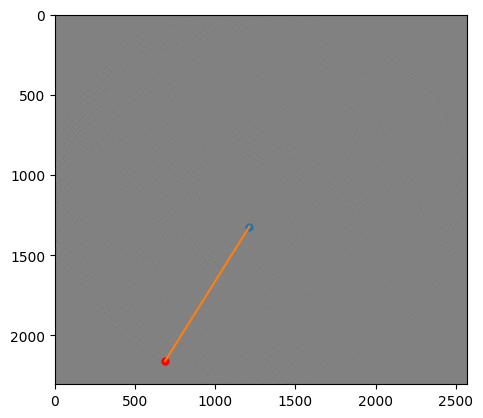

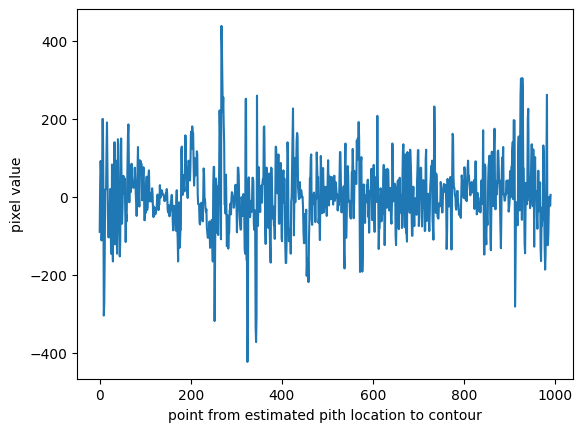

line length: 990.2752646545998, point: [ 687 2160]
inc count 205, dec count 203
peaks 159
good_count 121, bad_count 121


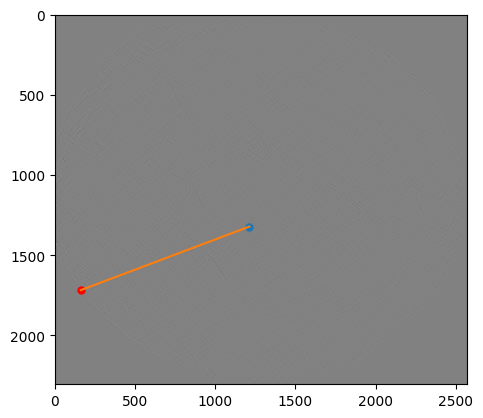

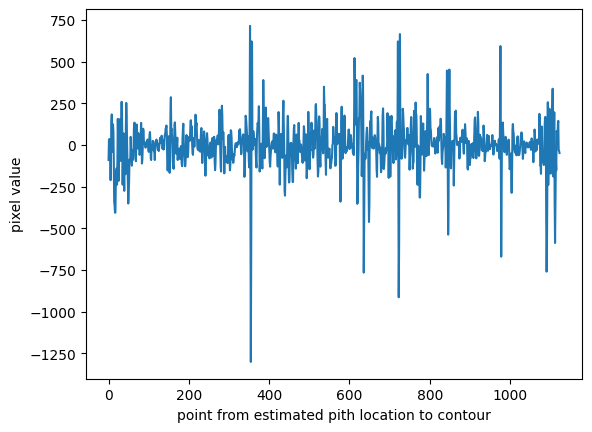

line length: 1123.099699353354, point: [ 162 1717]
inc count 216, dec count 222
peaks 184
good_count 150, bad_count 151


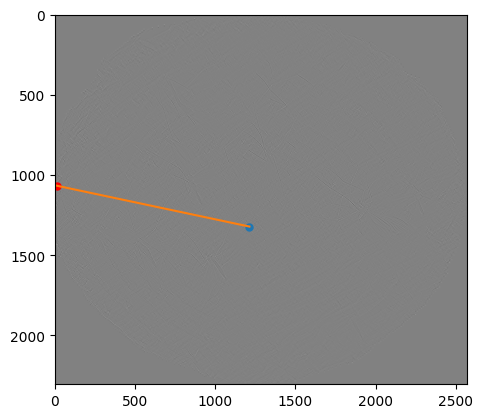

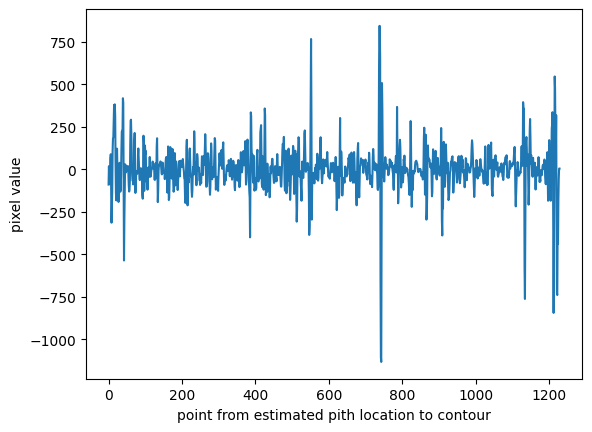

line length: 1228.6851420673552, point: [  11 1066]
inc count 238, dec count 240
peaks 184
good_count 147, bad_count 147


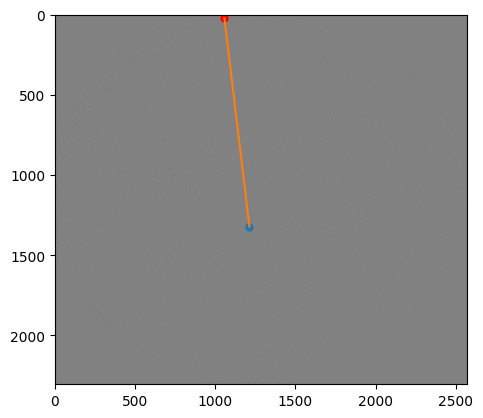

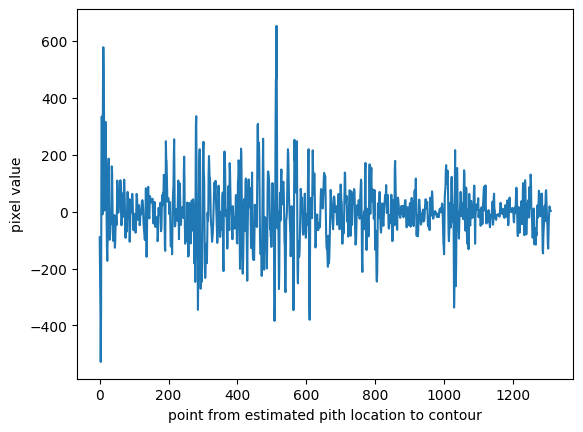

line length: 1309.2580059743393, point: [1057   21]
inc count 233, dec count 236
peaks 171
good_count 130, bad_count 130


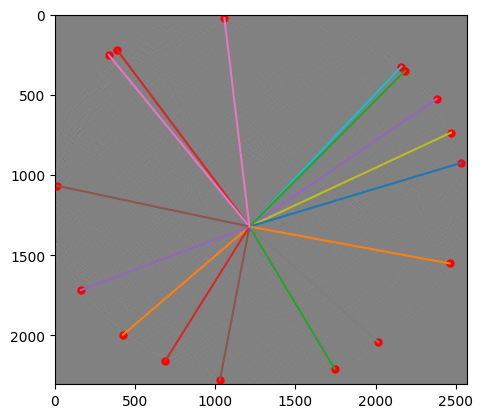

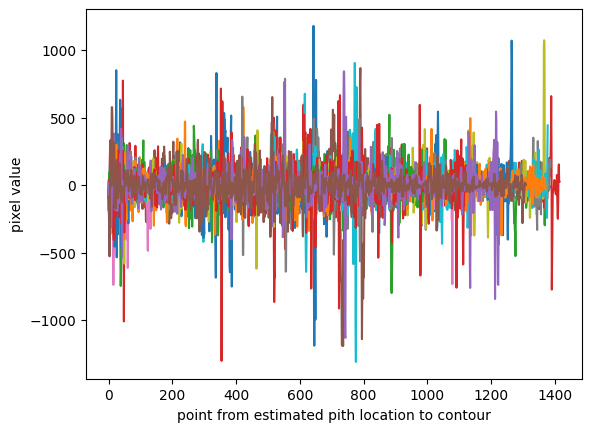

10 2-746ba8ac1301085b9f8d8d96beb3bf7f9e7a4605_ecc100d2cbc4a9fc70c2fde3eafaadb6ceb588ca_instant.jpg


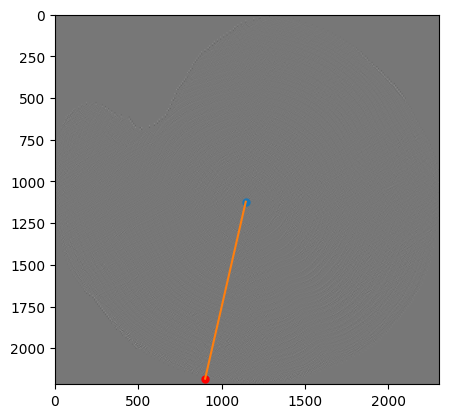

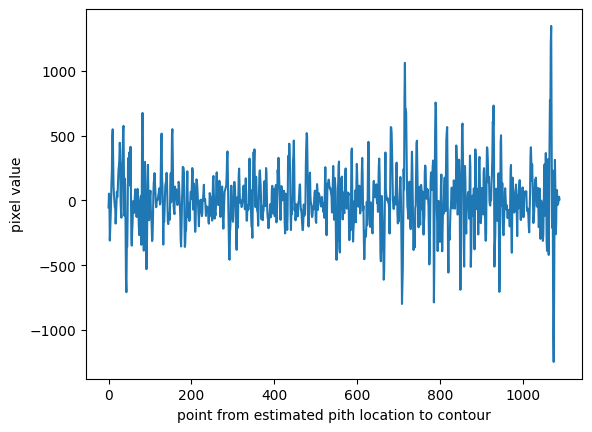

line length: 1089.239923303389, point: [ 901 2183]
inc count 207, dec count 208
peaks 166
good_count 131, bad_count 132


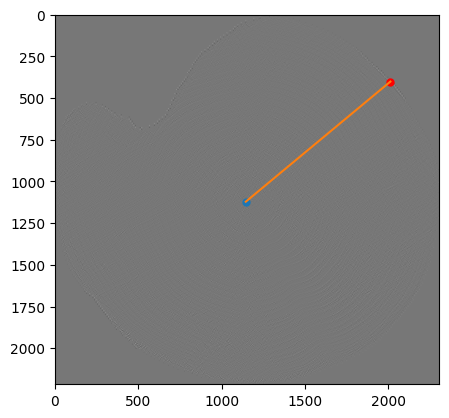

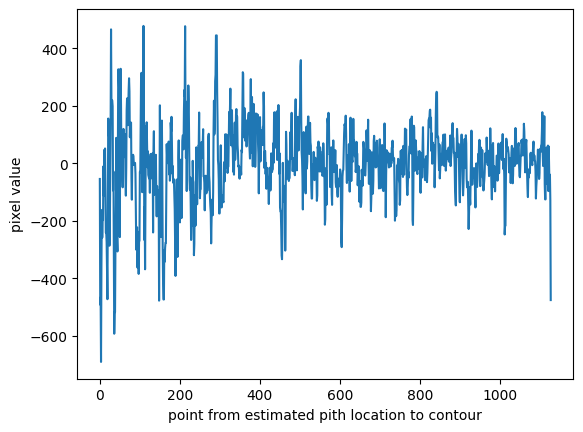

line length: 1127.4713770769333, point: [2012  401]
inc count 239, dec count 244
peaks 200
good_count 145, bad_count 146


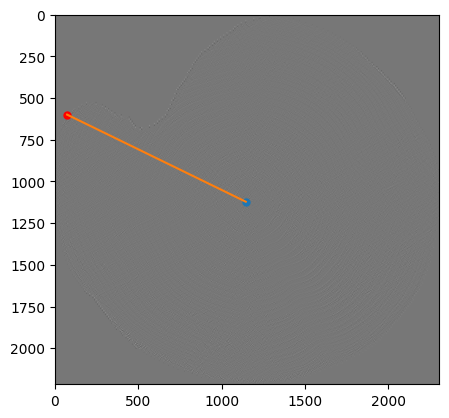

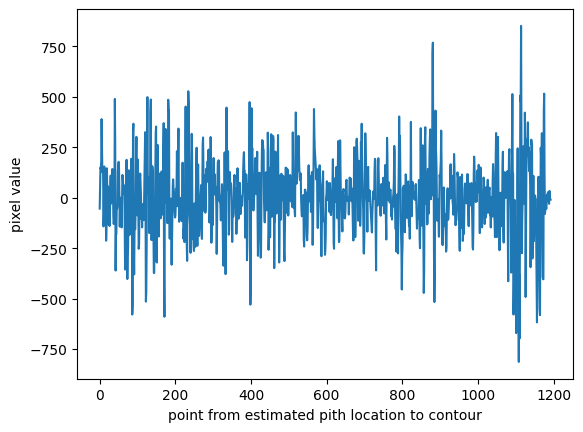

line length: 1192.1973177636316, point: [ 73 599]
inc count 237, dec count 221
peaks 210
good_count 179, bad_count 179


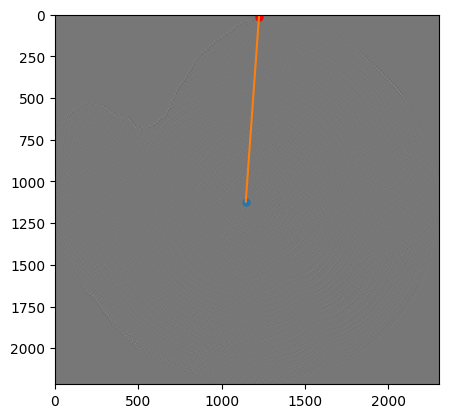

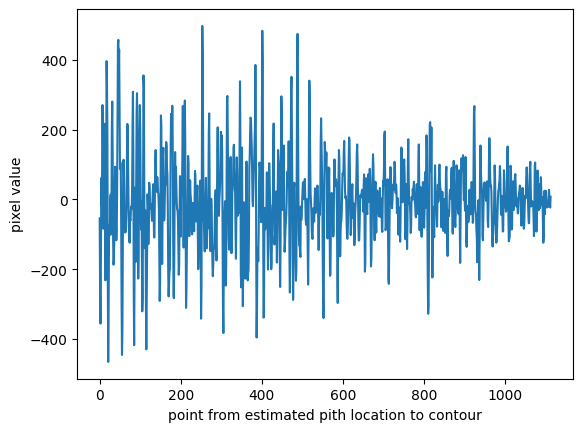

line length: 1113.1949173698529, point: [1224   11]
inc count 200, dec count 197
peaks 158
good_count 129, bad_count 130


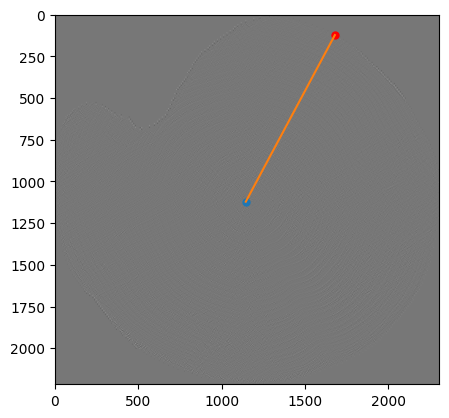

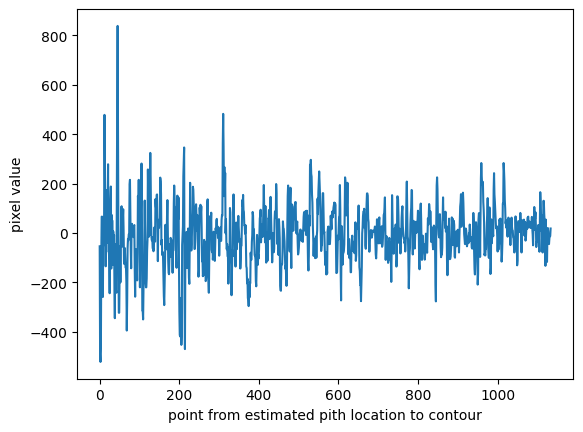

line length: 1133.2436560406497, point: [1679  122]
inc count 226, dec count 229
peaks 175
good_count 130, bad_count 131


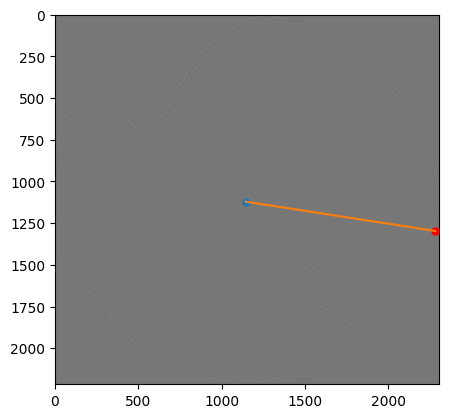

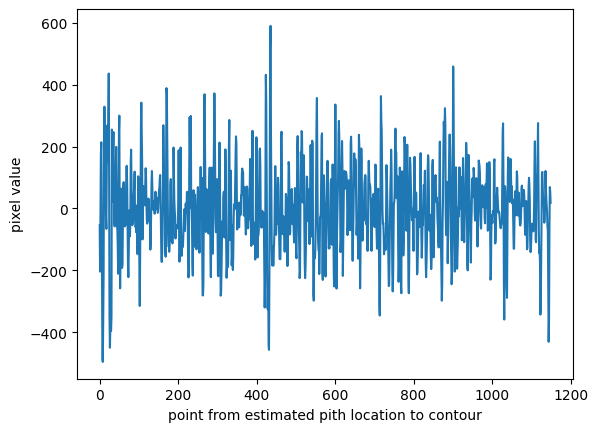

line length: 1149.8264539298727, point: [2281 1297]
inc count 202, dec count 203
peaks 167
good_count 130, bad_count 129


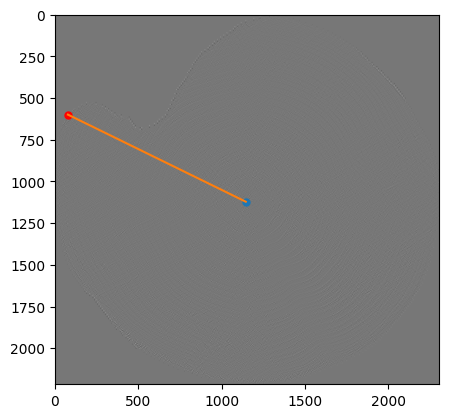

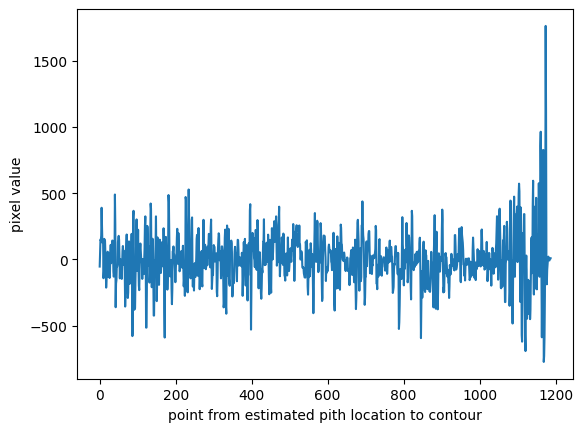

line length: 1187.704835368392, point: [ 78 599]
inc count 234, dec count 234
peaks 197
good_count 178, bad_count 178


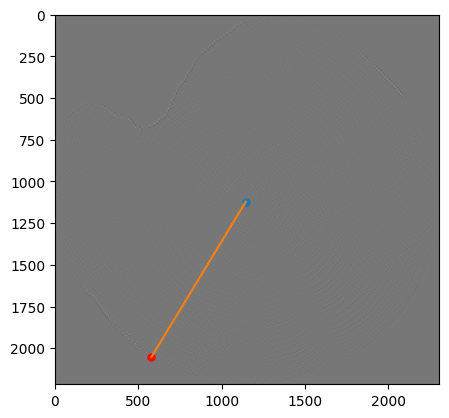

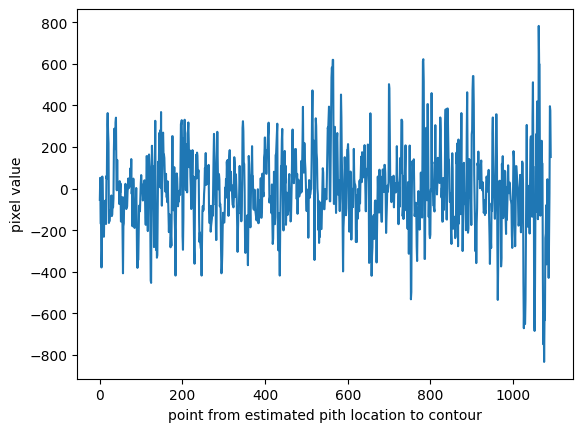

line length: 1091.2930042689245, point: [ 578 2054]
inc count 239, dec count 237
peaks 185
good_count 145, bad_count 145


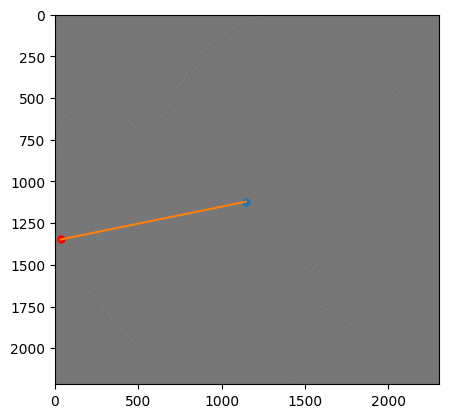

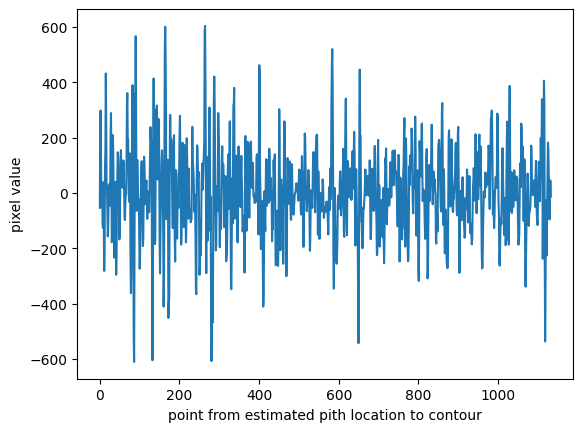

line length: 1132.5741492259044, point: [  35 1348]
inc count 217, dec count 214
peaks 180
good_count 131, bad_count 131


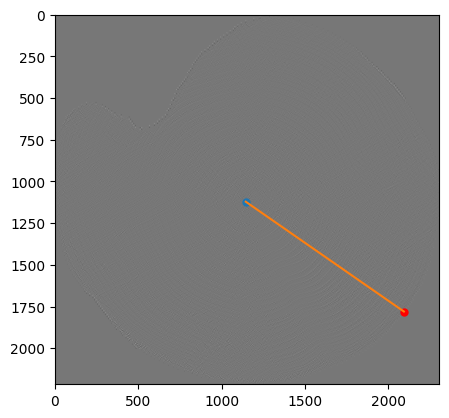

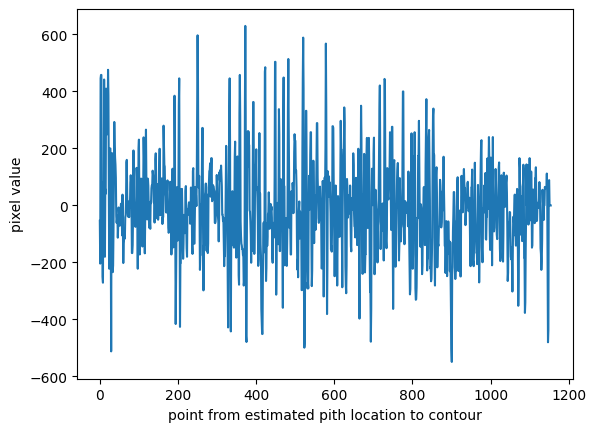

line length: 1154.615333213739, point: [2093 1780]
inc count 207, dec count 210
peaks 173
good_count 165, bad_count 164


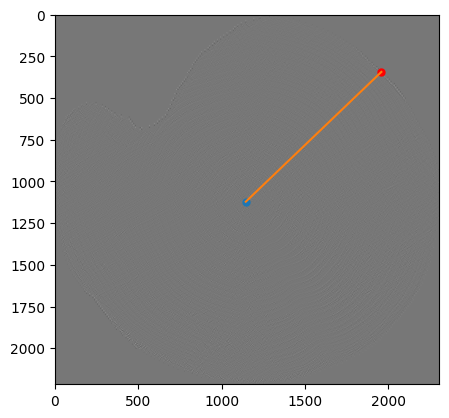

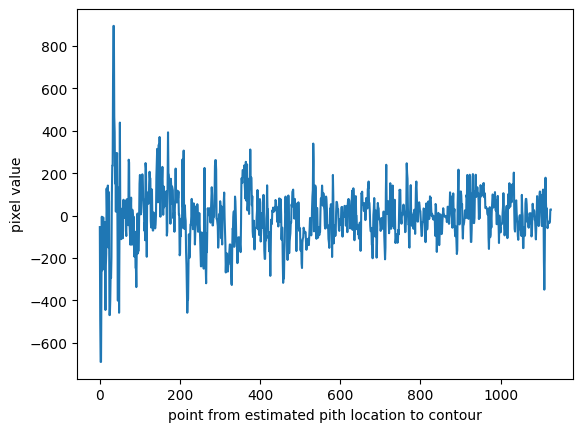

line length: 1125.771735529986, point: [1958  343]
inc count 235, dec count 233
peaks 185
good_count 143, bad_count 143


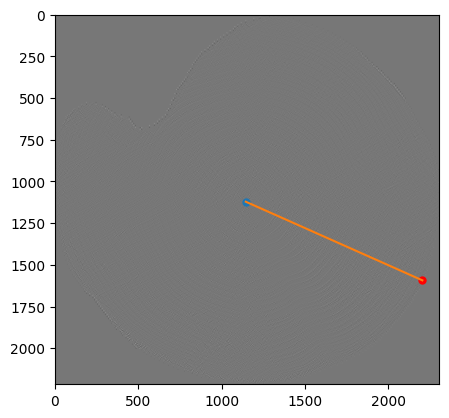

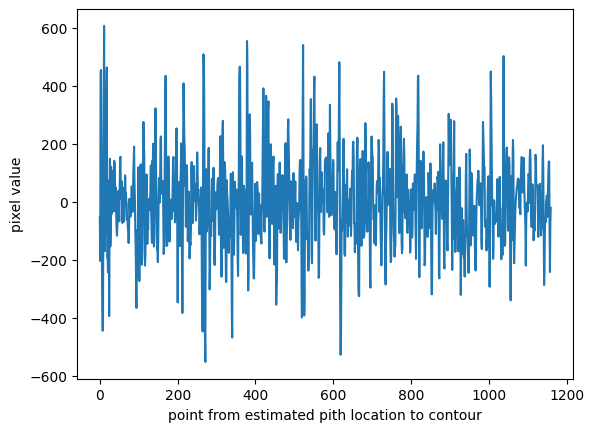

line length: 1159.5804519989247, point: [2204 1593]
inc count 214, dec count 202
peaks 178
good_count 154, bad_count 154


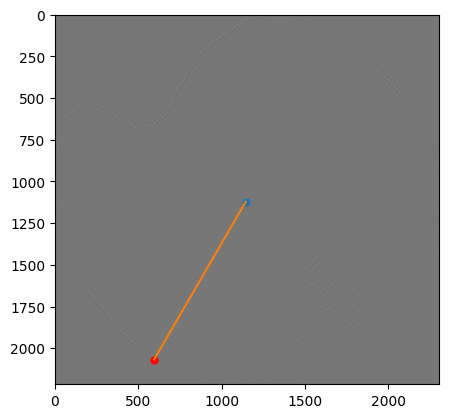

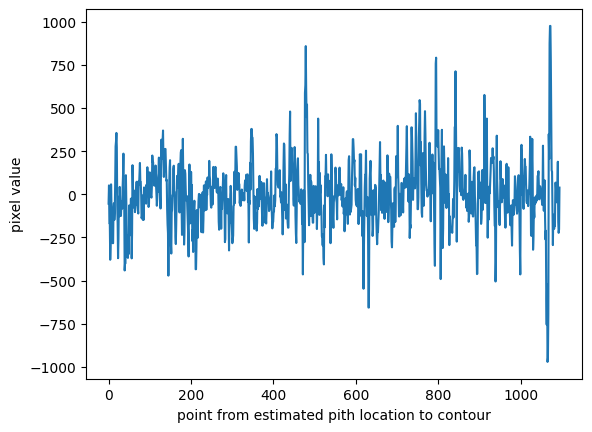

line length: 1094.6472235541062, point: [ 595 2068]
inc count 244, dec count 242
peaks 189
good_count 141, bad_count 142


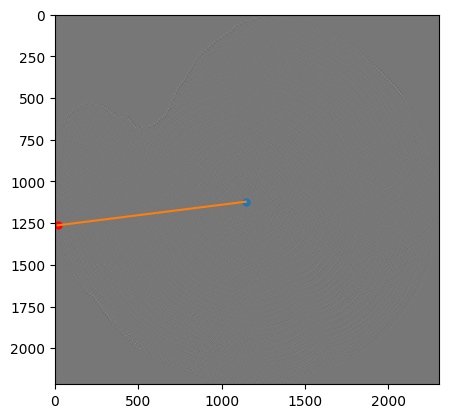

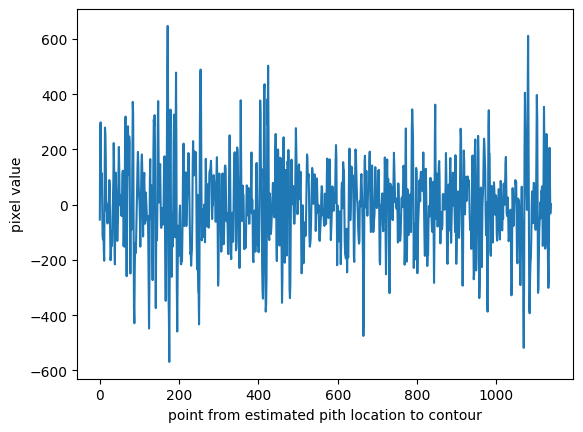

line length: 1137.5190097889295, point: [  16 1263]
inc count 209, dec count 210
peaks 171
good_count 136, bad_count 135


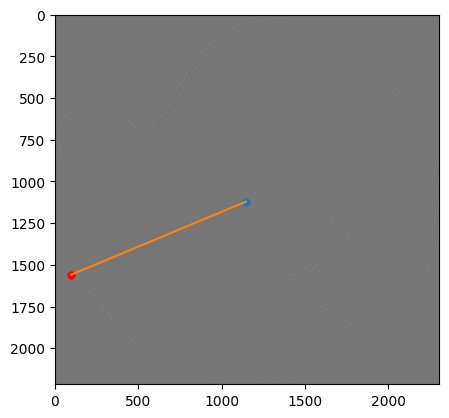

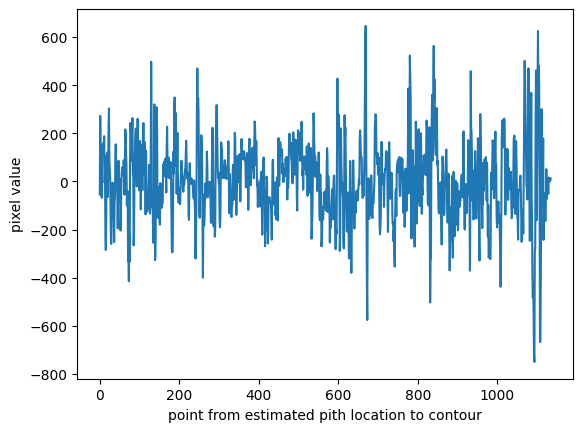

line length: 1134.4762619933995, point: [  98 1559]
inc count 247, dec count 240
peaks 187
good_count 147, bad_count 147


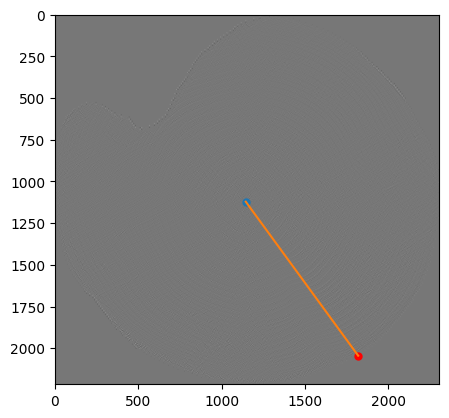

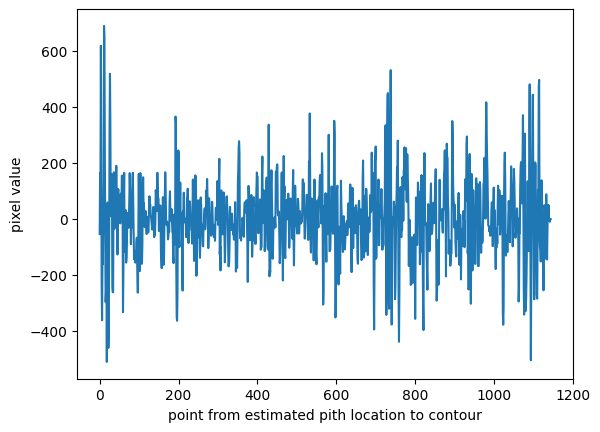

line length: 1143.6030137181074, point: [1819 2045]
inc count 224, dec count 222
peaks 188
good_count 178, bad_count 178


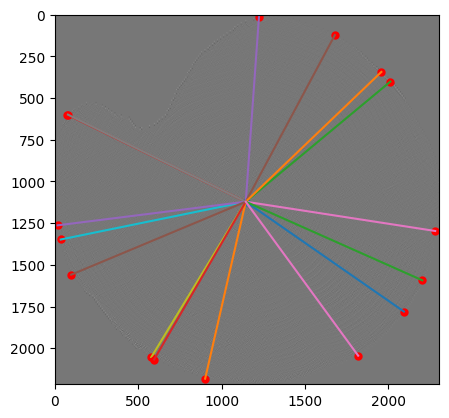

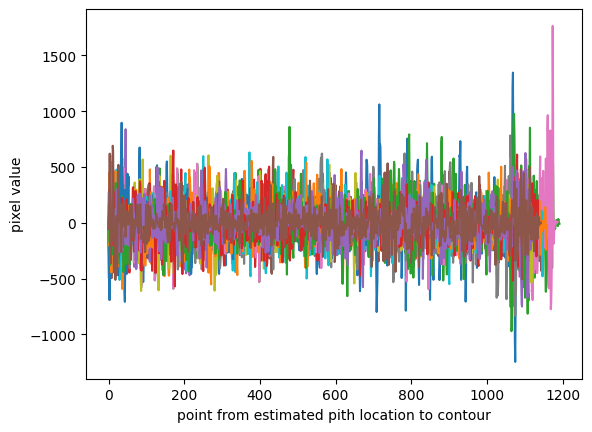

In [30]:
req_lines = 16
req_points = 150

result_arr = []

for image_index in range(len(images)):
    d = ringsranking_images_prediction_df.loc[ringsranking_images_prediction_df['image_index'] == image_index]
    p = d['prediction'].to_numpy()[0]     
    
    print("%s %s" % (image_index, str(d['image_name'].values[0]))) 
    radial_lines_info = funct_change_along_radial_line(images[image_index],grayscale_images[image_index],sobel_edge_images[image_index],req_lines,req_points,p)
    result_arr.append(radial_lines_info)

0 Ranking1: 81 Ranking2: 88 Ranking3: 92


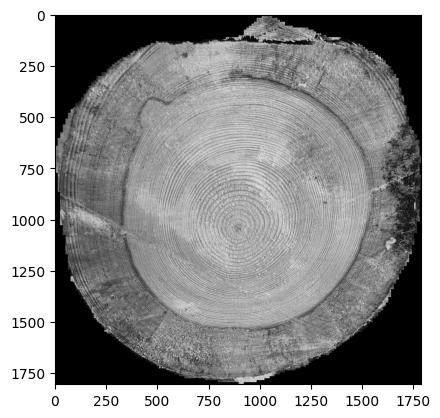

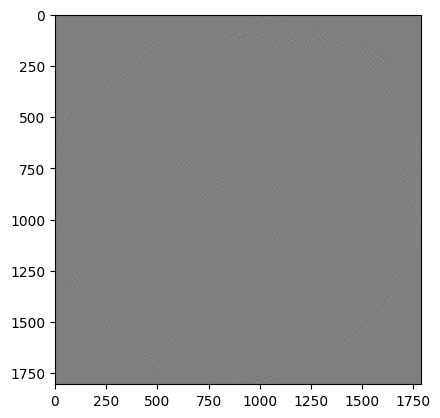

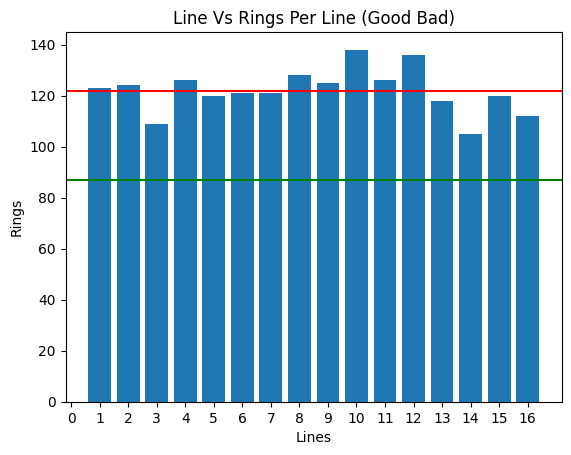

1 Ranking1: 59 Ranking2: 59 Ranking3: 61


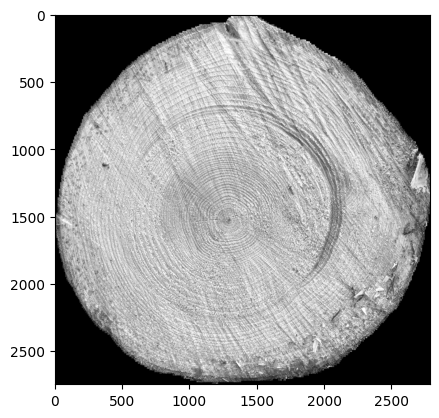

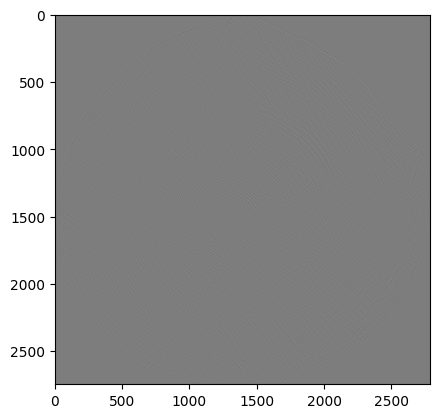

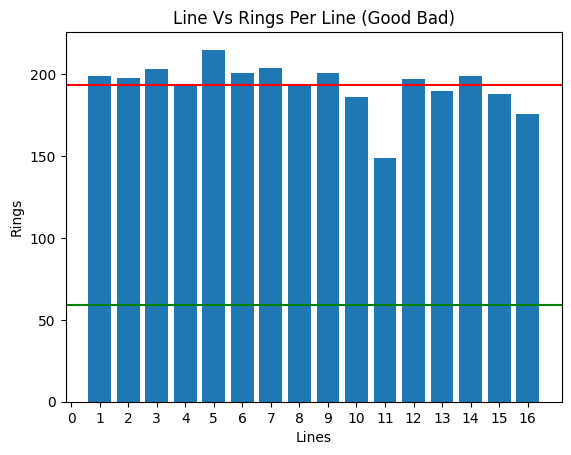

2 Ranking1: 18 Ranking2: 18 Ranking3: 18


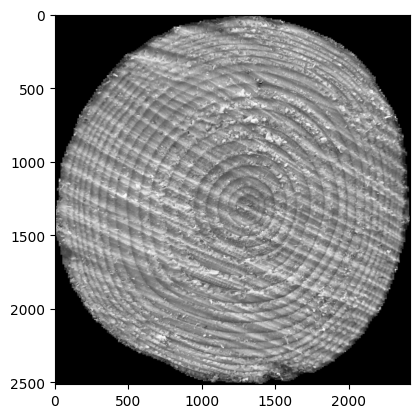

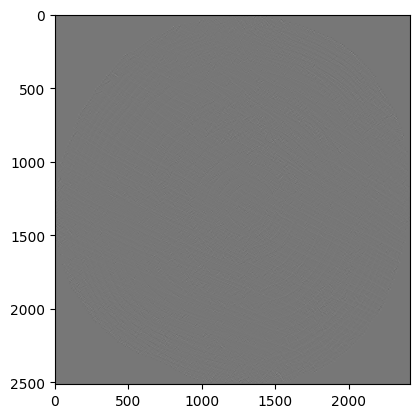

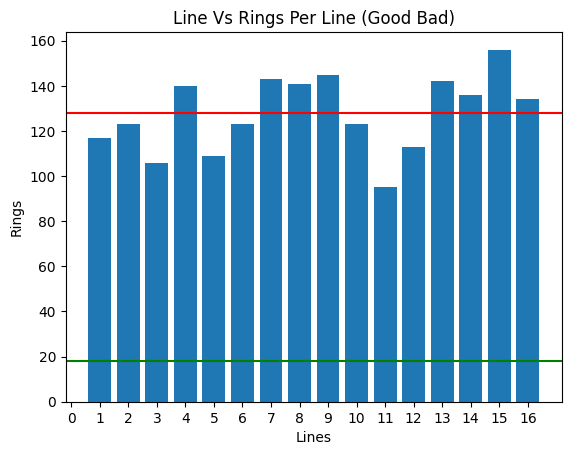

3 Ranking1: 22 Ranking2: 22 Ranking3: 22


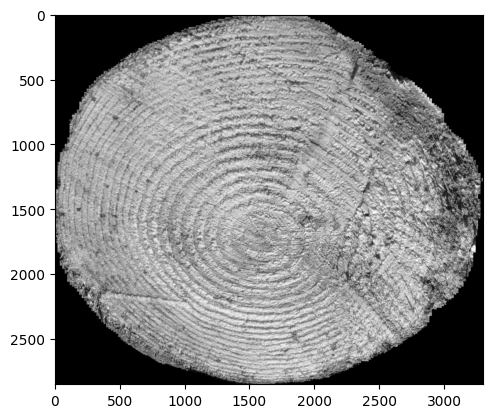

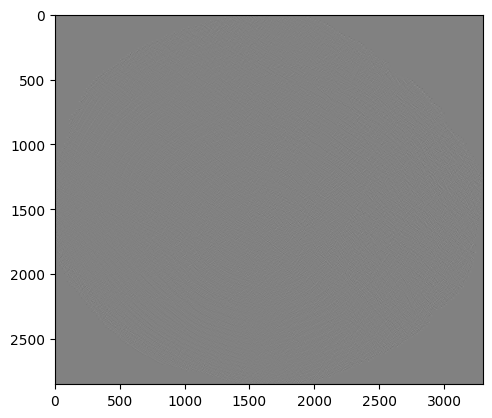

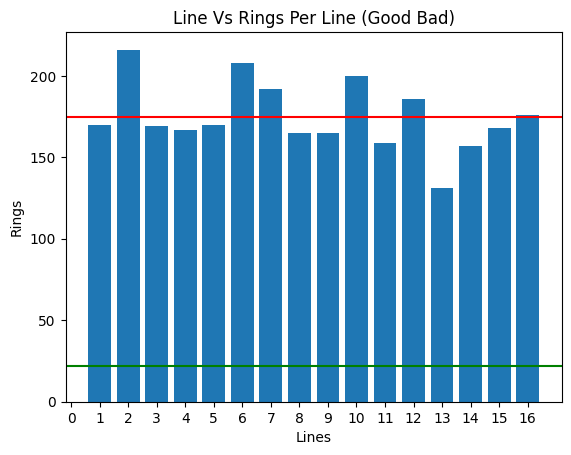

4 Ranking1: 15 Ranking2: 15 Ranking3: 15


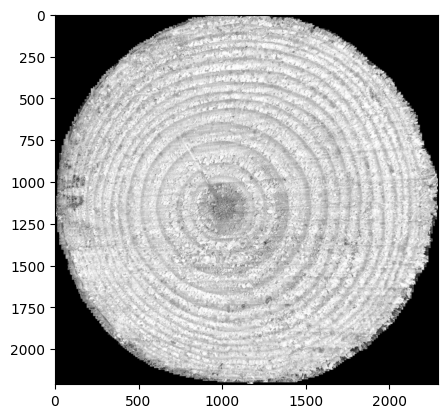

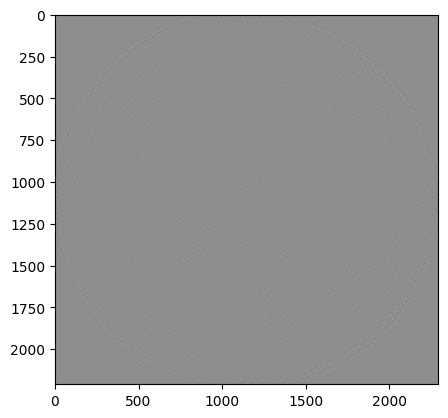

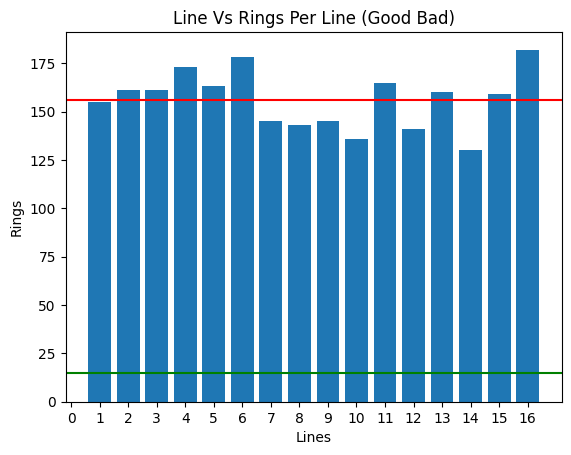

5 Ranking1: 19 Ranking2: 19 Ranking3: 19


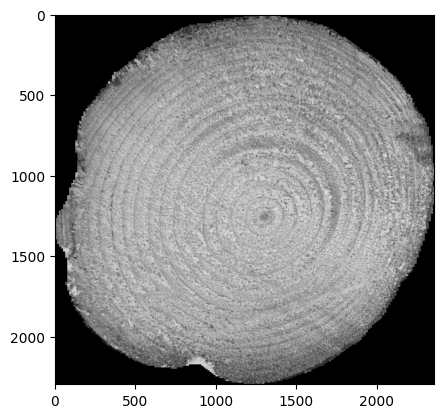

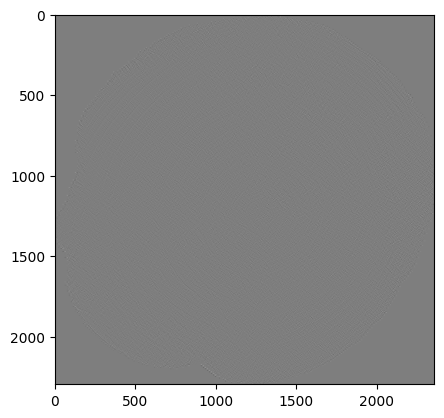

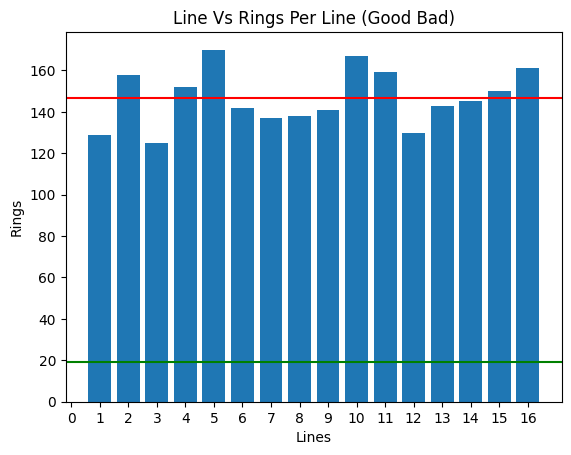

6 Ranking1: 14 Ranking2: 14 Ranking3: 14


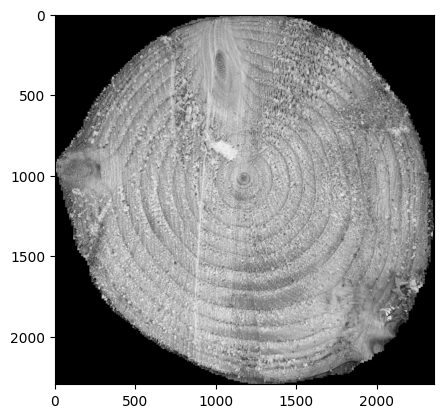

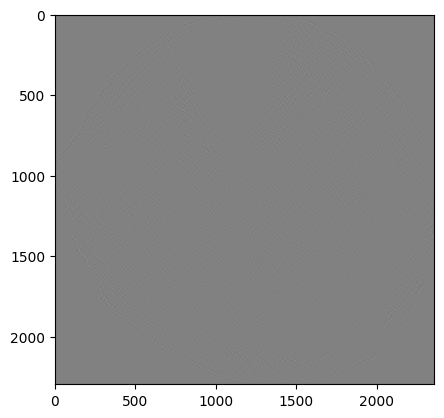

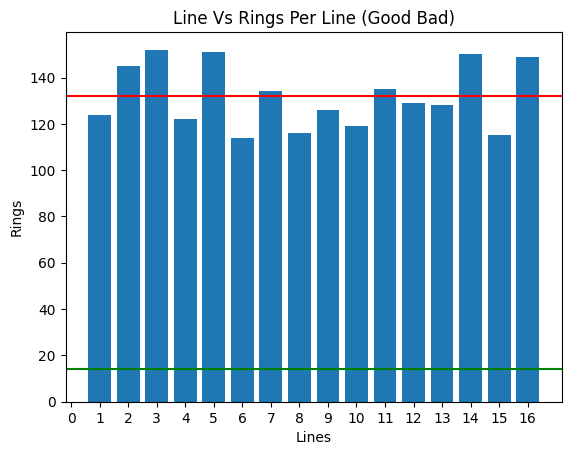

7 Ranking1: 16 Ranking2: 16 Ranking3: 16


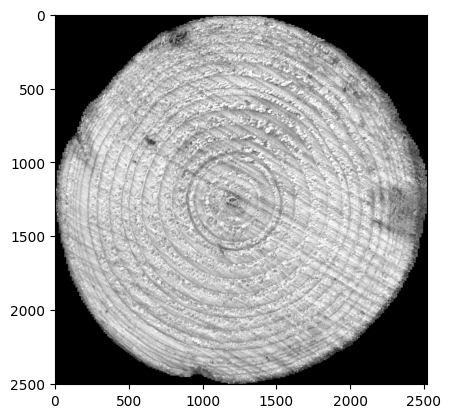

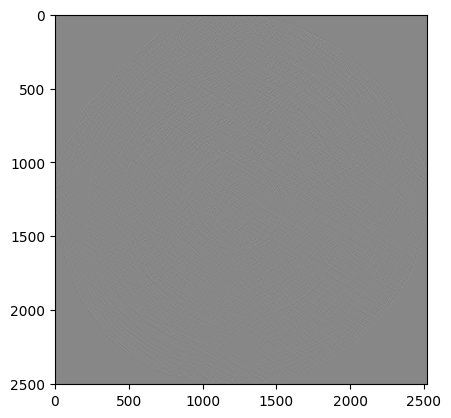

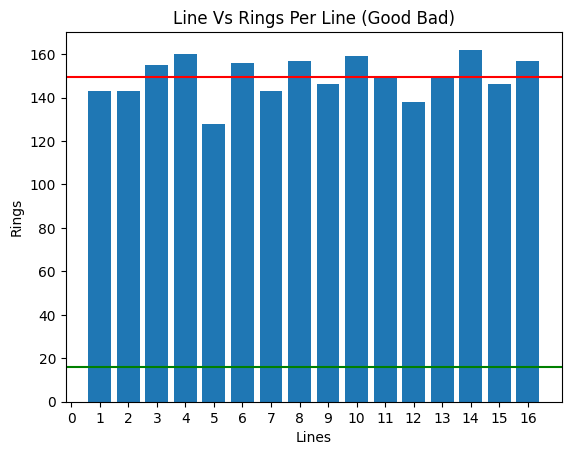

8 Ranking1: 17 Ranking2: 17 Ranking3: 17


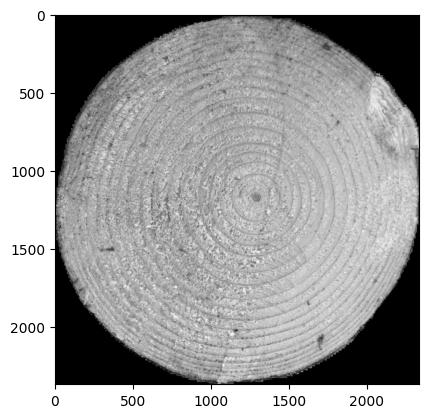

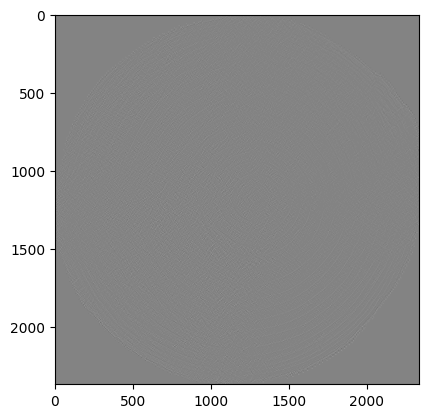

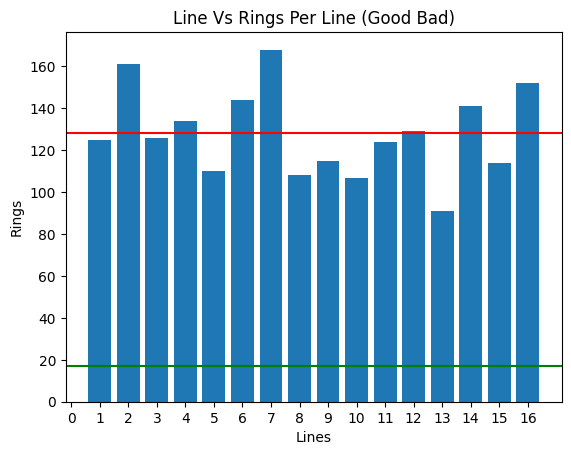

9 Ranking1: 11 Ranking2: 11 Ranking3: 11


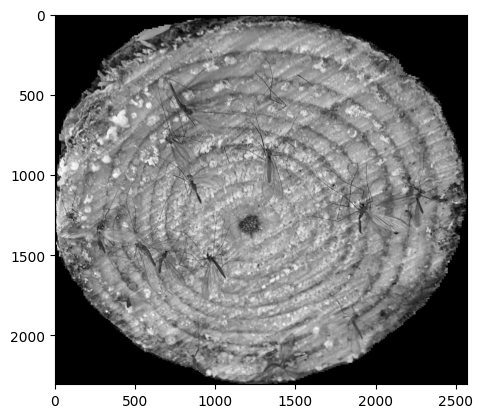

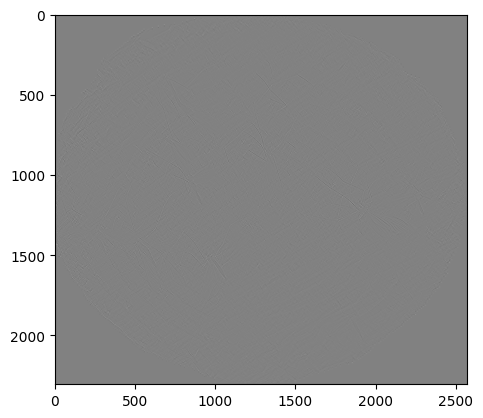

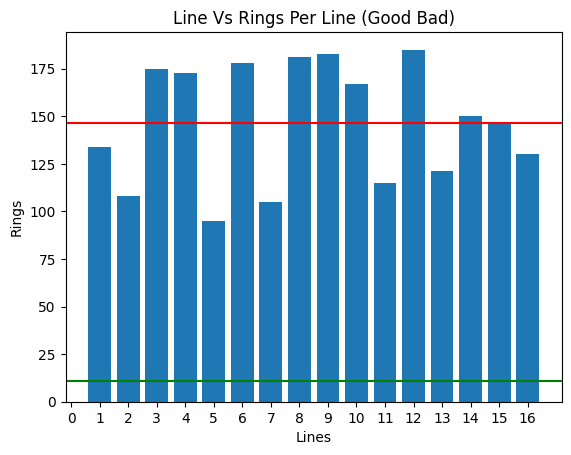

10 Ranking1: 27 Ranking2: 31 Ranking3: 29


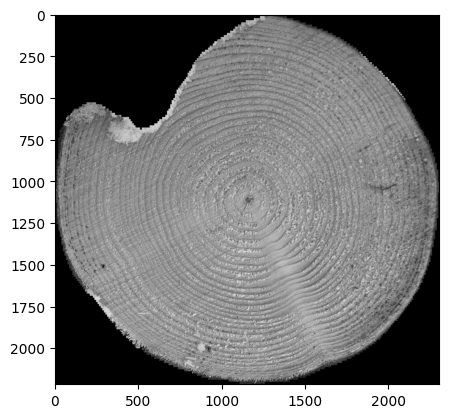

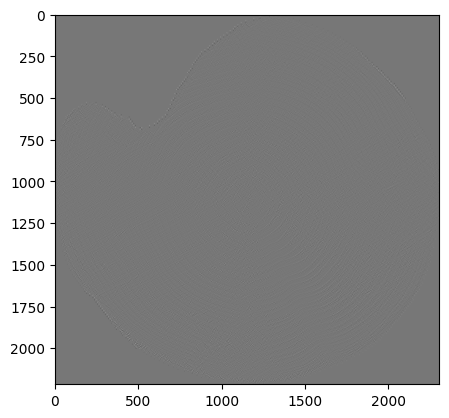

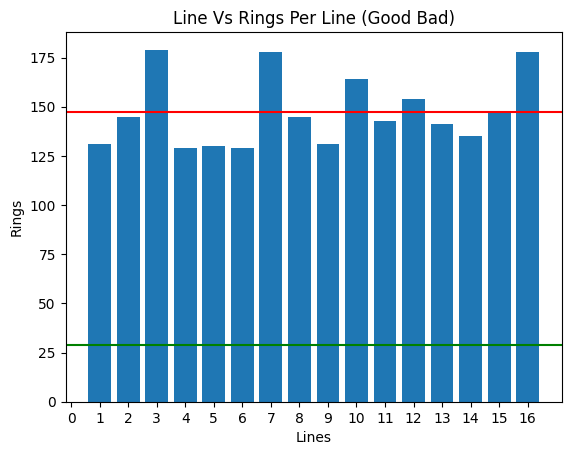

In [31]:
inc_dec_rank = []
peaks_rank = []
good_bad_rank = []

Y_inc_dec_pred = []
Y_peaks_pred = []
Y_good_bad_pred = []
Y_true = []

for image_index in range(len(images)):
    
    d = ringsranking_images_prediction_df.loc[ringsranking_images_prediction_df['image_index'] == image_index]
    
    radial_lines_info = result_arr[image_index]
    
    inc_dec_count = []
    peaks_count = []
    good_bad_count = []
    
    for radial_line_info in radial_lines_info:
        #print("line length: %s, point: %s" % (radial_line_info[0], radial_line_info[1]))
        #print("inc count %s, dec count %s" % (radial_line_info[2], radial_line_info[3]))
        #print("peaks %s" % (radial_line_info[4]))
        #print("good_count %s, bad_count %s" % (radial_line_info[5], radial_line_info[6]))
        
        inc_dec_count.append((radial_line_info[2] + radial_line_info[3])//4)
        peaks_count.append(radial_line_info[4])
        good_bad_count.append((radial_line_info[5] + radial_line_info[6])//2)

    print("%s Ranking1: %s Ranking2: %s Ranking3: %s" % (image_index, d['ranking_1'].to_numpy()[0], d['ranking_2'].to_numpy()[0], d['ranking_3'].to_numpy()[0]))
    
    ranking_mean = ((d['ranking_1'].to_numpy()[0] + d['ranking_2'].to_numpy()[0] + d['ranking_3'].to_numpy()[0]) // 3)
    inc_dec_mean = np.mean(inc_dec_count)
    peaks_mean = np.mean(peaks_count) 
    good_bad_mean = np.mean(good_bad_count) 
    
    inc_dec_rank.append([min(inc_dec_count), max(inc_dec_count), inc_dec_mean, ranking_mean])
    peaks_rank.append([min(peaks_count), max(peaks_count), peaks_mean, ranking_mean])
    good_bad_rank.append([min(good_bad_count), max(good_bad_count), good_bad_mean, ranking_mean])
    
    Y_inc_dec_pred.append(inc_dec_mean)
    Y_peaks_pred.append(peaks_mean)
    Y_good_bad_pred.append(good_bad_mean)
    Y_true.append(ranking_mean)
    
    plt.imshow(grayscale_images[image_index], cmap = 'gray')
    plt.show()
    
    plt.imshow(sobel_edge_images[image_index], cmap = 'gray')
    plt.show()
    
    """
    plt.bar(np.arange(start=1, stop=req_lines+1, step=1), inc_dec_count)
    plt.title('Line Vs Rings Per Line (Inc Dec)')
    plt.xlabel('Lines')
    plt.ylabel('Rings')
    plt.xticks(np.arange(0, req_lines+1, 1))
    plt.axhline(y=ranking_mean, color='g', linestyle='-')
    plt.axhline(y=inc_dec_mean, color='r', linestyle='-')
    plt.show()
    """
    
    """
    plt.bar(np.arange(start=1, stop=req_lines+1, step=1), peaks_count)
    plt.title('Line Vs Rings Per Line (peaks)')
    plt.xlabel('Lines')
    plt.ylabel('Rings')
    plt.xticks(np.arange(0, req_lines+1, 1))
    plt.axhline(y=ranking_mean, color='g', linestyle='-')
    plt.axhline(y=peaks_mean, color='r', linestyle='-')
    plt.show()
    """
    
    plt.bar(np.arange(start=1, stop=req_lines+1, step=1), good_bad_count)
    plt.title('Line Vs Rings Per Line (Good Bad)')
    plt.xlabel('Lines')
    plt.ylabel('Rings')
    plt.xticks(np.arange(0, req_lines+1, 1))
    plt.axhline(y=ranking_mean, color='g', linestyle='-')
    plt.axhline(y=good_bad_mean, color='r', linestyle='-')
    plt.show()
        

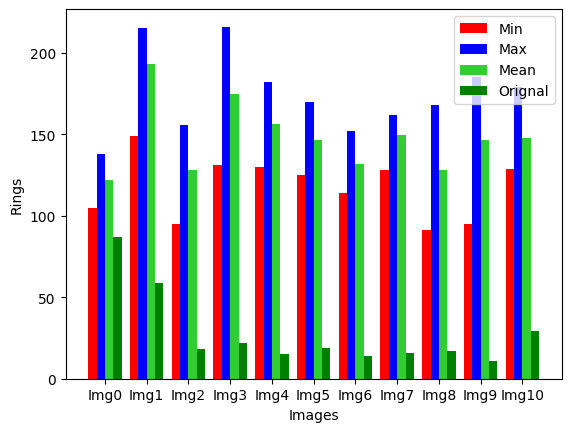

In [32]:
"""
# create data
inc_dec_rank = np.array(inc_dec_rank)

x = np.arange(start=1, stop=len(inc_dec_rank) + 1, step=1)
min_rings = inc_dec_rank[:, 0]
max_rings = inc_dec_rank[:, 1]
mean_rings = inc_dec_rank[:, 2]
orignal_rings = inc_dec_rank[:, 3]
width = 0.2

x_labels = []
for i in range(len(images)):
    x_labels.append("Img" + str(i))

# plot data in grouped manner of bar type
plt.bar(x-0.3, min_rings, width, color='red')
plt.bar(x-0.1, max_rings, width, color='blue')
plt.bar(x+0.1, mean_rings, width, color='limegreen')
plt.bar(x+0.3, orignal_rings, width, color='green')
plt.xticks(x, x_labels)
plt.xlabel("Images")
plt.ylabel("Rings")
plt.legend(["Min", "Max", "Mean", "Orignal"])
plt.show()
"""

"""
# create data
peaks_rank = np.array(peaks_rank)

x = np.arange(start=1, stop=len(peaks_rank) + 1, step=1)
min_rings = peaks_rank[:, 0]
max_rings = peaks_rank[:, 1]
mean_rings = peaks_rank[:, 2]
orignal_rings = peaks_rank[:, 3]
width = 0.2

x_labels = []
for i in range(len(images)):
    x_labels.append("Img" + str(i))

# plot data in grouped manner of bar type
plt.bar(x-0.3, min_rings, width, color='red')
plt.bar(x-0.1, max_rings, width, color='blue')
plt.bar(x+0.1, mean_rings, width, color='limegreen')
plt.bar(x+0.3, orignal_rings, width, color='green')
plt.xticks(x, x_labels)
plt.xlabel("Images")
plt.ylabel("Rings")
plt.legend(["Min", "Max", "Mean", "Orignal"])
plt.show()
"""

# create data
good_bad_rank = np.array(good_bad_rank)

x = np.arange(start=1, stop=len(good_bad_rank) + 1, step=1)
min_rings = good_bad_rank[:, 0]
max_rings = good_bad_rank[:, 1]
mean_rings = good_bad_rank[:, 2]
orignal_rings = good_bad_rank[:, 3]
width = 0.2

x_labels = []
for i in range(len(images)):
    x_labels.append("Img" + str(i))

# plot data in grouped manner of bar type
plt.bar(x-0.3, min_rings, width, color='red')
plt.bar(x-0.1, max_rings, width, color='blue')
plt.bar(x+0.1, mean_rings, width, color='limegreen')
plt.bar(x+0.3, orignal_rings, width, color='green')
plt.xticks(x, x_labels)
plt.xlabel("Images")
plt.ylabel("Rings")
plt.legend(["Min", "Max", "Mean", "Orignal"])
plt.show()

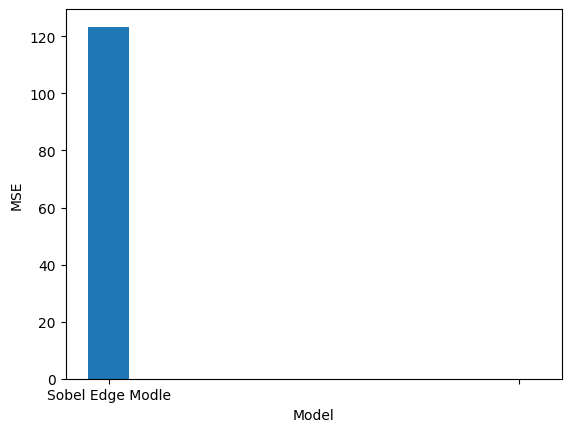

In [33]:
"""
# Y_true = Y (original values) # Given values
# Y_pred = Y' # Calculated values
mse_inc_dec = mean_squared_error(Y_true, Y_inc_dec_pred, squared=False)
mse_peaks = mean_squared_error(Y_true, Y_peaks_pred, squared=False)
mse_good_bad = mean_squared_error(Y_true, Y_good_bad_pred, squared=False)

x = np.array(["Inc Dec", "Peaks", "Good Bad"])
y = np.array([mse_inc_dec, mse_peaks, mse_good_bad])

plt.bar(x, y, width = 0.1)
plt.xlabel("Model")
plt.ylabel("MSE")
#plt.grid(axis='y')
plt.show()
"""

# Y_true = Y (original values) # Given values
# Y_pred = Y' # Calculated values
mse_inc_dec = mean_squared_error(Y_true, Y_inc_dec_pred, squared=False)
mse_peaks = mean_squared_error(Y_true, Y_peaks_pred, squared=False)
mse_good_bad = mean_squared_error(Y_true, Y_good_bad_pred, squared=False)

x = np.array(["Sobel Edge Modle", "", ""])
y = np.array([mse_good_bad, 0, 0])

plt.bar(x, y, width = 0.1)
plt.xlabel("Model")
plt.ylabel("MSE")
#plt.grid(axis='y')
plt.show()